# _____________________CREDIT EDA ASSIGMENT____________________________________

### import block:

In [1]:
#import libraries
#for analysis
import pandas as pd, numpy as np
#for visualization
import matplotlib.pyplot as plt, seaborn as sns 
#for warnings
import warnings
warnings.filterwarnings('ignore')

### Reading the data

In [2]:
# reading both the dta files
df1= pd.read_csv('application_data.csv')
df2= pd.read_csv('previous_application.csv')

### Understanding the data

In [3]:
#checking the head of the data for the sample observations
df1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [4]:
#understanding the dimensions of the data frame 1
df1.shape

(307511, 122)

In [5]:
# understanding the deviations in the data frame 1
df1.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [6]:
# understanding the information of the dataframe 1
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


# Data Cleaning

we have handle the null values because while calculating and plotting, if there are null values in there could be lot of deviations occur

In [7]:
# extracting the columns with null values
a_n= df1.isnull().sum()
df1_nulls={k:round(v,3) for (k,v) in zip((a_n.index),list(np.array(list(a_n.values))*100/307511)) if v>0}

In [8]:
#extracting columns with null values greater than or equal to 40%
df40_nulls={k:v for (k,v) in df1_nulls.items() if v>=40}

In [9]:
# drop the columns
for i in list(df40_nulls.keys()):
    df1.drop(i, axis=1, inplace=True)
df1.shape

(307511, 73)

In [10]:
#extracting columns with null values less than or equal to 5%
df5_nulls={k:v for (k,v) in df1_nulls.items() if v<5}

In [11]:
#dropping the null value records which are less than 5% in a column 
for i in (df5_nulls.keys()):
    df1.dropna(subset=i , inplace=True)
df1.shape

(304531, 73)

In [12]:
#finding the dtypes of the columns whose null values are around 5-40%
#extracting columns with null values
df5to40_nulls={k:v for (k,v) in df1_nulls.items() if v>=5 and v<40}
df5to40_nulls

{'OCCUPATION_TYPE': 31.346,
 'EXT_SOURCE_3': 19.825,
 'AMT_REQ_CREDIT_BUREAU_HOUR': 13.502,
 'AMT_REQ_CREDIT_BUREAU_DAY': 13.502,
 'AMT_REQ_CREDIT_BUREAU_WEEK': 13.502,
 'AMT_REQ_CREDIT_BUREAU_MON': 13.502,
 'AMT_REQ_CREDIT_BUREAU_QRT': 13.502,
 'AMT_REQ_CREDIT_BUREAU_YEAR': 13.502}

In [13]:
#seperating the columns according to the dtypes
df_ints={k:str(v) for (k,v) in (df1.dtypes.to_dict().items()) if v=='int64'}
df_floats={k:str(v) for (k,v) in (df1.dtypes.to_dict().items()) if v=='float64'}
df_objects={k:str(v) for (k,v) in (df1.dtypes.to_dict().items()) if v=='object'}

In [14]:
#extracting the list of columns of ecah datatype in between the 5to40%
int_cols=[x for x in list(df5to40_nulls.keys()) if x in list(df_ints.keys())]
float_cols=[x for x in list(df5to40_nulls.keys()) if x in list(df_floats.keys())]
object_cols=[x for x in list(df5to40_nulls.keys()) if x in list(df_objects.keys())]

In [15]:
# replacing null values in the object type columns with the mode of the column.
df1[object_cols[0]]=df1[object_cols[0]].fillna(df1[object_cols[0]].mode()[0])

In [16]:
# there are no int type data type columns in between 4-50 null percentage
# replacing the null values in the float type data columns with the mean of the column.
for i in range(len(float_cols)):
    df1[float_cols[i]]=df1[float_cols[i]].fillna(df1[float_cols[i]].mean())

# Standeardizing the columns 

In [17]:
#finding for the unique values of ecah column to know if there any corrections and standerdizations need to be done.
for i in df1.columns:
    print(df1[i].unique())
    print(i)
    print('\n')

[100002 100003 100004 ... 456253 456254 456255]
SK_ID_CURR


[1 0]
TARGET


['Cash loans' 'Revolving loans']
NAME_CONTRACT_TYPE


['M' 'F' 'XNA']
CODE_GENDER


['N' 'Y']
FLAG_OWN_CAR


['Y' 'N']
FLAG_OWN_REALTY


[ 0  1  2  3  4  7  5  6  8  9 11 12 10 19 14]
CNT_CHILDREN


[202500.  270000.   67500.  ...  96768.  546250.5 113062.5]
AMT_INCOME_TOTAL


[ 406597.5 1293502.5  135000.  ...  181989.   743863.5 1391130. ]
AMT_CREDIT


[24700.5 35698.5  6750.  ... 71986.5 58770.  77809.5]
AMT_ANNUITY


[ 351000.  1129500.   135000.   297000.   513000.   454500.  1395000.
 1530000.   913500.   405000.   652500.    67500.   697500.   679500.
  247500.   387000.   270000.   157500.   427500.   927000.   450000.
  225000.   702000.   675000.   180000.   477000.   360000.  1125000.
  553500.   540000.   855000.   238500.   598500.   252000.  1350000.
  666000.   202500.   517500.  1588500.  1080000.   810000.    90000.
  900000.  1035000.   463500.   459000.   256500.   585000.   643500.
  283500.

['Laborers' 'Core staff' 'Accountants' 'Managers' 'Drivers' 'Sales staff'
 'Cleaning staff' 'Cooking staff' 'Private service staff' 'Medicine staff'
 'Security staff' 'High skill tech staff' 'Waiters/barmen staff'
 'Low-skill Laborers' 'Realty agents' 'Secretaries' 'IT staff' 'HR staff']
OCCUPATION_TYPE


[ 1.  2.  3.  4.  5.  6.  9.  7.  8. 10. 13. 14. 12. 20. 15. 16. 11.]
CNT_FAM_MEMBERS


[2 1 3]
REGION_RATING_CLIENT


[2 1 3]
REGION_RATING_CLIENT_W_CITY


['WEDNESDAY' 'MONDAY' 'THURSDAY' 'SUNDAY' 'SATURDAY' 'FRIDAY' 'TUESDAY']
WEEKDAY_APPR_PROCESS_START


[10 11  9 17 16 14  8 15  7 13  6 12 19  3 18 21  4  5 20 22  1  2 23  0]
HOUR_APPR_PROCESS_START


[0 1]
REG_REGION_NOT_LIVE_REGION


[0 1]
REG_REGION_NOT_WORK_REGION


[0 1]
LIVE_REGION_NOT_WORK_REGION


[0 1]
REG_CITY_NOT_LIVE_CITY


[0 1]
REG_CITY_NOT_WORK_CITY


[0 1]
LIVE_CITY_NOT_WORK_CITY


['Business Entity Type 3' 'School' 'Government' 'Religion' 'Other' 'XNA'
 'Electricity' 'Medicine' 'Business Entity Type 2' 'Self-empl

In [18]:
# correcting the XNA
df1=df1.replace('XNA', np.NaN)

In [19]:
#checking the null values after all cleaning process
#this pertricluar code will cxhcek for the null vales and stores the columns with null percentage in the form of dictionary
nullcheck={k:v for (k,v) in (df1.isnull().mean().to_dict()).items() if v>0}
nullcheck

{'CODE_GENDER': 1.3134951778308283e-05,
 'ORGANIZATION_TYPE': 0.1801195937359415}

In [20]:
#replacing the null values with the mode of the column
# choosing mode because it works irrespective of the data type of the column.
for i in list(nullcheck.keys()):
    df1[i].fillna(df1[i].mode()[0],inplace=True)

In [21]:
#listing the columns with flag word
flags=[x for x in df1.columns if 'FLAG' in x]

In [22]:
#dropping flag columns since they are not required for analysis
for i in flags:
    df1.drop(i,axis=1,inplace=True)

In [23]:
# extracting the numerical columns and storing them in a sequential data
numcols=list({k:str(v) for (k,v) in (df1.dtypes.to_dict().items()) if v=='int64'or v=='float64'}.keys())

In [24]:
# standerdizing all numerical columns by using absolute value function to remove negetives from the data 
for i in numcols:
    df1[i]=abs(df1[i])

In [25]:
# checking the null values to ensure that the data is clean from the nulls.
nullcheck={k:v for (k,v) in (df1.isnull().mean().to_dict()).items() if v>0}
nullcheck

{}

# Handling the outliers

In [27]:
#finding outliers in each required columns
# i choose these columns upon understand the column description read from the column description file given.
amtcols = [x for x in list(df1.columns) if 'AMT' in x]
for i in amtcols:
    sns.boxplot(df1[i])
    plt.xlabel(i)
    plt.show()

['AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_YEAR']

In [29]:
# replacing the outliers
for i in amtcols:
    p95 = df1[i].median()
    df1.loc[df1[i] == df1[i].max(), i] = p95

In [31]:
#converting days to years and dropping the days columns by adding the years columns
days=['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH']
years=['YEARS_BIRTH','YEARS_EMPLOYED','YEARS_REGISTRATION','YEARS_ID_PUBLISH']
for i,j in zip(days,years):
    df1[j]=round(df1[i]/365,2)

In [33]:
# replacing the outlier with median because in this column even after replacing with 95th percentile the vlaue is aroun 1000 experiance of a person being 1000 is practically impossible.
# replacing only with median becaus ethe mean is effected by the outlier and median is better compared to mode.
df1.loc[df1['YEARS_EMPLOYED'] == df1['YEARS_EMPLOYED'].max(),'YEARS_EMPLOYED'] =df1['YEARS_EMPLOYED'].median()

# UNIVARIATE ANALYSIS

## binning

Binning is required for certain columns because for vast data plotting for each value takes more time and the polt looks unprofessional and to meke is sesible and esier for understanding we hve to bin those kind of columns.

In [34]:
#binning in loop doe numerical columns
bincols=['AMT_ANNUITY','AMT_GOODS_PRICE','REGION_POPULATION_RELATIVE','YEARS_REGISTRATION','YEARS_BIRTH','AMT_CREDIT','AMT_INCOME_TOTAL','YEARS_EMPLOYED','YEARS_ID_PUBLISH']
for i in bincols:
    # calculate bin size using min and upper fence values of the column
    min_value = df1[i].min()
    q3_value = df1[i].quantile(0.75)
    iqr_value = q3_value - df1[i].quantile(0.25)
    upper_fence = q3_value + 1.5*iqr_value
    bin_size = (upper_fence - min_value) / 50
    # create bins using np.linspace()
    bins = np.linspace(min_value, upper_fence + bin_size, 21)
    # create labels for the bins
    labels = [f"{round(bins[i],2)}-{round(bins[i+1],2)}" for i in range(len(bins)-1)]
    # add the binned data to the DataFrame as a new column
    df1[i+'_RANGE'] = pd.cut(df1[i], bins=bins, labels=labels, include_lowest=True, ordered=False)
df1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,...,YEARS_ID_PUBLISH,AMT_ANNUITY_RANGE,AMT_GOODS_PRICE_RANGE,REGION_POPULATION_RELATIVE_RANGE,YEARS_REGISTRATION_RANGE,YEARS_BIRTH_RANGE,AMT_CREDIT_RANGE,AMT_INCOME_TOTAL_RANGE,YEARS_EMPLOYED_RANGE,YEARS_ID_PUBLISH_RANGE
0,100002,1,Cash loans,M,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,...,5.81,23080.75-26147.21,305802.0-372127.5,0.02-0.02,8.76-10.95,23.75-26.97,365611.5-445764.38,200597.85-216502.2,1.54-2.31,5.7-6.85
1,100003,0,Cash loans,F,0,270000.0,1293502.5,35698.5,1129500.0,Family,...,0.80,35346.61-38413.07,1101708.0-1168033.5,0.0-0.01,2.19-4.38,43.1-46.33,1247293.12-1327446.0,264215.25-280119.6,3.08-3.85,0.0-1.14
2,100004,0,Revolving loans,M,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,...,6.93,4681.96-7748.43,106825.5-173151.0,0.01-0.01,10.95-13.15,49.55-52.78,125152.88-205305.75,57458.7-73363.05,0.0-0.77,6.85-7.99
3,100006,0,Cash loans,F,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,...,6.68,29213.68-32280.14,239476.5-305802.0,0.01-0.01,26.29-28.48,49.55-52.78,285458.62-365611.5,121076.1-136980.45,7.69-8.46,5.7-6.85
4,100007,0,Cash loans,M,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,...,9.47,20014.29-23080.75,504778.5-571104.0,0.03-0.03,10.95-13.15,52.78-56.0,445764.38-525917.25,121076.1-136980.45,7.69-8.46,9.13-10.27


In [35]:
#binning the categories of the same diffrent kinds to make the plot look sophesticated.
np.sort(df1['ORGANIZATION_TYPE'].unique())

array(['Advertising', 'Agriculture', 'Bank', 'Business Entity Type 1',
       'Business Entity Type 2', 'Business Entity Type 3', 'Cleaning',
       'Construction', 'Culture', 'Electricity', 'Emergency',
       'Government', 'Hotel', 'Housing', 'Industry: type 1',
       'Industry: type 10', 'Industry: type 11', 'Industry: type 12',
       'Industry: type 13', 'Industry: type 2', 'Industry: type 3',
       'Industry: type 4', 'Industry: type 5', 'Industry: type 6',
       'Industry: type 7', 'Industry: type 8', 'Industry: type 9',
       'Insurance', 'Kindergarten', 'Legal Services', 'Medicine',
       'Military', 'Mobile', 'Other', 'Police', 'Postal', 'Realtor',
       'Religion', 'Restaurant', 'School', 'Security',
       'Security Ministries', 'Self-employed', 'Services', 'Telecom',
       'Trade: type 1', 'Trade: type 2', 'Trade: type 3', 'Trade: type 4',
       'Trade: type 5', 'Trade: type 6', 'Trade: type 7',
       'Transport: type 1', 'Transport: type 2', 'Transport: type 3',


In [36]:
repl=[['Business Entity Type 1','Business Entity Type 2', 'Business Entity Type 3'], ['Industry: type 1','Industry: type 10', 'Industry: type 11', 'Industry: type 12','Industry: type 13', 'Industry: type 2', 'Industry: type 3','Industry: type 4', 'Industry: type 5', 'Industry: type 6','Industry: type 7', 'Industry: type 8', 'Industry: type 9'],['Trade: type 1', 'Trade: type 2', 'Trade: type 3','Trade: type 4', 'Trade: type 5', 'Trade: type 6', 'Trade: type 7'],['Transport: type 1', 'Transport: type 2','Transport: type 3', 'Transport: type 4']]
m_strs=['Business Entity','Industry','Trade','Transport']
for i,j in zip(repl,m_strs):
    df1['ORGANIZATION_TYPE'].replace(i,j,inplace=True)

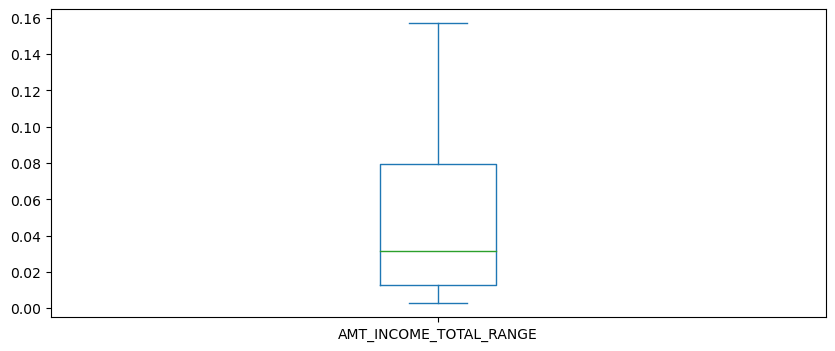

In [37]:
#plotting the boxplot for AMT_INCOME_TOTAL_RANGE to understand the column, in this plot outliers are expelled because in the binning process we took the upper limit for the bins range as upper fence of the column.
plt.figure(figsize=(10,4))
df1.AMT_INCOME_TOTAL_RANGE.value_counts(normalize=True).plot.box()
plt.show()

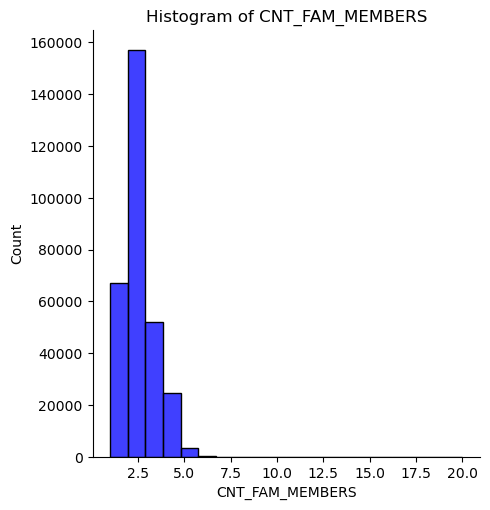

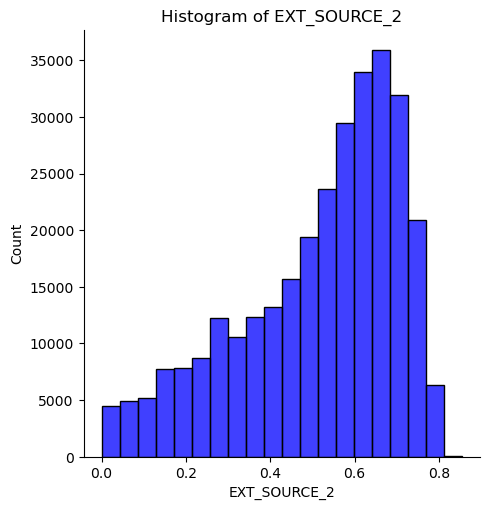

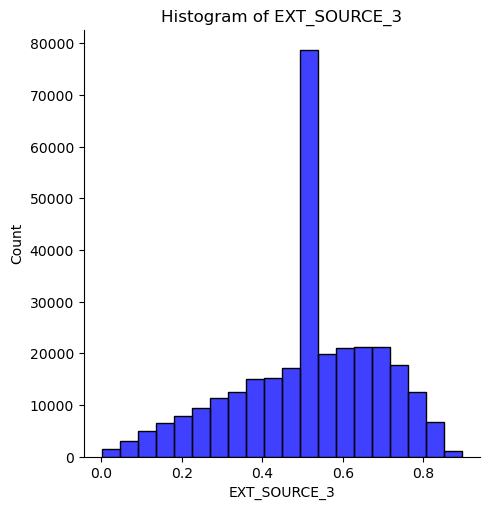

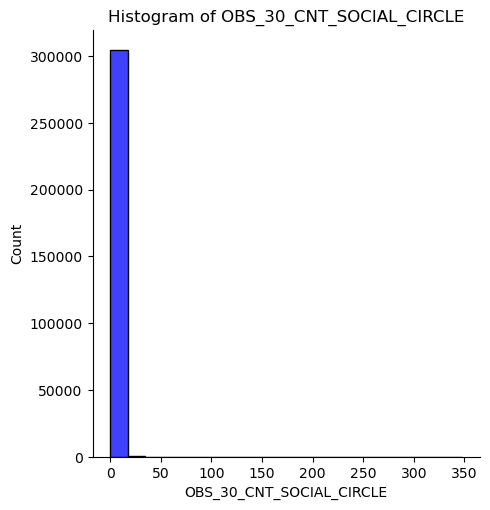

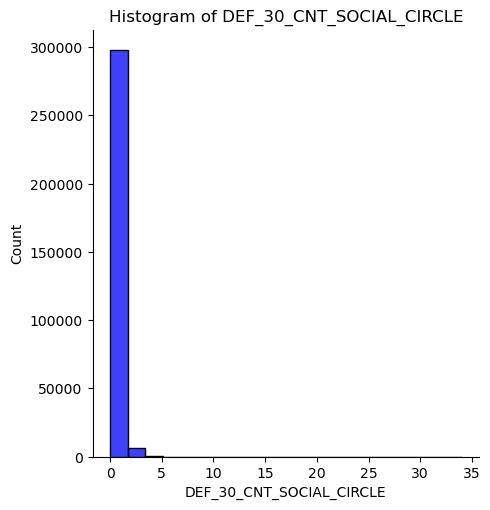

...

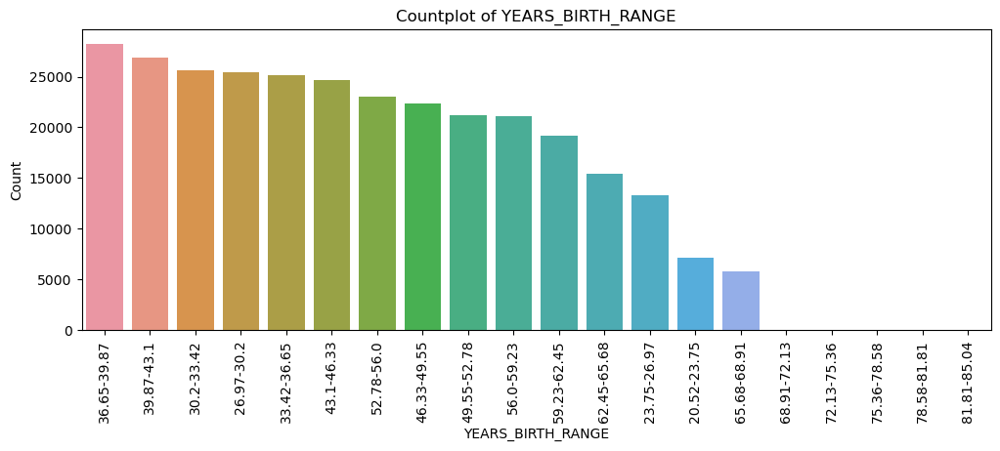

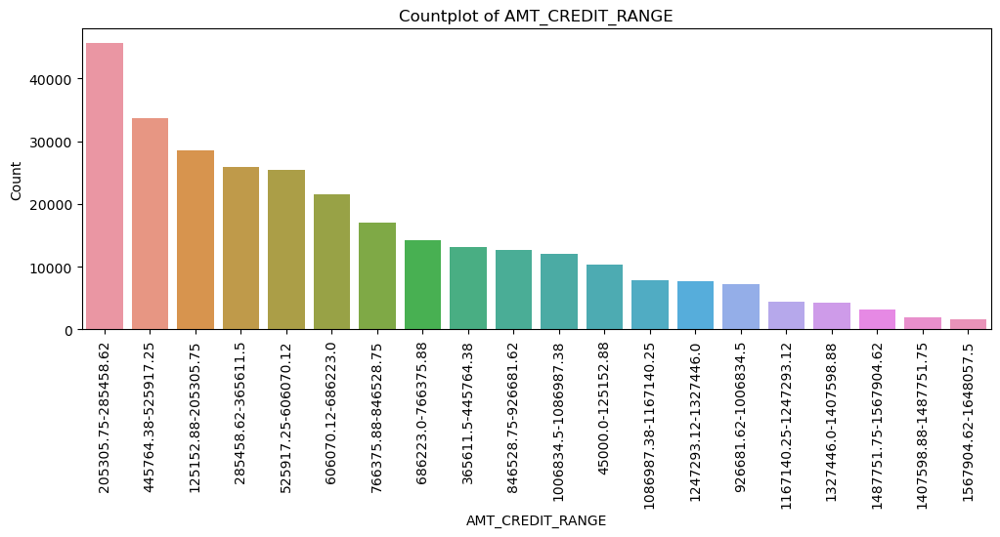

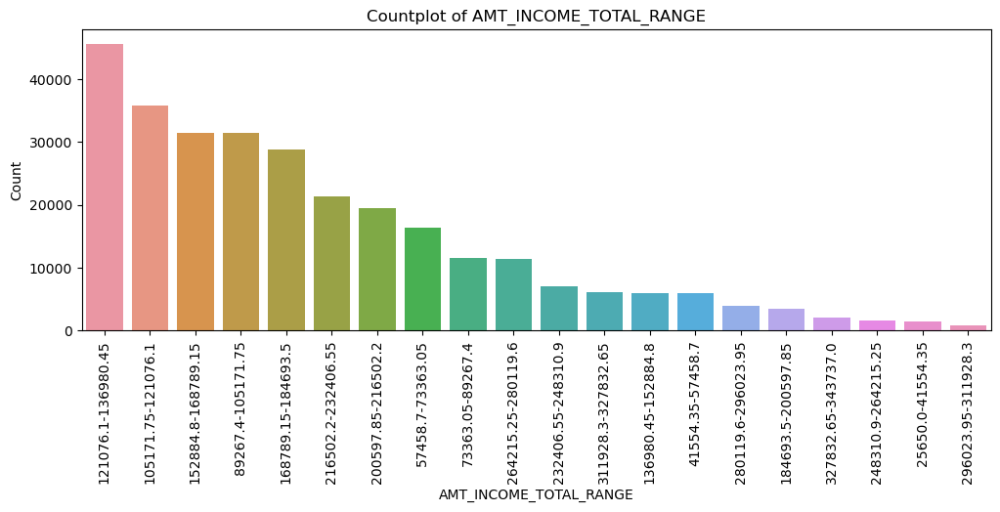

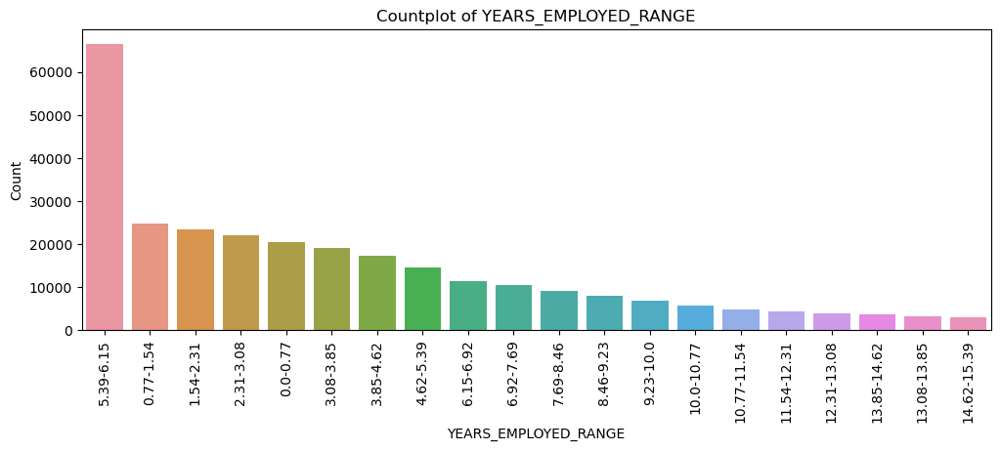

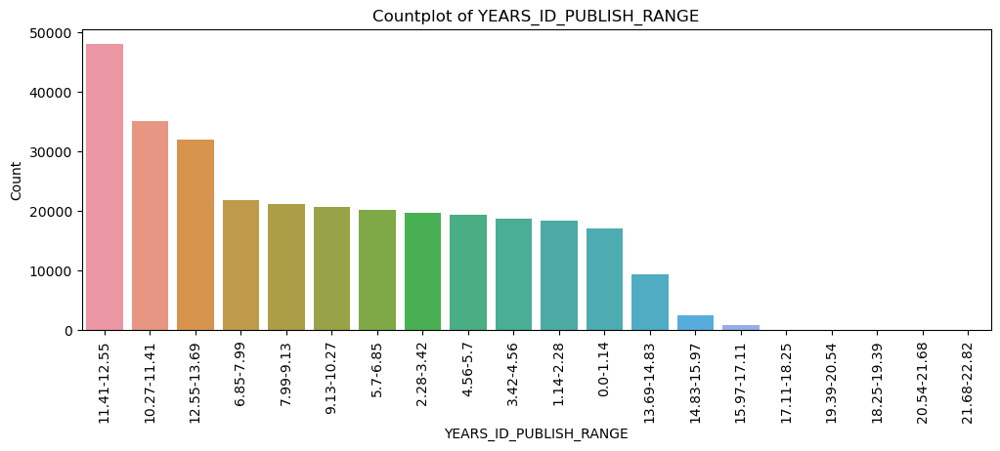

In [38]:
# segmenting the data upon the type of variables
# upon the observations all the float type data types come under continuous variables and one 
# seperating the columns according to the dtypes
# plotting the graphs in a loop by using segments
# using hist plot for continuous variables and countplot for categorical variables
conts = [k for (k, v) in df1.dtypes.to_dict().items() if v == 'float64']
cats = [k for (k, v) in df1.dtypes.to_dict().items() if v == 'int64' or v == 'object' or v == 'category']
for i in ['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH']:
    bincols.append(i)
for i in bincols:
    if i in conts:
        conts.remove(i)
    else:
        cats.remove(i)
for i in conts:
    g = sns.FacetGrid(df1, height=5)
    g.map(sns.histplot, i, kde=False, bins=20, color='blue')
    g.set(xlabel=i, ylabel='Count', title=f'Histogram of {i}')
    plt.show()
for i in ('SK_ID_CURR','DAYS_LAST_PHONE_CHANGE','EXT_SOURCE_3','EXT_SOURCE_2'):
    if i in cats:
        cats.remove(i)
    else:
        conts.remove(i)
for i in cats:
    plt.figure(figsize=(12, 4))
    sns.countplot(data=df1, x=i, order=df1[i].value_counts().index)
    plt.xticks(rotation=90)
    plt.xlabel(i)
    plt.ylabel('Count')
    plt.title(f'Countplot of {i}')
    plt.show()

Insights:
- The majority of loan applicants are laborers.
- Most loan applicants belong to either Business Entity Type3 or Self-Employed Organization Type. 

# Data Imbalance

Data imbalance refers to the situation where the distribution of classes in a dataset is not uniform, resulting in some classes having significantly more or fewer examples than others.

In [39]:
# finding the value counts
df1['TARGET'].value_counts(normalize=True)*100

0    91.900004
1     8.099996
Name: TARGET, dtype: float64

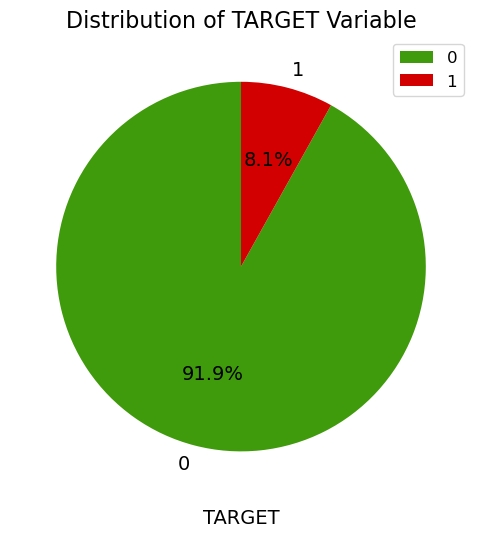

In [40]:
# plotting the pie chart
plt.figure(figsize=(6,6))
labels = ['0', '1']
sizes = df1['TARGET'].value_counts(normalize=True) * 100
colors = ['#3f9b0b', '#d20000'] # green and red
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90, textprops={'fontsize': 14})
# Add a title and labels
plt.title('Distribution of TARGET Variable', fontsize=16)
plt.legend(labels, loc='best', fontsize=12)
plt.xlabel('TARGET', fontsize=14)
# Display the plot
plt.show()

In [91]:
# calculating the data imbalance using the TARGET variable.
imbalance = df1['TARGET'].value_counts(normalize=True).max() / df1['TARGET'].value_counts(normalize=True).min()
imbalance_pct = imbalance
print(f"Imbalance percentage: {imbalance_pct:.2f}%")

Imbalance percentage: 11.35%


#### data imbalance ratio is 11.35% obtained by the ratio of the counts of the 0's and 1's

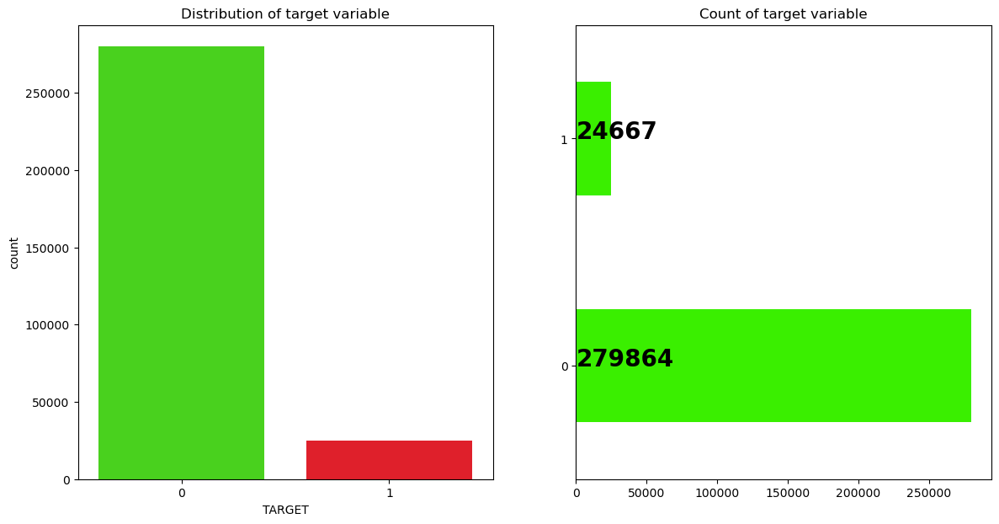

In [42]:
#plotting the distribution of the target variable.
plt.figure(figsize=(14,7))
plt.subplot(121)
sns.set_palette("prism")
sns.countplot(data=df1, x="TARGET")
plt.title("Distribution of target variable")
# Matplotlib horizontal bar chart
plt.subplot(122)
ax = df1["TARGET"].value_counts().plot(kind="barh")
for i,j in enumerate(df1["TARGET"].value_counts().values):
    ax.text(.7,i,j,weight="bold",fontsize=20)
plt.title("Count of target variable")
plt.show()

In [43]:
Target0 = df1.loc[df1.TARGET == 0]
Target1 = df1.loc[df1.TARGET == 1] 

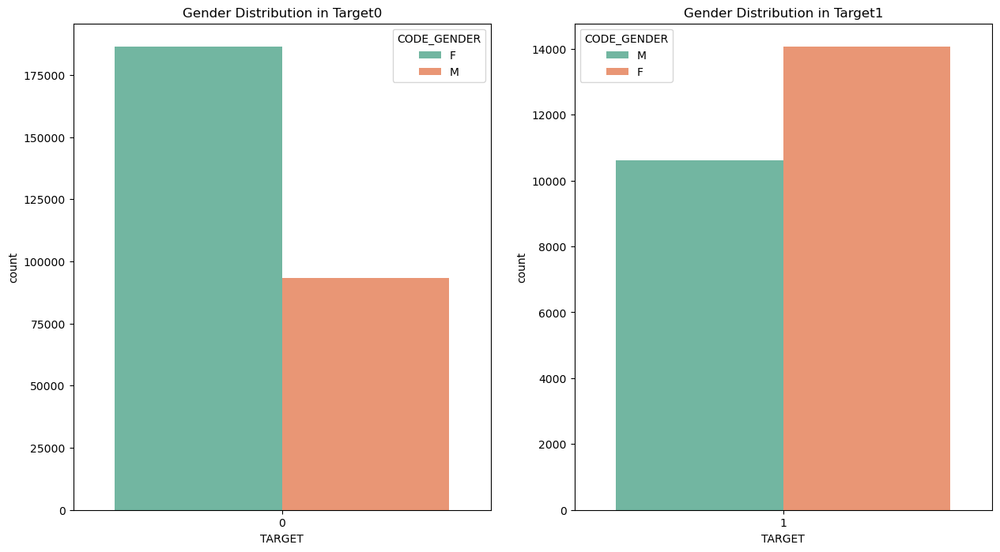

In [44]:
plt.figure(figsize=(15,8))
plt.subplot(121)
sns.countplot(x='TARGET',hue='CODE_GENDER',data=Target0, palette = 'Set2')
plt.title("Gender Distribution in Target0")
plt.subplot(122)
sns.countplot(x='TARGET',hue='CODE_GENDER',data=Target1, palette = 'Set2')
plt.title("Gender Distribution in Target1")
plt.show()

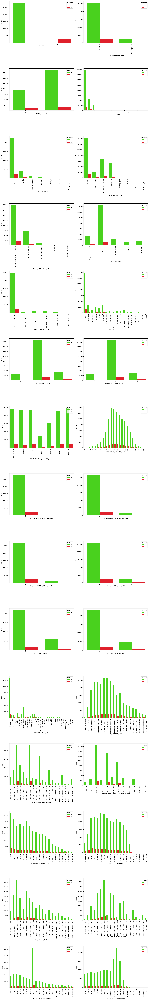

In [45]:
plt.figure(figsize=(15,100))
for i in range(30):
    plt.subplot(15,2,i+1)
    sns.countplot(data=df1, x=cats[i] ,hue='TARGET',orient='v')
    plt.xlabel(cats[i])
    plt.ylabel("count")
    plt.xticks(rotation=90)
    plt.legend(title='TARGET', loc='upper right')
    plt.tight_layout()
plt.show()

# Bivariate analysis

## categorical-categorical

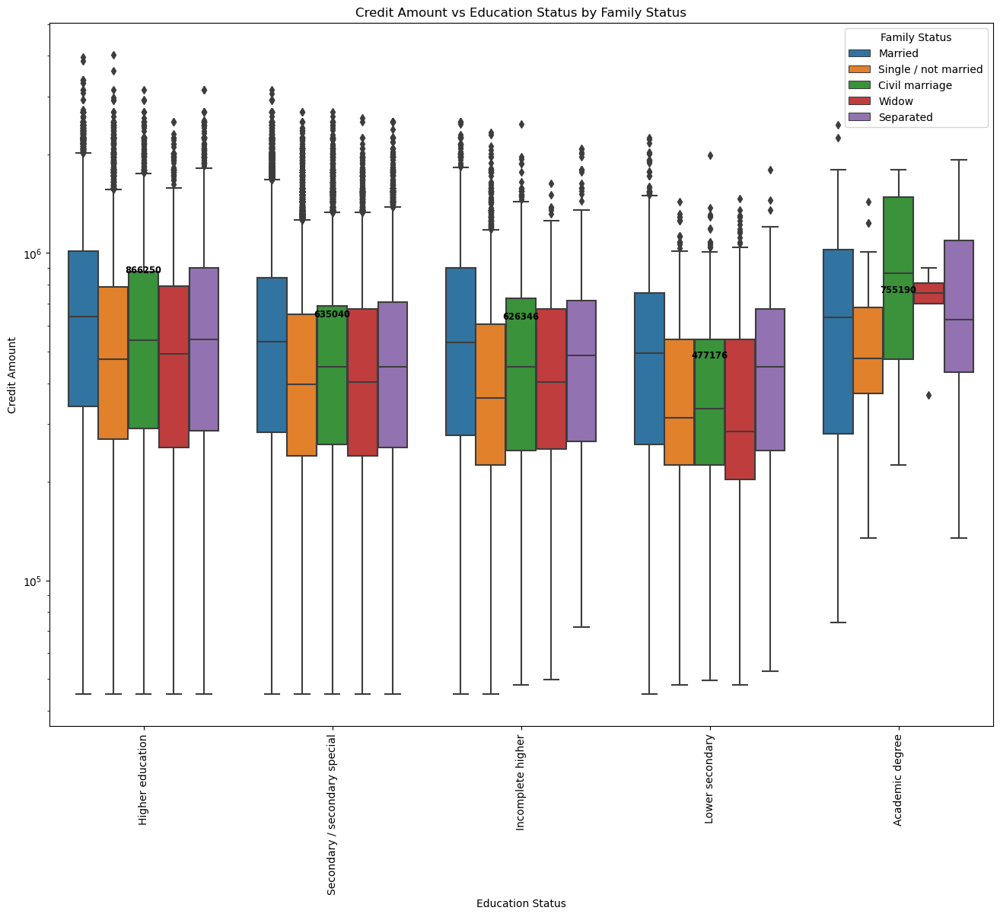

In [47]:
# Define custom colors for each category
colors = {'Married': '#1f77b4', 'Single / not married': '#ff7f0e', 'Civil marriage': '#2ca02c', 
          'Widow': '#d62728', 'Separated': '#9467bd'}
plt.figure(figsize=(16, 12))
sns.boxplot(data=Target0, x='NAME_EDUCATION_TYPE', y='AMT_CREDIT', hue='NAME_FAMILY_STATUS', orient='v', 
            palette=colors)
plt.xticks(rotation=90)
plt.yscale('log')
plt.xlabel('Education Status')
plt.ylabel('Credit Amount')
plt.title('Credit Amount vs Education Status by Family Status')
# Add legend and set title
plt.legend(title='Family Status', loc='upper right')
# Add median value labels inside the box plot
medians = Target0.groupby(['NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS'])['AMT_CREDIT'].median().values
pos = range(len(medians))
for tick, label in zip(pos, plt.gca().get_xticklabels()):
    plt.gca().text(pos[tick], medians[tick] + 1000, '{:.0f}'.format(medians[tick]), horizontalalignment='center', 
                   size='small', color='black', weight='semibold')
plt.show()

The median value for the `AMT_CREDIT` variable is higher for the "Civil marriage" category compared to the other categories in the same `NAME_EDUCATION_TYPE` group. The text labels are added to show the median value for each box plot, and in this case, the median for the "Civil marriage" category is probably the highest among the categories within the same `NAME_EDUCATION_TYPE` group. 

It's also possible that there is some overlap between the boxes for the other categories, making it difficult to add text labels without them overlapping. The code tries to place the text label above the box plot for each category, but if there isn't enough space above the box plot, the text label may be placed inside the box plot instead.

insights:
- Married individuals are interested in taking loans.
- Education level affects interest in taking loans.
- The box plot suggests that:
  - Civil marriage, marriage, and separated family statuses with academic degrees have higher credit numbers.
  - Higher education levels for family statuses of marriage, single, and civil marriage have more outliers.
  - Civil marriage with an academic degree has most of the credits in the third quartile.

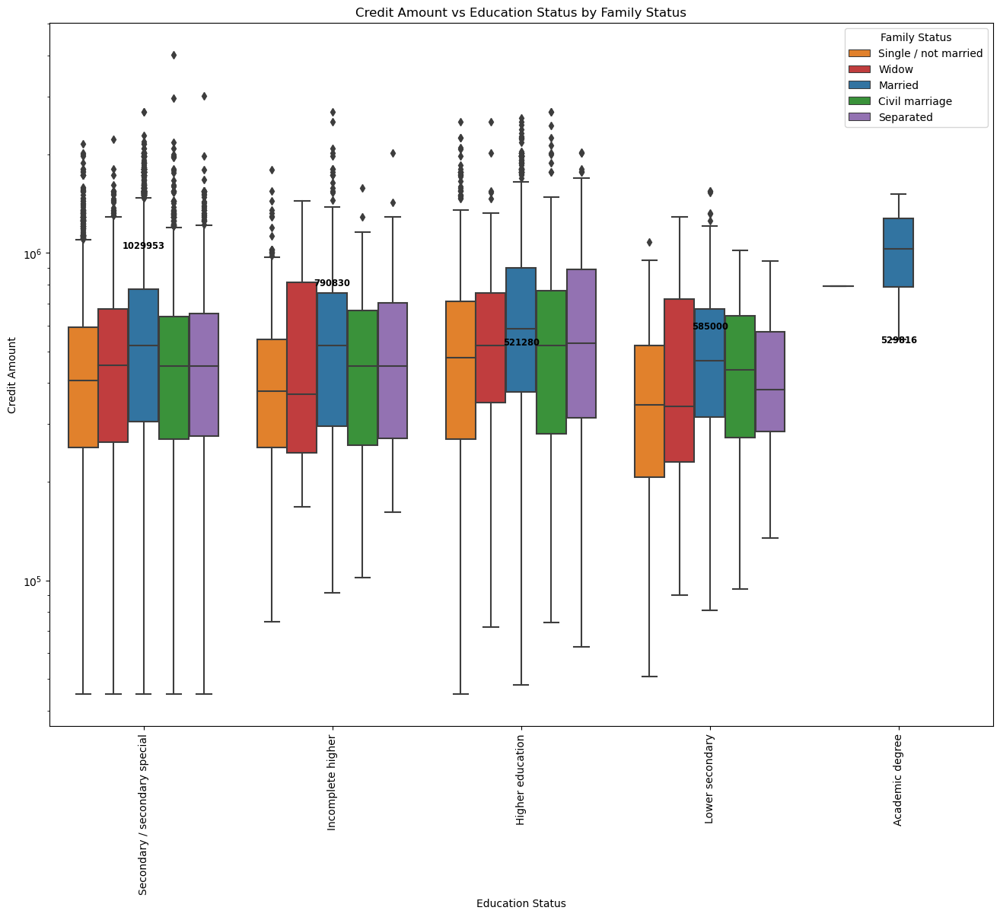

In [48]:
# Define custom colors for each category
colors = {'Married': '#1f77b4', 'Single / not married': '#ff7f0e', 'Civil marriage': '#2ca02c', 
          'Widow': '#d62728', 'Separated': '#9467bd'}
plt.figure(figsize=(16, 12))
sns.boxplot(data=Target1, x='NAME_EDUCATION_TYPE', y='AMT_CREDIT', hue='NAME_FAMILY_STATUS', orient='v', 
            palette=colors)
plt.xticks(rotation=90)
plt.yscale('log')
plt.xlabel('Education Status')
plt.ylabel('Credit Amount')
plt.title('Credit Amount vs Education Status by Family Status')
# Add legend and set title
plt.legend(title='Family Status', loc='upper right')
# Add median value labels inside the box plot
medians = Target1.groupby(['NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS'])['AMT_CREDIT'].median().values
pos = range(len(medians))
for tick, label in zip(pos, plt.gca().get_xticklabels()):
    plt.gca().text(pos[tick], medians[tick] + 1000, '{:.0f}'.format(medians[tick]), horizontalalignment='center', 
                   size='small', color='black', weight='semibold')
plt.show()

The median value for the `AMT_CREDIT` variable is higher for the "married" category compared to the other categories in the same `NAME_EDUCATION_TYPE` group. The text labels are added to show the median value for each box plot, and in this case, the median for the "Civil marriage" category is probably the highest among the categories within the same `NAME_EDUCATION_TYPE` group. 

It's also possible that there is some overlap between the boxes for the other categories, making it difficult to add text labels without them overlapping. The code tries to place the text label above the box plot for each category, but if there isn't enough space above the box plot, the text label may be placed inside the box plot instead.

Insights:
- For the "Higher education" education type, the income amount is mostly equal to the family status.
- There are many outliers for this education type.
- For "Academic degree" education type, there are fewer outliers, but the income amount is slightly higher than for "Higher education."
- For the "Lower secondary" education type and civil marriage family status, the income amount is less than for others.

## Numerical-Numerical

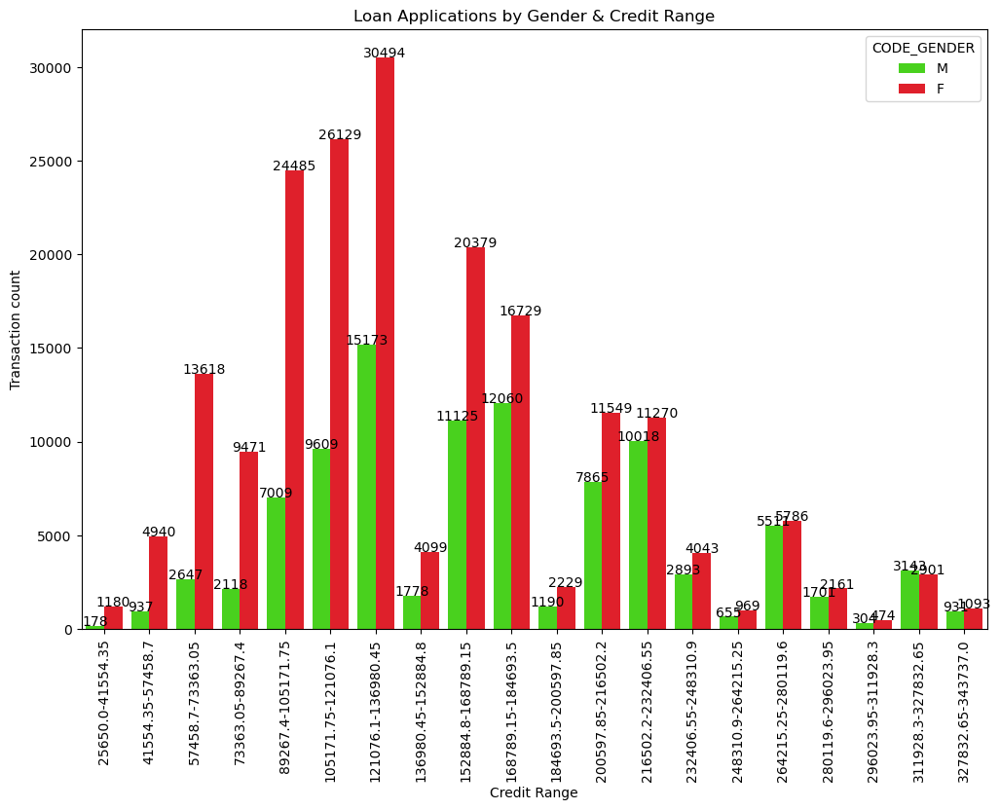

In [49]:
plt.figure(figsize=(12, 8))
sns.barplot(data=df1,
            x='AMT_INCOME_TOTAL_RANGE',
            y='SK_ID_CURR',
            hue='CODE_GENDER',
            estimator=len)
plt.xlabel('Credit Range')
plt.ylabel('Transaction count')
plt.title('Loan Applications by Gender & Credit Range')
# Add value labels above each bar
for p in plt.gca().patches:
    height = p.get_height()
    plt.gca().text(p.get_x() + p.get_width() / 2,
                   height + 10,
                   '{:.0f}'.format(height),
                   ha='center')
# Rotate x-axis labels
plt.xticks(rotation=90)
plt.show()

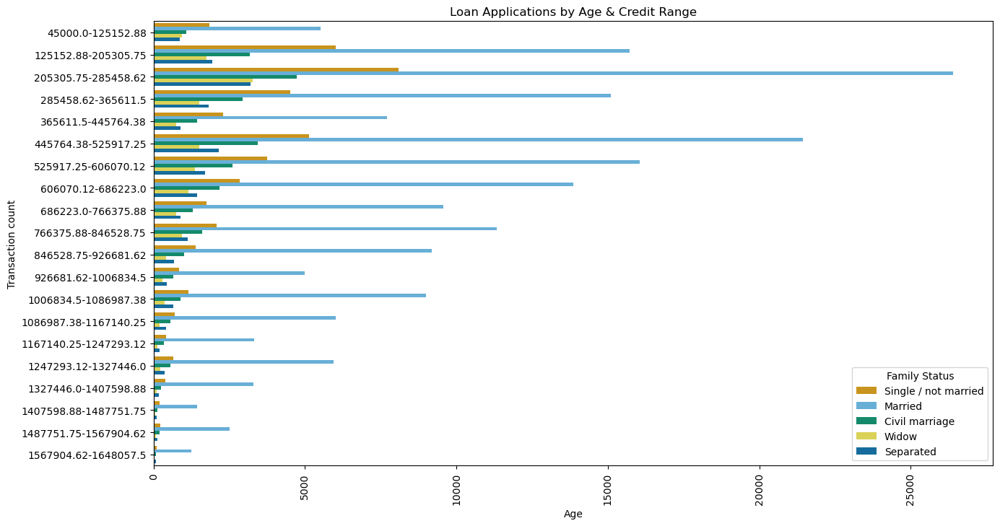

In [52]:
plt.figure(figsize=(15, 8))
sns.barplot(data=df1,
            x='YEARS_BIRTH',
            y='AMT_CREDIT_RANGE',
            hue='NAME_FAMILY_STATUS',
            palette=['#E69F00', '#56B4E9', '#009E73', '#F0E442', '#0072B2'],
            estimator=len)
plt.xlabel('Age')
plt.ylabel('Transaction count')
plt.title('Loan Applications by Age & Credit Range')
plt.xticks(rotation=90)
plt.legend(title='Family Status')
plt.show()

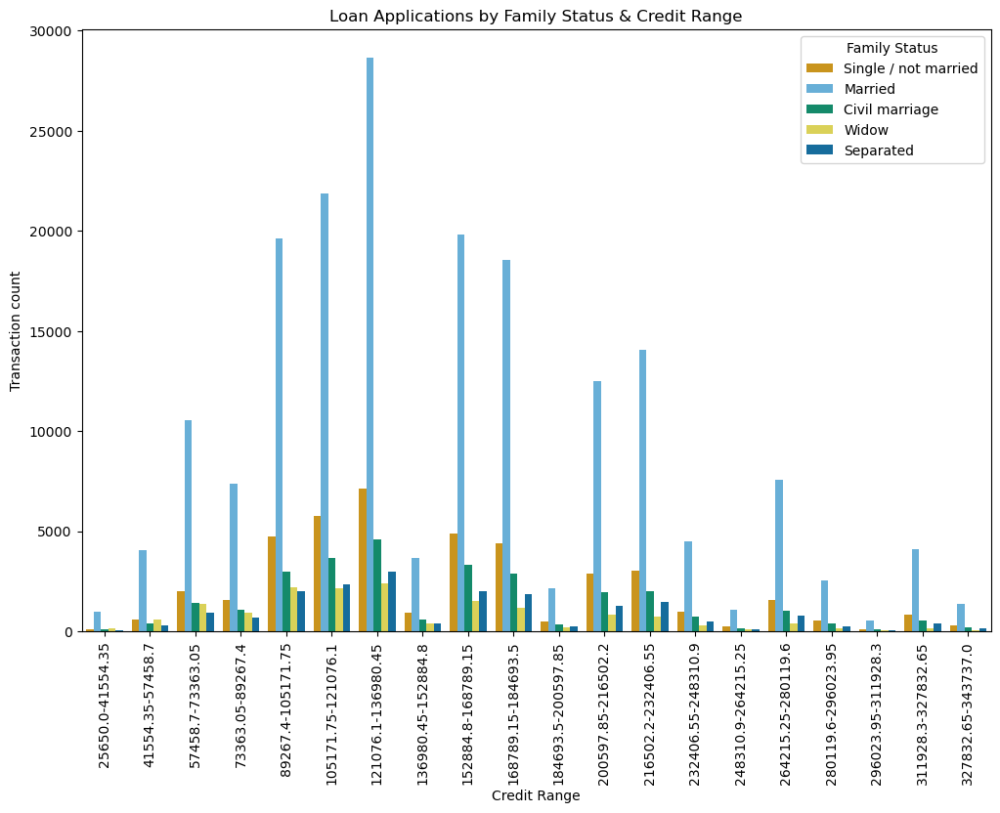

In [51]:
plt.figure(figsize=(12, 8))
sns.barplot(data=df1,
            x='AMT_INCOME_TOTAL_RANGE',
            y='SK_ID_CURR',
            hue='NAME_FAMILY_STATUS',
            estimator=len,
            palette=['#E69F00', '#56B4E9', '#009E73', '#F0E442', '#0072B2'])
plt.xlabel('Credit Range')
plt.ylabel('Transaction count')
plt.title('Loan Applications by Family Status & Credit Range')
plt.xticks(rotation=90)
plt.legend(title='Family Status', loc='upper right')
plt.show()

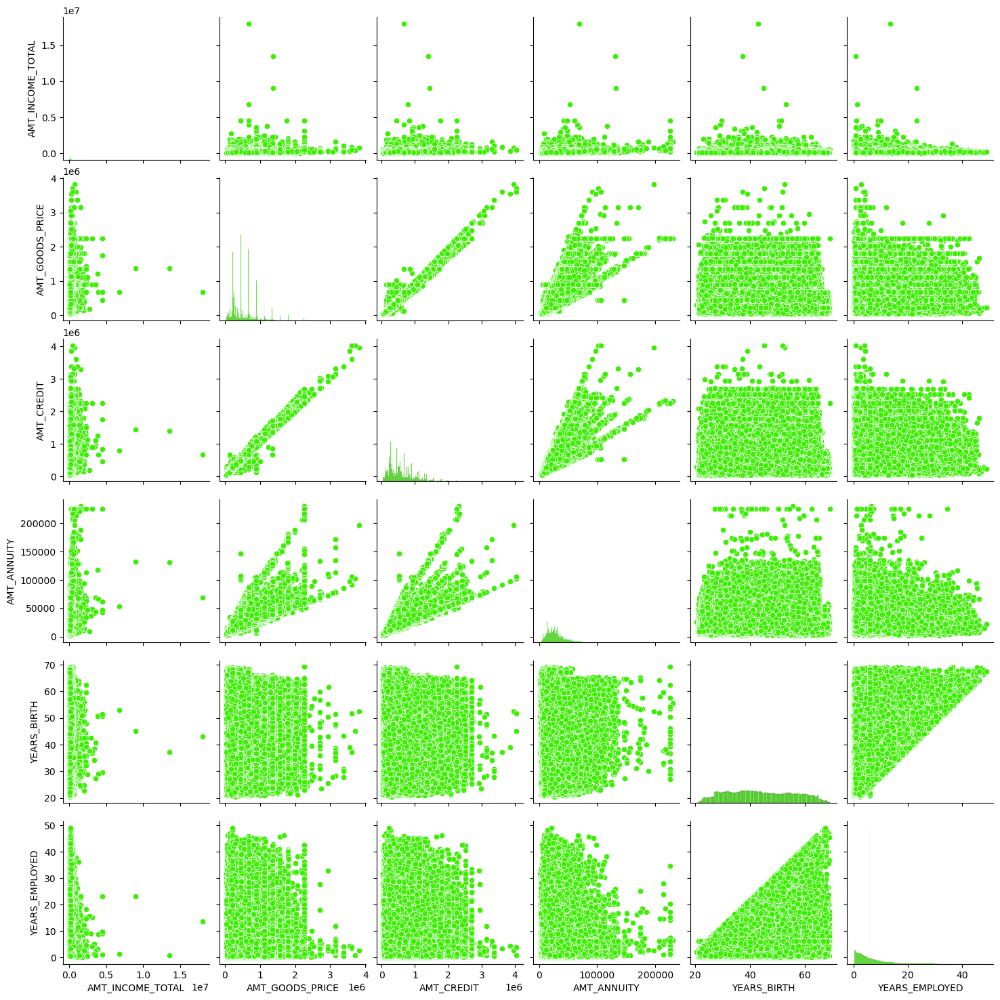

In [56]:
# Generate pair plot with enhanced labeling
sns.pairplot(df1[['AMT_INCOME_TOTAL', 'AMT_GOODS_PRICE', 'AMT_CREDIT', 'AMT_ANNUITY', 'YEARS_BIRTH', 'YEARS_EMPLOYED']],
             diag_kind='hist',
             diag_kws=dict(alpha=0.7),
             palette=['green'])
plt.show()


## Numerical - Categorical

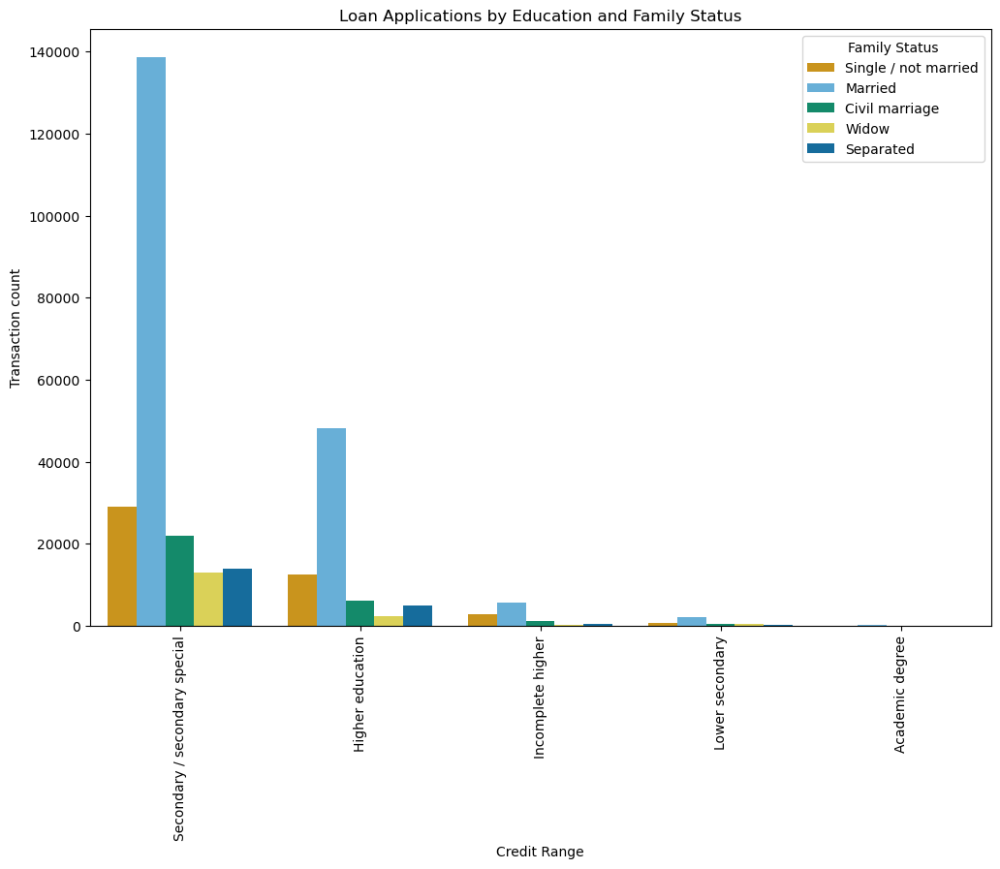

In [50]:
plt.figure(figsize=(12, 8))
sns.barplot(data=df1,
            x='NAME_EDUCATION_TYPE',
            y='SK_ID_CURR',
            hue='NAME_FAMILY_STATUS',
            estimator=len,
            palette=['#E69F00', '#56B4E9', '#009E73', '#F0E442', '#0072B2'])
plt.xlabel('Credit Range')
plt.ylabel('Transaction count')
plt.title('Loan Applications by Education and Family Status')
plt.xticks(rotation=90)
plt.legend(title='Family Status')
plt.show()

insights:
- Similar to Target 0, the box plot shows that the family statuses of "civil marriage," "marriage," and "separated" with an academic degree education have higher numbers of credits than others.
- Most of the outliers are from the "Higher education" and "Secondary" education types.
- For the "Academic degree" education type and civil marriage family status, most of the credits are in the third quartile.

In [103]:
conts

['CNT_FAM_MEMBERS',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_YEAR']

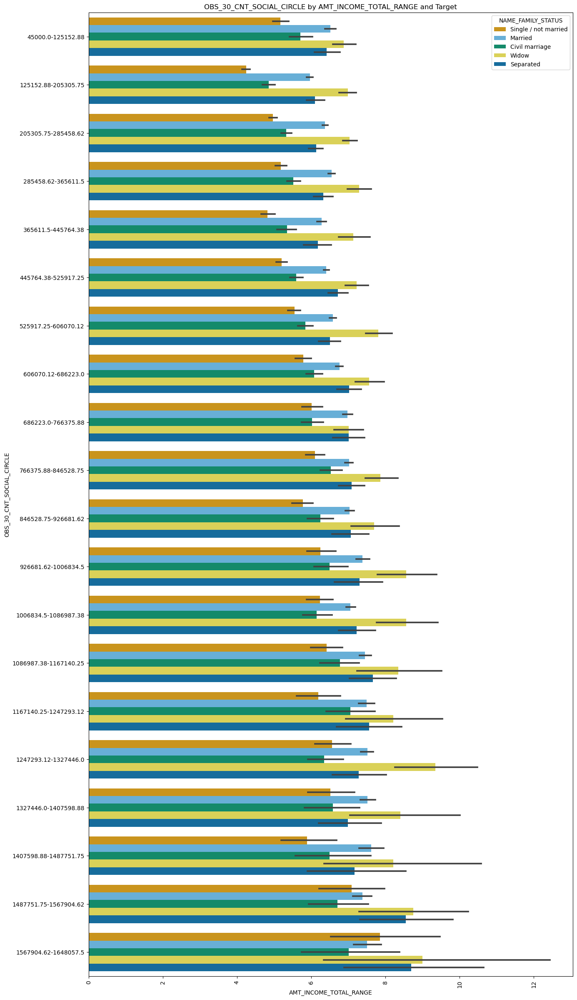

In [109]:
plt.figure(figsize=(15, ))
sns.barplot(data=df1, x='YEARS_EMPLOYED', y='AMT_CREDIT_RANGE', hue='NAME_FAMILY_STATUS',palette=['#E69F00', '#56B4E9', '#009E73', '#F0E442', '#0072B2'])
plt.xlabel(cat)
plt.ylabel(cont)
plt.title(f'{cont} by {cat} and Target')
plt.xticks(rotation=90)
plt.show()

Insights:
- Similar to Target0, for the "Higher education" education type, the income amount is mostly equal to the family status.
- There are fewer outliers for the "Academic degree" education type, but their income amount is slightly higher than for "Higher education."
- For the "Lower secondary" education type, the income amount is less than for others.

# Multivariate Analysis

In [57]:
Target0.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,...,YEARS_ID_PUBLISH,AMT_ANNUITY_RANGE,AMT_GOODS_PRICE_RANGE,REGION_POPULATION_RELATIVE_RANGE,YEARS_REGISTRATION_RANGE,YEARS_BIRTH_RANGE,AMT_CREDIT_RANGE,AMT_INCOME_TOTAL_RANGE,YEARS_EMPLOYED_RANGE,YEARS_ID_PUBLISH_RANGE
1,100003,0,Cash loans,F,0,270000.0,1293502.5,35698.5,1129500.0,Family,...,0.80,35346.61-38413.07,1101708.0-1168033.5,0.0-0.01,2.19-4.38,43.1-46.33,1247293.12-1327446.0,264215.25-280119.6,3.08-3.85,0.0-1.14
2,100004,0,Revolving loans,M,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,...,6.93,4681.96-7748.43,106825.5-173151.0,0.01-0.01,10.95-13.15,49.55-52.78,125152.88-205305.75,57458.7-73363.05,0.0-0.77,6.85-7.99
3,100006,0,Cash loans,F,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,...,6.68,29213.68-32280.14,239476.5-305802.0,0.01-0.01,26.29-28.48,49.55-52.78,285458.62-365611.5,121076.1-136980.45,7.69-8.46,5.7-6.85
4,100007,0,Cash loans,M,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,...,9.47,20014.29-23080.75,504778.5-571104.0,0.03-0.03,10.95-13.15,52.78-56.0,445764.38-525917.25,121076.1-136980.45,7.69-8.46,9.13-10.27
5,100008,0,Cash loans,M,0,99000.0,490495.5,27517.5,454500.0,"Spouse, partner",...,1.31,26147.21-29213.68,438453.0-504778.5,0.03-0.04,13.15-15.34,46.33-49.55,445764.38-525917.25,89267.4-105171.75,3.85-4.62,1.14-2.28


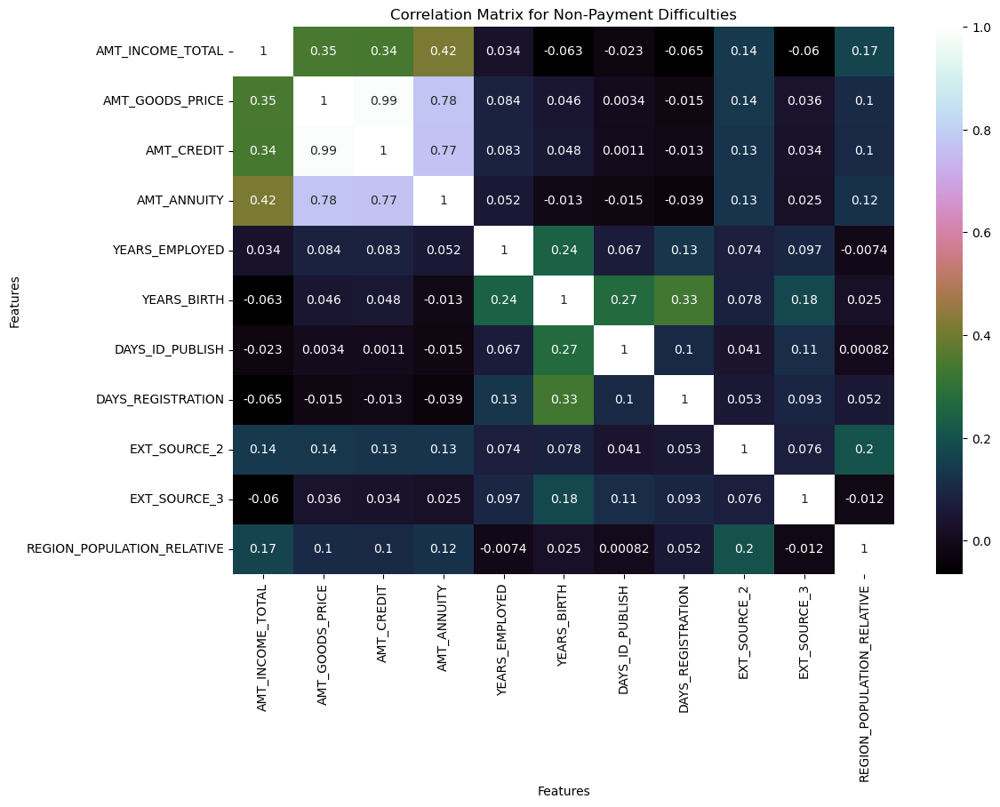

In [58]:
plt.figure(figsize=(12,8))
# select columns for correlation matrix
columns = ['AMT_INCOME_TOTAL', 'AMT_GOODS_PRICE', 'AMT_CREDIT', 'AMT_ANNUITY',
           'YEARS_EMPLOYED', 'YEARS_BIRTH', 'DAYS_ID_PUBLISH', 'DAYS_REGISTRATION',
           'EXT_SOURCE_2', 'EXT_SOURCE_3', 'REGION_POPULATION_RELATIVE']
# create correlation matrix
corr_matrix = Target0[columns].corr()
# plot heatmap
sns.heatmap(corr_matrix, annot=True, cmap="cubehelix")
# set plot title and axis labels
plt.title('Correlation Matrix for Non-Payment Difficulties')
plt.xlabel('Features')
plt.ylabel('Features')
# show plot
plt.show()

insights:
- AMT_GOODS_PRICE & AMT_CREDIT has highest correlation.
- Age_in_years , Employment_years & AMT_INCOME_TOTAL has Negative correlation.

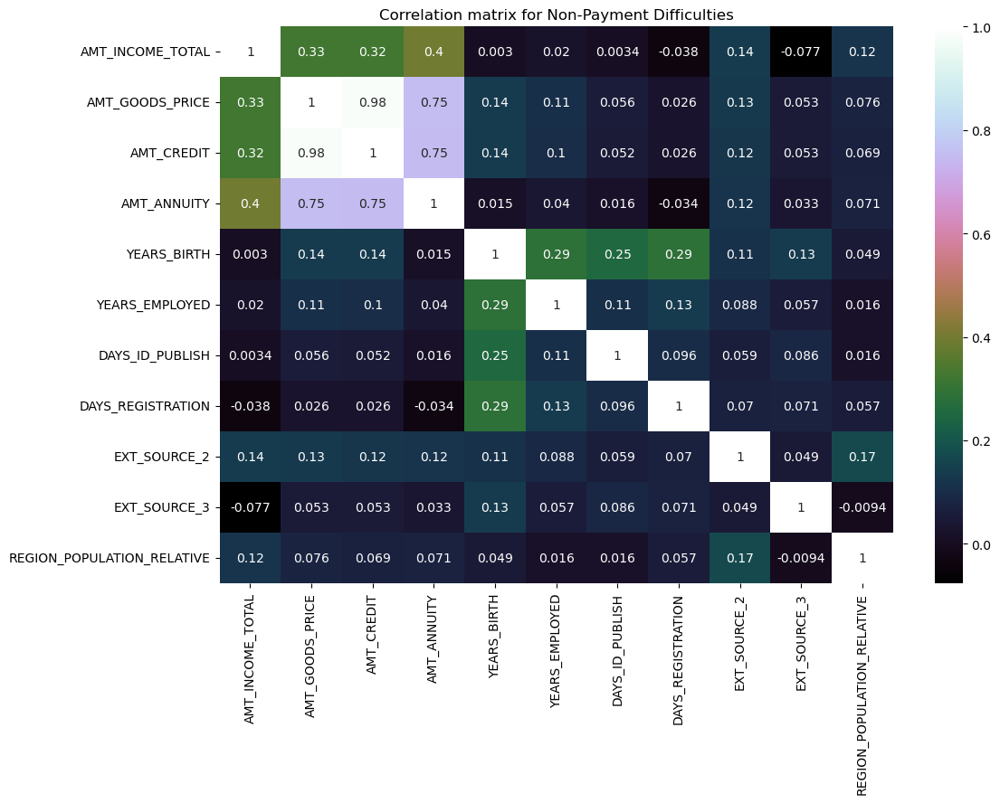

In [110]:
plt.figure(figsize=(12,8))
corr_matrix = Target1[['AMT_INCOME_TOTAL', 'AMT_GOODS_PRICE',
                           'AMT_CREDIT', 'AMT_ANNUITY', 'YEARS_BIRTH',
                           'YEARS_EMPLOYED', 'DAYS_ID_PUBLISH',
                           'DAYS_REGISTRATION', 'EXT_SOURCE_2',
                           'EXT_SOURCE_3', 'REGION_POPULATION_RELATIVE']].corr()

sns.heatmap(corr_matrix, annot=True, cmap="cubehelix")
plt.title('Correlation matrix for Non-Payment Difficulties')
plt.show()

# cleaning the previous_data.csv

In [60]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

we are having 
15 float_cols
6 int_cols
16 object_cols

In [61]:
df2.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


we are having 'SK_ID_CURR' a common column

In [62]:
#checking the shape of the previous application data frame
df2.shape

(1670214, 37)

In [63]:
a_n1= (df2.isnull().mean()*100).to_dict()

In [64]:
# extracting the columns with null values
df2_nulls={k:round(v,3) for (k,v) in a_n1.items() if v>0}

In [65]:
#extracting columns with null values greater than or equal to 40%
df240_nulls={k:v for (k,v) in df2_nulls.items() if v>=40}

In [66]:
# drop the columns
for i in list(df240_nulls.keys()):
    df2.drop(i, axis=1, inplace=True)
df2.shape

(1670214, 26)

In [67]:
#extracting columns with null values less than or equal to 5%
df25_nulls={k:v for (k,v) in df2_nulls.items() if v<5}

In [68]:
#dropping the null value records which are less than 5% in a column 
for i in (df25_nulls.keys()):
    df2.dropna(subset=i , inplace=True)
df2.shape

(1669867, 26)

In [69]:
#finding the dtypes of the columns whose null values are around 5-40%
#extracting columns with null values
df25to40_nulls={k:v for (k,v) in df2_nulls.items() if v>=5 and v<40}
df25to40_nulls

{'AMT_ANNUITY': 22.287, 'AMT_GOODS_PRICE': 23.082, 'CNT_PAYMENT': 22.286}

In [70]:
for i in df25to40_nulls:
    df2[i]=df2[i].fillna(df2[i].mode()[0])

In [71]:
#seperating the columns according to the dtypes
df2_ints={k:str(v) for (k,v) in (df2.dtypes.to_dict().items()) if v=='int64'}
df2_floats={k:str(v) for (k,v) in (df2.dtypes.to_dict().items()) if v=='float64'}
df2_objects={k:str(v) for (k,v) in (df2.dtypes.to_dict().items()) if v=='object'}

#extracting the list of columns of ecah datatype in between the 5to40%
int2_cols=[x for x in list(df25to40_nulls.keys()) if x in list(df2_ints.keys())]
float2_cols=[x for x in list(df25to40_nulls.keys()) if x in list(df2_floats.keys())]
object2_cols=[x for x in list(df25to40_nulls.keys()) if x in list(df2_objects.keys())]

In [72]:
#finding for the unique values of ecah column to know if there any deviation to be corrected.
for i in df2.columns:
    print(df2[i].unique())
    print(i)
    print('\n')

[2030495 2802425 2523466 ... 2659632 2785582 2418762]
SK_ID_PREV


[271877 108129 122040 ... 253940 353284 191629]
SK_ID_CURR


['Consumer loans' 'Cash loans' 'Revolving loans']
NAME_CONTRACT_TYPE


[ 1730.43  25188.615 15060.735 ... 15708.15   8546.94  14704.29 ]
AMT_ANNUITY


[ 17145.   607500.   112500.   ... 332596.08 373230.72 267295.5 ]
AMT_APPLICATION


[ 17145.   679671.   136444.5  ... 977724.   626796.   436370.22]
AMT_CREDIT


[ 17145.   607500.   112500.   ... 332596.08 373230.72 267295.5 ]
AMT_GOODS_PRICE


['SATURDAY' 'THURSDAY' 'TUESDAY' 'MONDAY' 'FRIDAY' 'SUNDAY' 'WEDNESDAY']
WEEKDAY_APPR_PROCESS_START


[15 11  7  9  8 10 12 13 14 16  6  4  5 19 17 18 20 22 21  3  1  2 23  0]
HOUR_APPR_PROCESS_START


['Y' 'N']
FLAG_LAST_APPL_PER_CONTRACT


[1 0]
NFLAG_LAST_APPL_IN_DAY


['XAP' 'XNA' 'Repairs' 'Everyday expenses' 'Car repairs'
 'Building a house or an annex' 'Other' 'Journey'
 'Purchase of electronic equipment' 'Medicine' 'Payments on other loans'
 'Urgent needs' 'Buyi

In [73]:
df2=df2.replace(['XNA','XAP'], np.NaN)

In [74]:
#checking the null values after all cleaning process
nullcheck2={k:v for (k,v) in (df2.isnull().mean().to_dict()).items() if v>0}
nullcheck2

{'NAME_CASH_LOAN_PURPOSE': 0.9582990741178788,
 'NAME_PAYMENT_TYPE': 0.375501162667446,
 'CODE_REJECT_REASON': 0.8132497977383828,
 'NAME_CLIENT_TYPE': 0.0011623680209262176,
 'NAME_GOODS_CATEGORY': 0.5691842523985443,
 'NAME_PORTFOLIO': 0.22270276614844176,
 'NAME_PRODUCT_TYPE': 0.636769275636922,
 'NAME_SELLER_INDUSTRY': 0.5124456019551258,
 'NAME_YIELD_GROUP': 0.3095264473158641}

In [75]:
for i in list(nullcheck2.keys()):
    df2[i].fillna(df2[i].mode()[0],inplace=True)

In [76]:
numcols2=list({k:str(v) for (k,v) in (df2.dtypes.to_dict().items()) if v=='int64'or v=='float64'}.keys())
for i in numcols2:
    df2[i]=abs(df2[i])

In [77]:
#checking the null values after all cleaning process
nullcheck2={k:v for (k,v) in (df2.isnull().mean().to_dict()).items() if v>0}
nullcheck2

{}

# BINNING

In [78]:
# Doing binning inorder to reduce the efforts and make graph more clen in terms of numerical variables
bincols=["AMT_ANNUITY","AMT_APPLICATION","AMT_CREDIT","AMT_GOODS_PRICE","CNT_PAYMENT"]
for i in bincols:
    # calculate bin size using min and upper fence values of the column
    min_value = df2[i].min()
    q3_value = df2[i].quantile(0.75)
    iqr_value = q3_value - df2[i].quantile(0.25)
    upper_fence = q3_value + 1.5*iqr_value
    bin_size = (upper_fence - min_value) / 50
    # create bins using np.linspace()
    bins = np.linspace(min_value, upper_fence + bin_size, 21)
    # create labels for the bins
    labels = [f"{round(bins[i],2)}-{round(bins[i+1],2)}" for i in range(len(bins)-1)]
    # add the binned data to the DataFrame as a new column
    df2[i+'_RANGE'] = pd.cut(df2[i], bins=bins, labels=labels, include_lowest=True, ordered=False)
df2.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,...,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,AMT_ANNUITY_RANGE,AMT_APPLICATION_RANGE,AMT_CREDIT_RANGE,AMT_GOODS_PRICE_RANGE,CNT_PAYMENT_RANGE
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,17145.0,SATURDAY,15,Y,...,35,Connectivity,12.0,middle,POS mobile with interest,0.0-1973.51,0.0-21568.3,0.0-25742.67,0.0-19570.61,11.48-12.75
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,607500.0,THURSDAY,11,Y,...,1,Consumer electronics,36.0,low_action,Cash X-Sell: low,23682.13-25655.64,NaN,NaN,NaN,NaN
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,112500.0,TUESDAY,11,Y,...,1,Consumer electronics,12.0,high,Cash X-Sell: high,13814.57-15788.09,107841.48-129409.77,128713.35-154456.02,97853.06-117423.67,11.48-12.75
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,450000.0,MONDAY,7,Y,...,1,Consumer electronics,12.0,middle,Cash X-Sell: middle,NaN,NaN,463368.07-489110.74,NaN,11.48-12.75
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,337500.0,THURSDAY,9,Y,...,1,Consumer electronics,24.0,high,Cash Street: high,31576.17-33549.68,323524.43-345092.72,386140.06-411882.73,332700.41-352271.02,22.95-24.22


## Univariate analysis

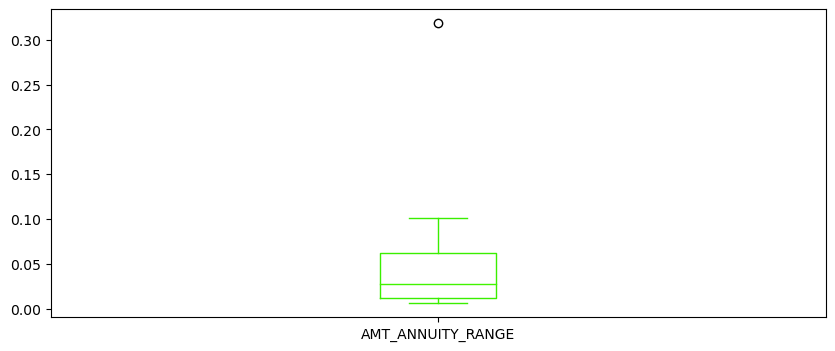

In [79]:
plt.figure(figsize=(10,4))
df2.AMT_ANNUITY_RANGE.value_counts(normalize=True).plot.box()
plt.show()

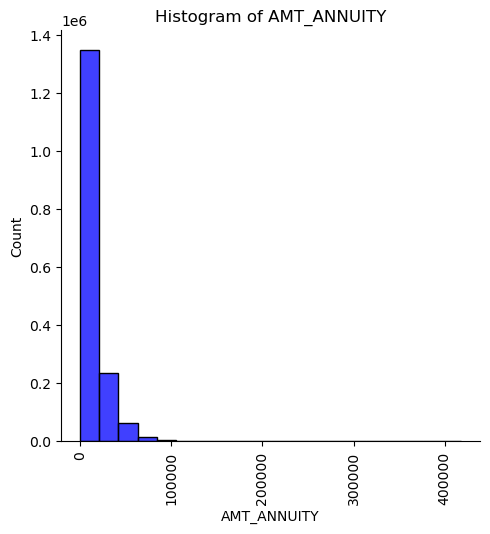

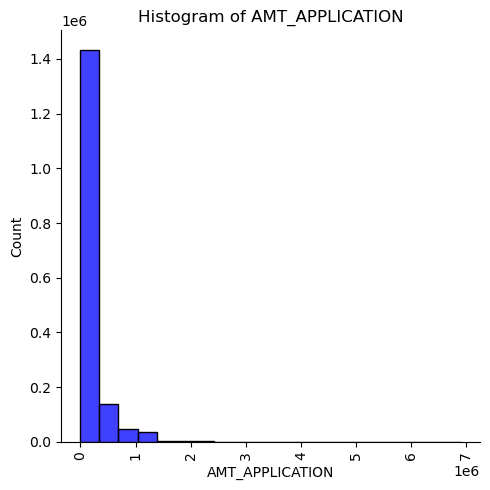

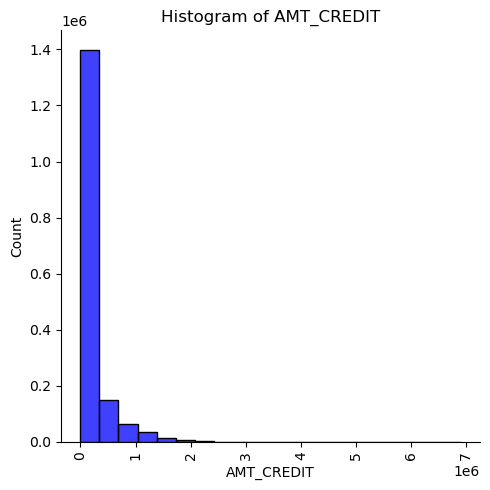

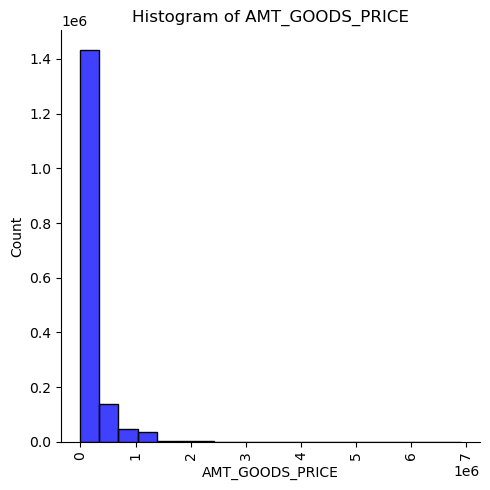

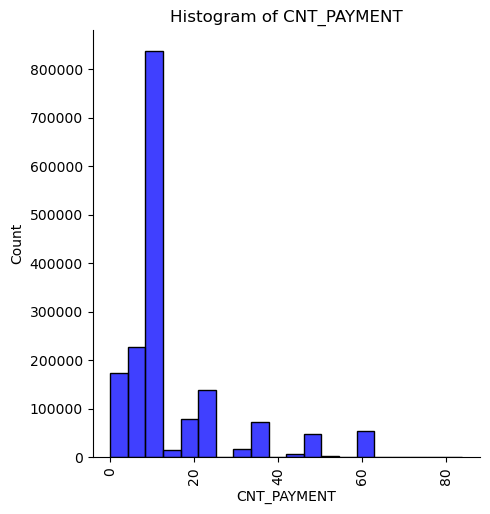

...

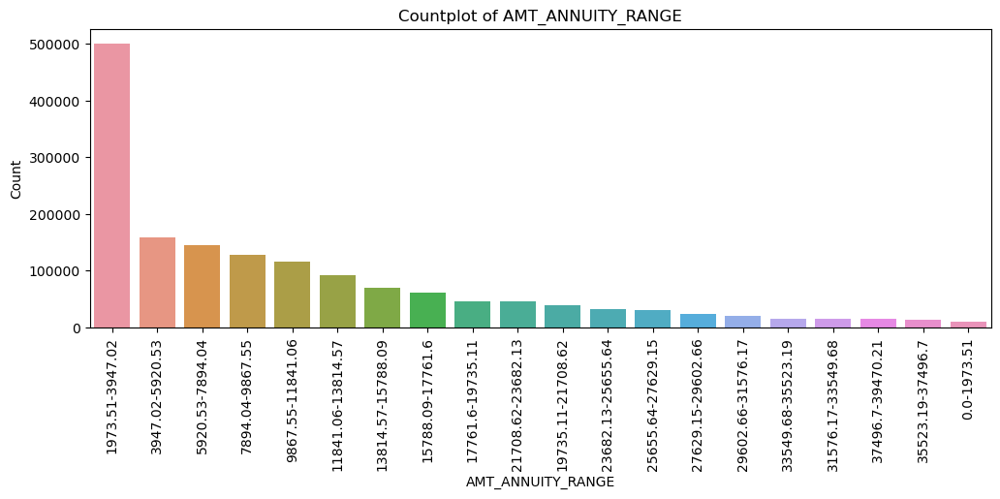

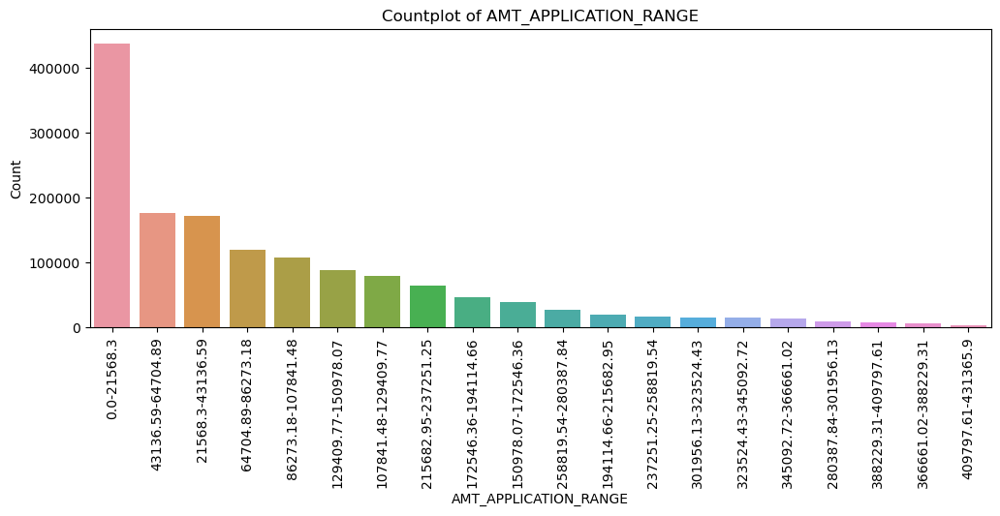

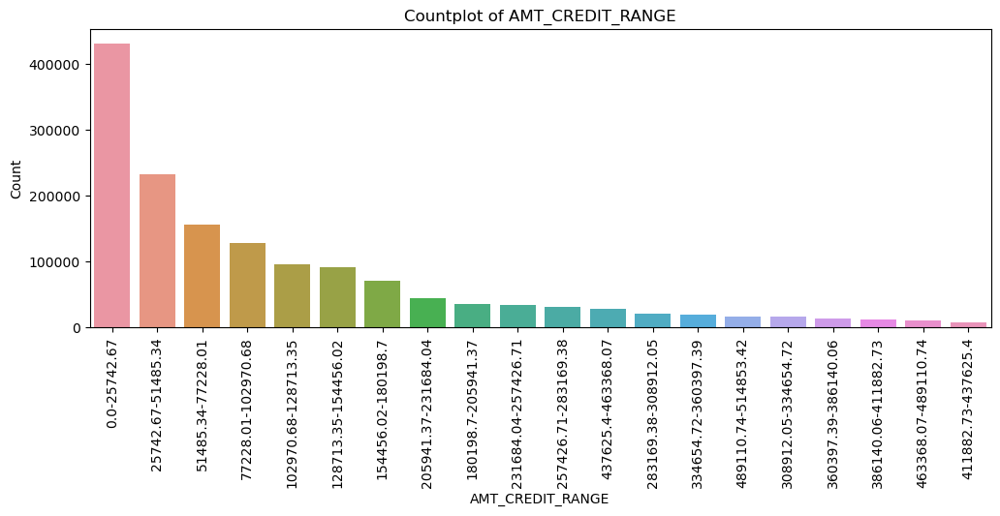

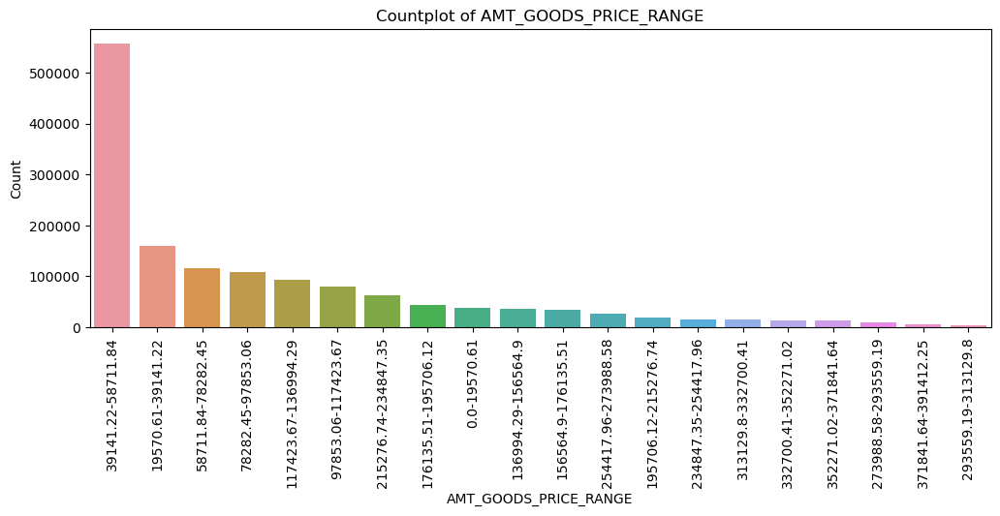

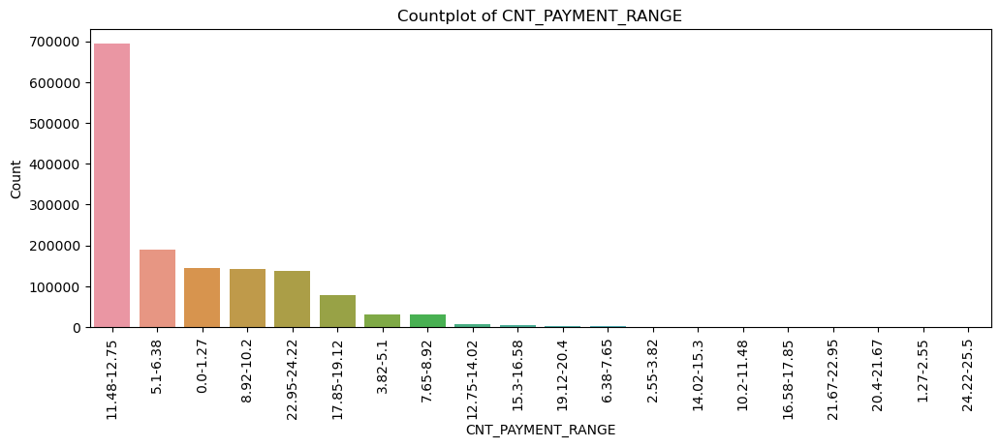

In [80]:
# segmenting the data upon the type of variables
# upon the observations all the float type data types come under continuous variables and one 
# seperating the columns according to the dtypes
# plotting the graphs in a loop by using segments
# using hist plot for continuous variables and countplot for categorical variables
conts2 = [k for (k, v) in df2.dtypes.to_dict().items() if v == 'float64']
cats2= [k for (k, v) in df2.dtypes.to_dict().items() if v == 'int64' or v == 'object' or v == 'category']
ranges2= [k for (k, v) in df2.dtypes.to_dict().items() if v == 'category']
cats2.remove('SK_ID_PREV')
cats2.remove('SK_ID_CURR')
cats2.remove('SELLERPLACE_AREA')
for i in conts2:
    g =sns.FacetGrid(df2, height=5)
    g.map(sns.histplot, i, kde=False, bins=20, color='blue')
    g.set(xlabel=i, ylabel='Count', title=f'Histogram of {i}')
    plt.xticks(rotation=90)
    plt.xlabel(i)
    plt.show()
for i in cats2:
    plt.figure(figsize=(12, 4))
    sns.countplot(data=df2, x=i,order=df2[i].value_counts().index)
    plt.xticks(rotation=90)
    plt.xlabel(i)
    plt.ylabel('Count')
    plt.title(f'Countplot of {i}')
    plt.show()

# Bivariate analysis of previous data

### Numerical - Numerical

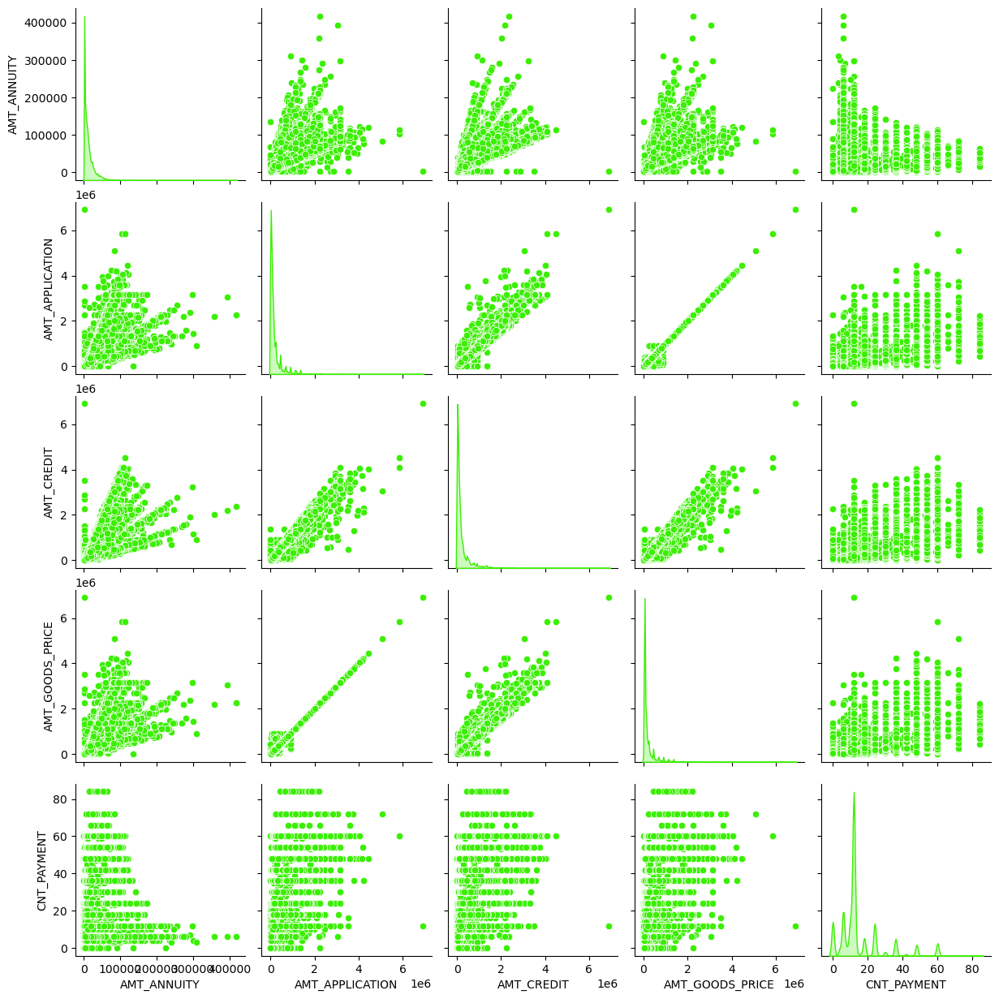

In [81]:
sns.pairplot(df2[conts2], diag_kind='kde', palette=['red', 'green'])
plt.show()

In [82]:
objects2= [k for (k, v) in df2.dtypes.to_dict().items() if v == 'object']
objects2
for i in ['FLAG_LAST_APPL_PER_CONTRACT','WEEKDAY_APPR_PROCESS_START','NAME_SELLER_INDUSTRY']:
    objects2.remove(i)

<Figure size 1800x600 with 0 Axes>

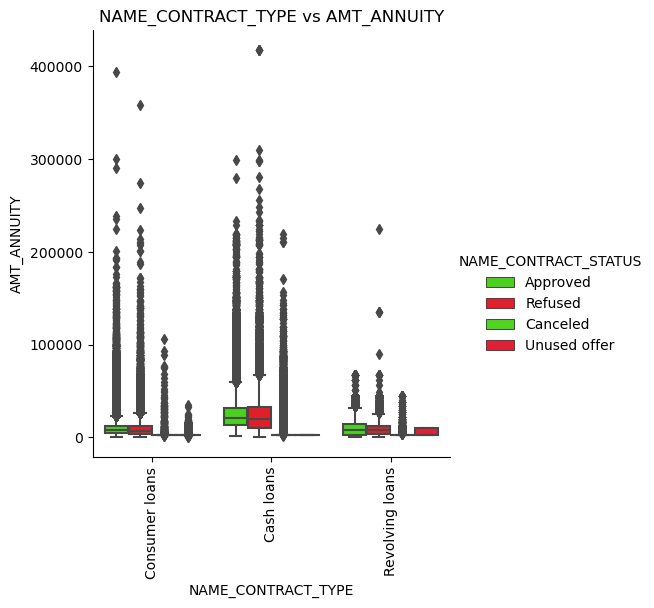

<Figure size 1800x600 with 0 Axes>

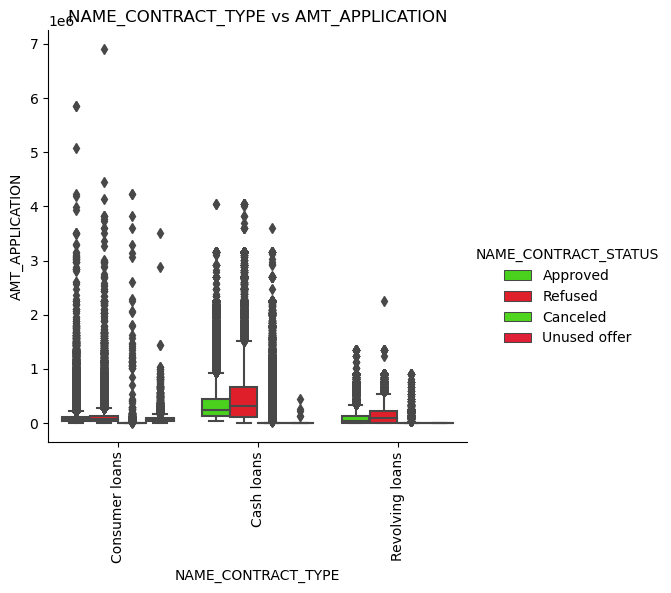

<Figure size 1800x600 with 0 Axes>

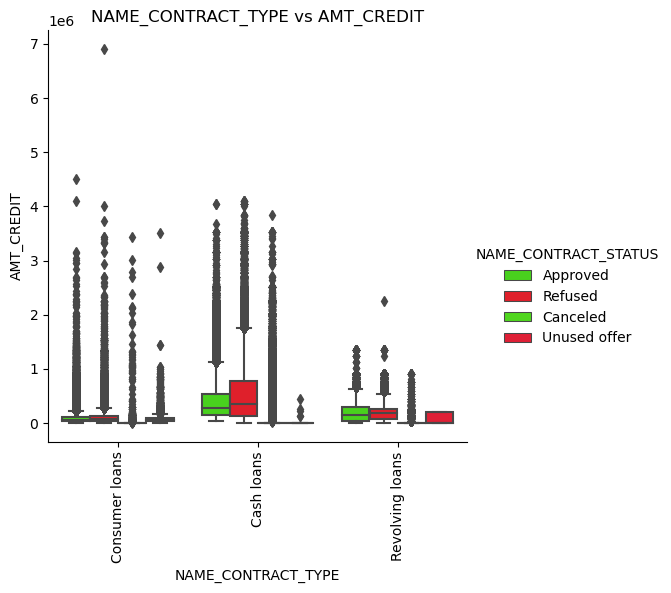

<Figure size 1800x600 with 0 Axes>

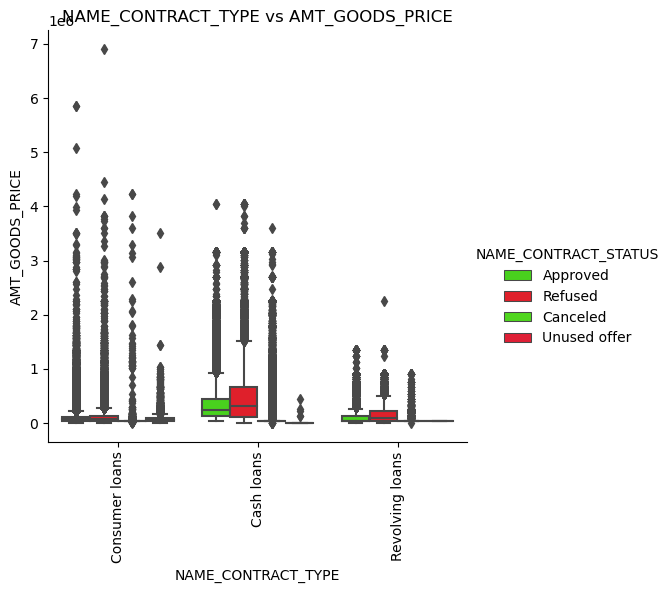

<Figure size 1800x600 with 0 Axes>

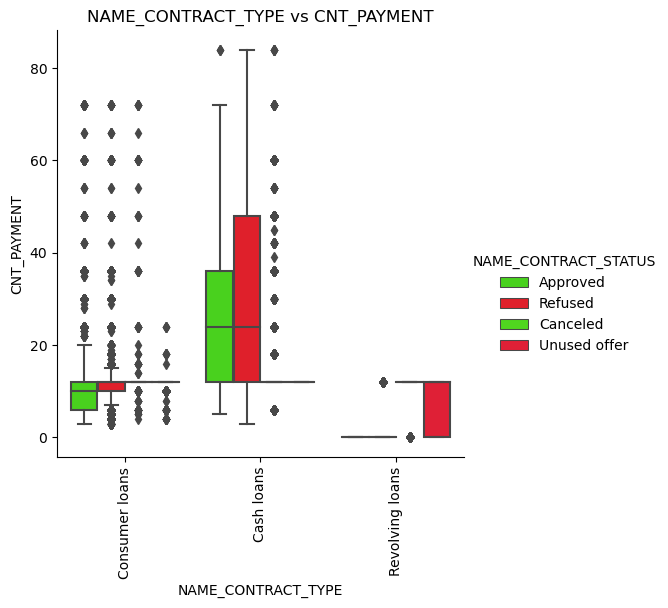

<Figure size 1800x600 with 0 Axes>

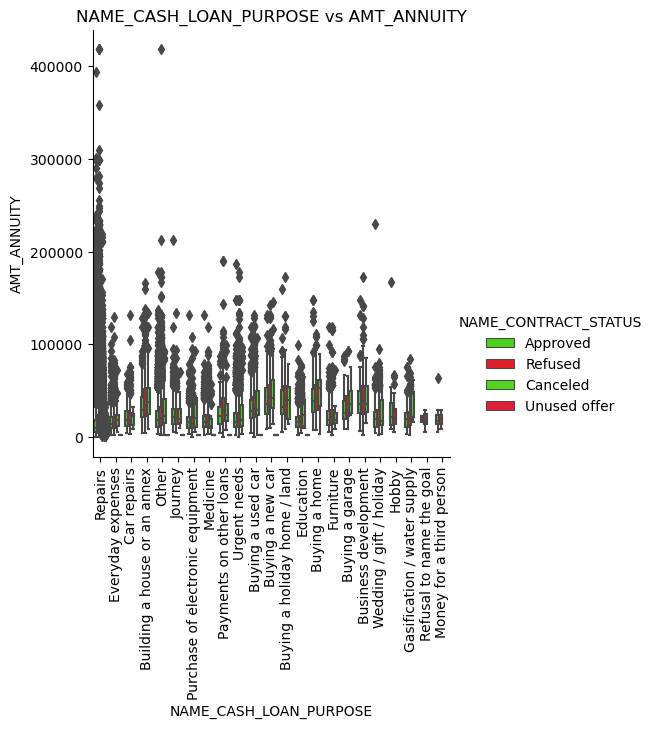

<Figure size 1800x600 with 0 Axes>

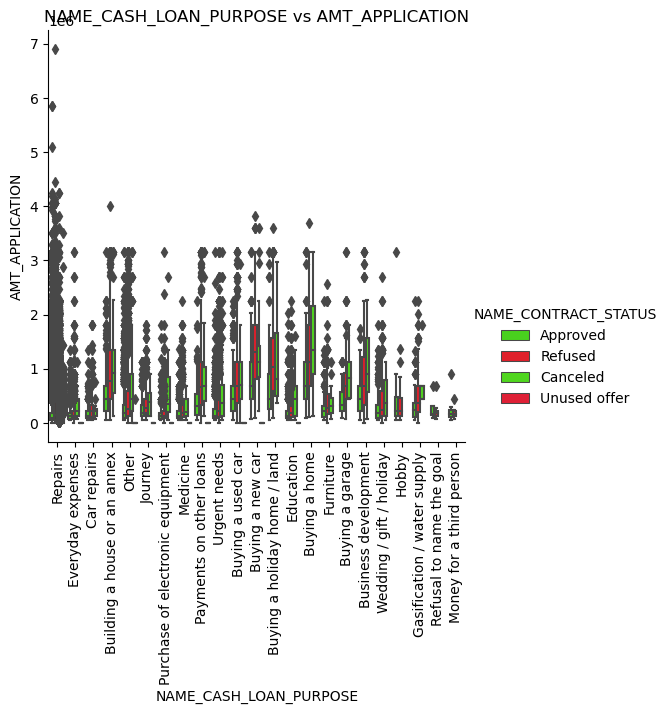

<Figure size 1800x600 with 0 Axes>

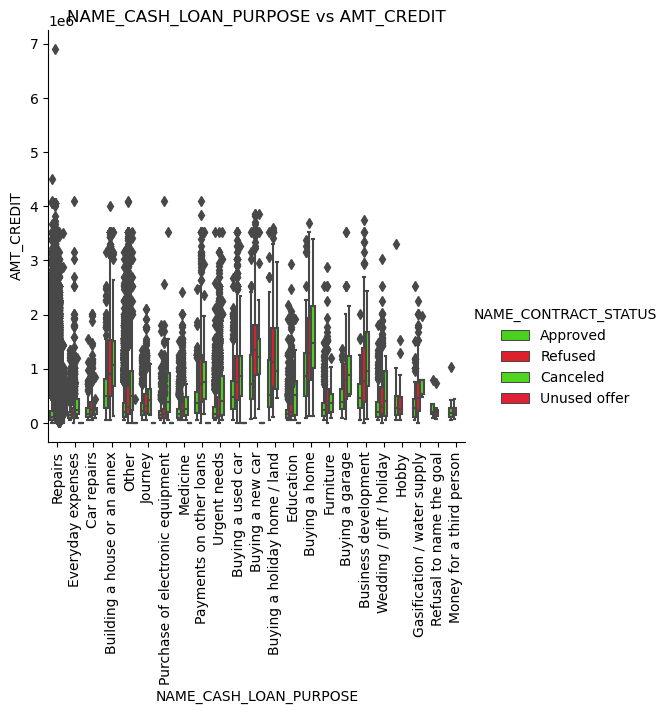

<Figure size 1800x600 with 0 Axes>

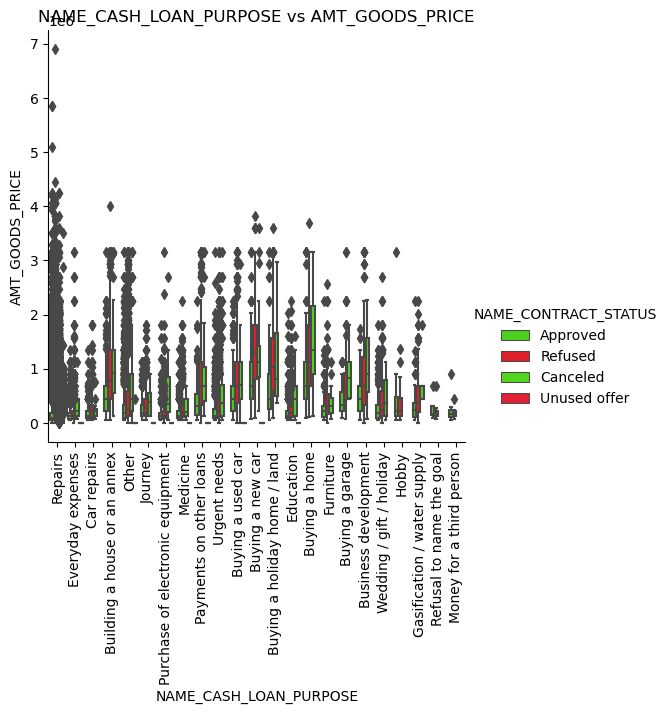

<Figure size 1800x600 with 0 Axes>

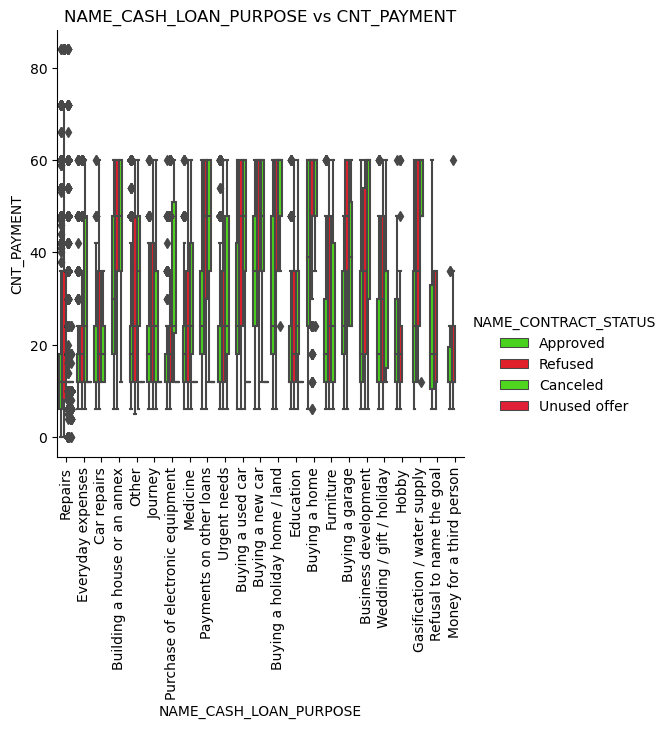

<Figure size 1800x600 with 0 Axes>

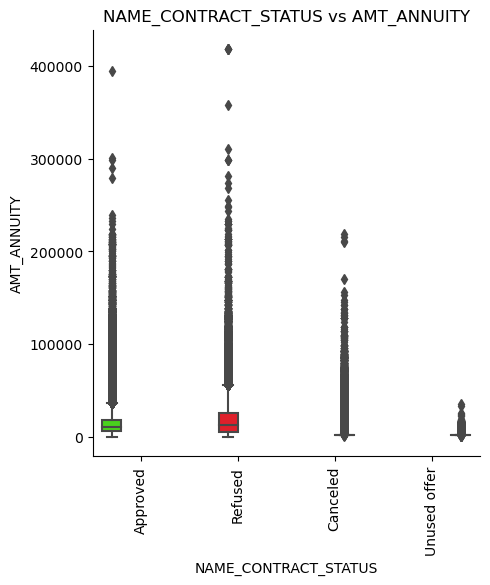

<Figure size 1800x600 with 0 Axes>

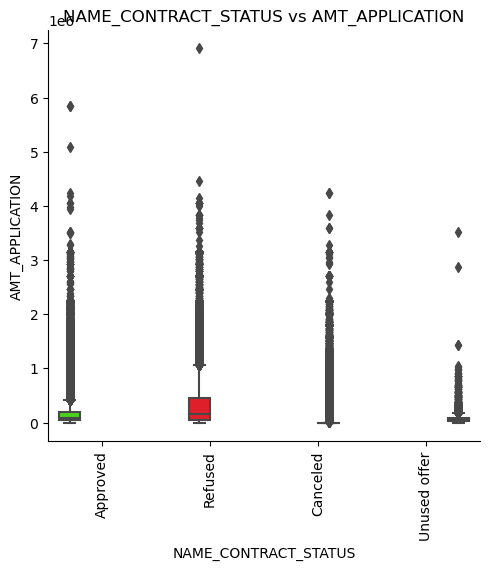

<Figure size 1800x600 with 0 Axes>

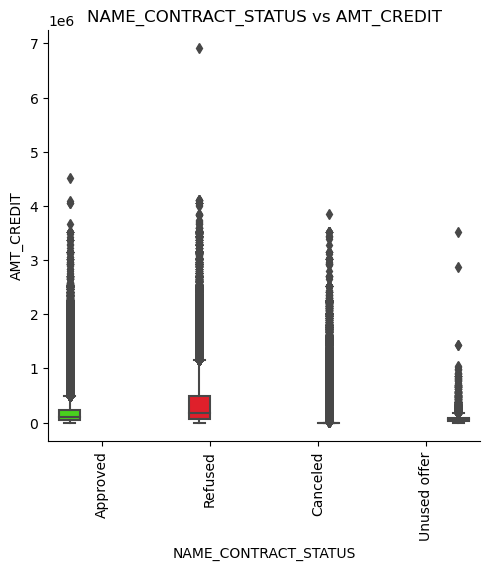

<Figure size 1800x600 with 0 Axes>

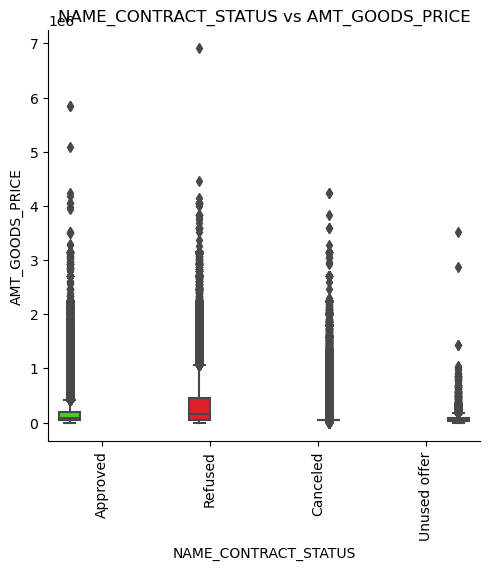

<Figure size 1800x600 with 0 Axes>

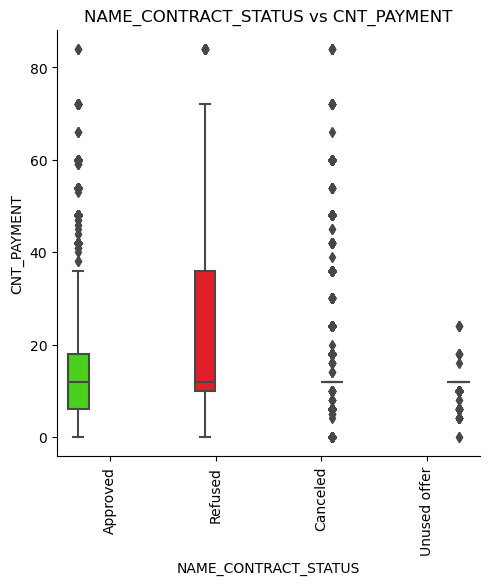

<Figure size 1800x600 with 0 Axes>

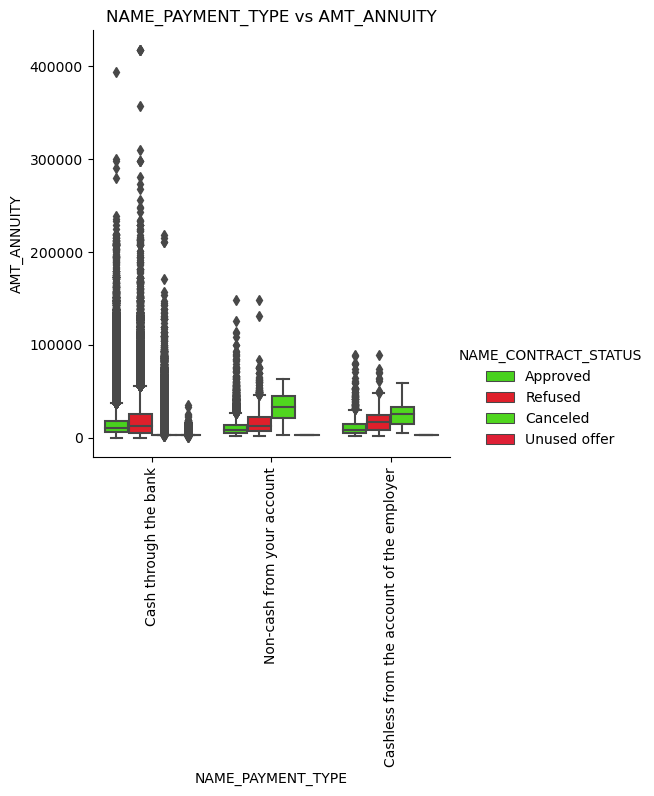

<Figure size 1800x600 with 0 Axes>

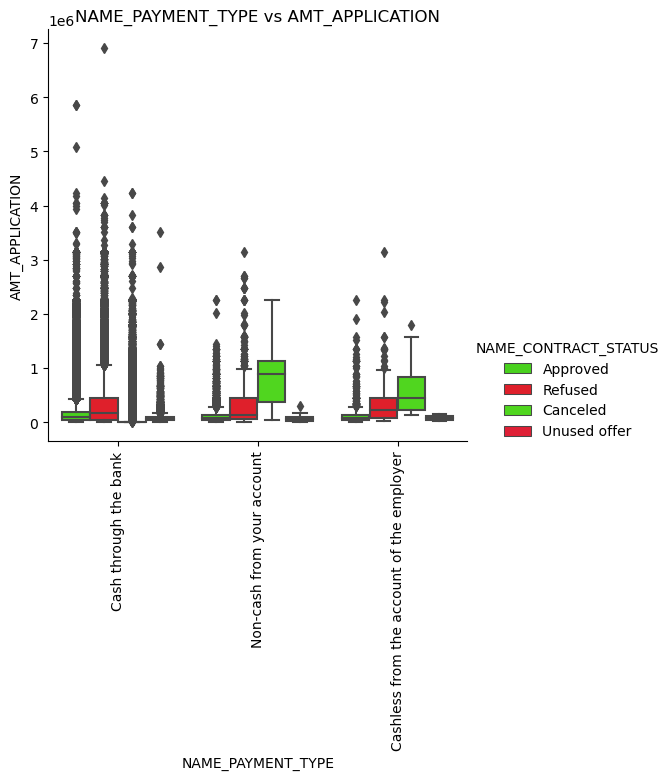

<Figure size 1800x600 with 0 Axes>

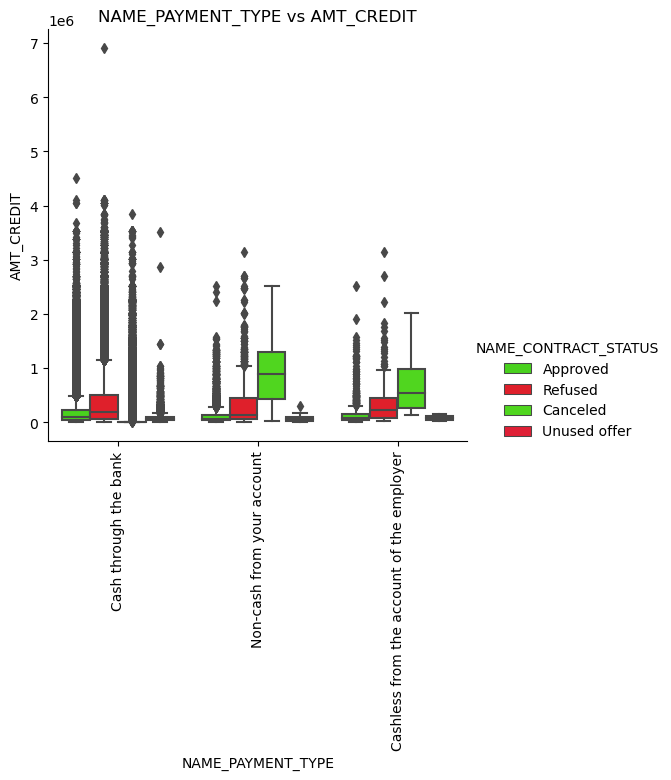

<Figure size 1800x600 with 0 Axes>

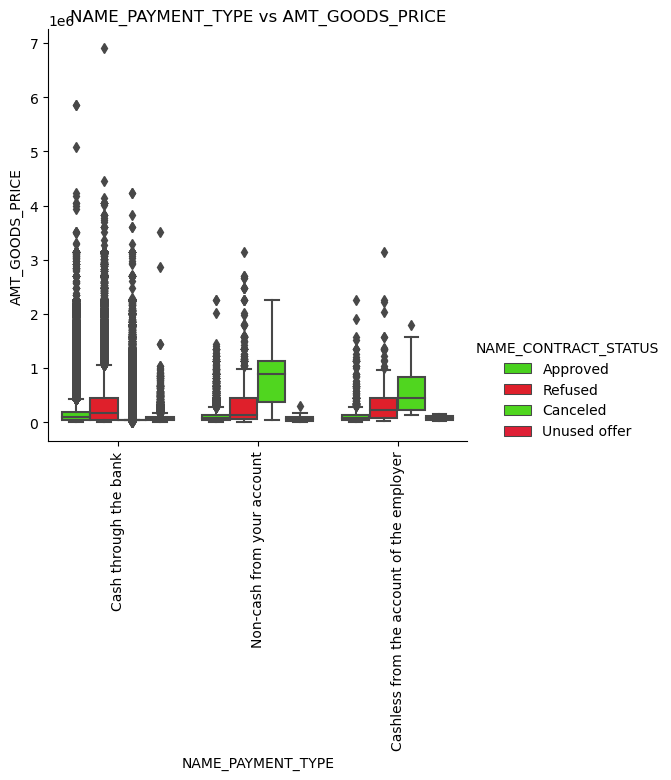

<Figure size 1800x600 with 0 Axes>

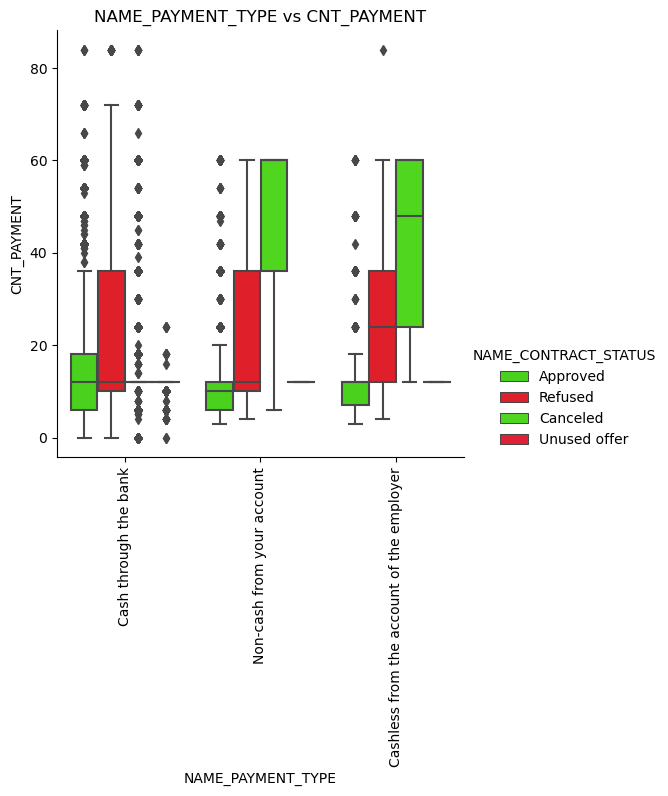

<Figure size 1800x600 with 0 Axes>

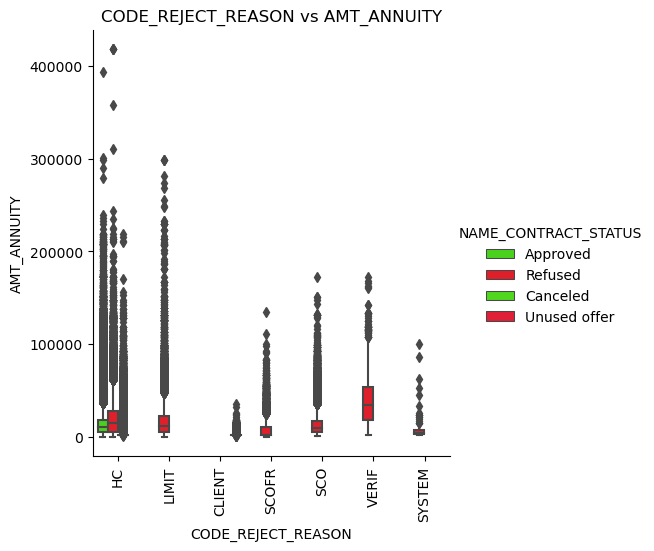

<Figure size 1800x600 with 0 Axes>

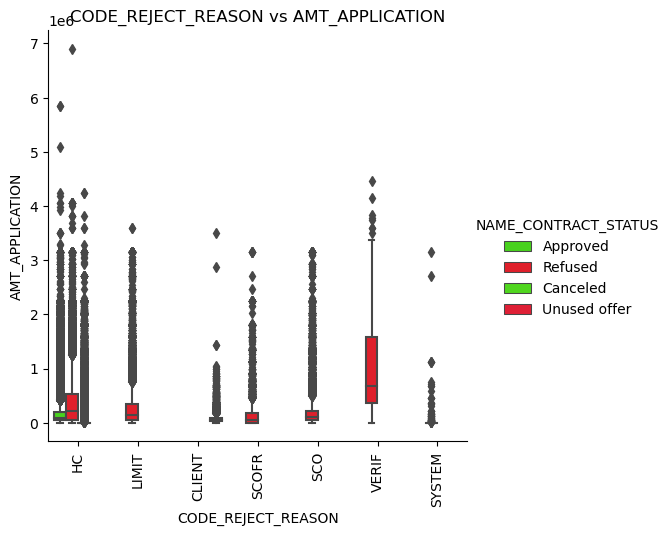

<Figure size 1800x600 with 0 Axes>

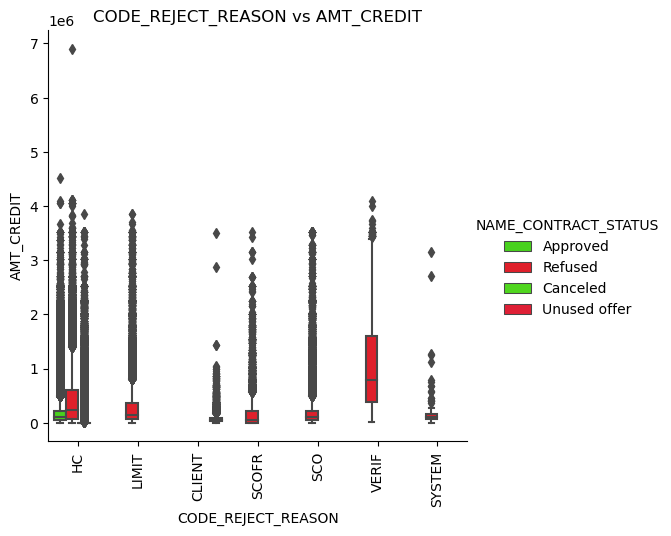

<Figure size 1800x600 with 0 Axes>

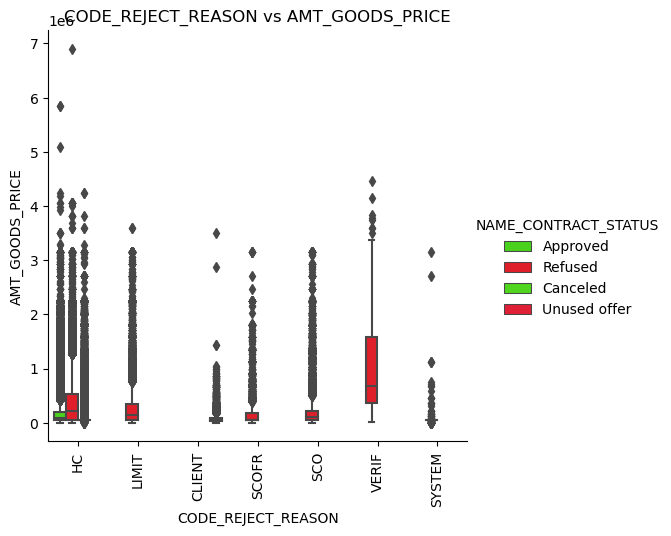

<Figure size 1800x600 with 0 Axes>

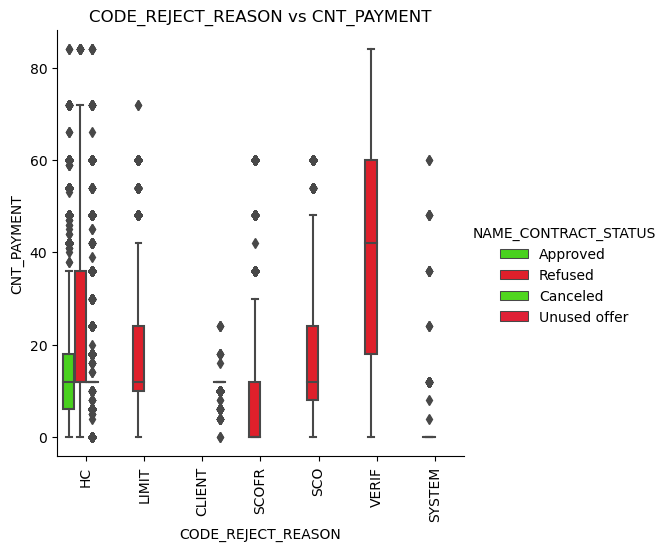

<Figure size 1800x600 with 0 Axes>

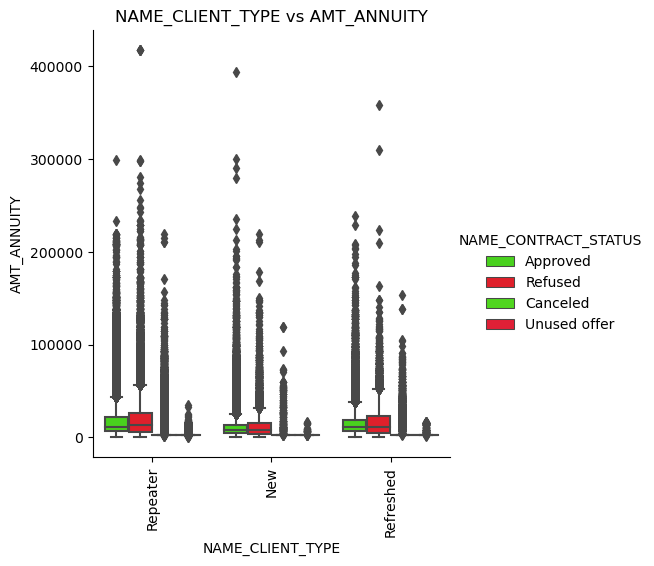

<Figure size 1800x600 with 0 Axes>

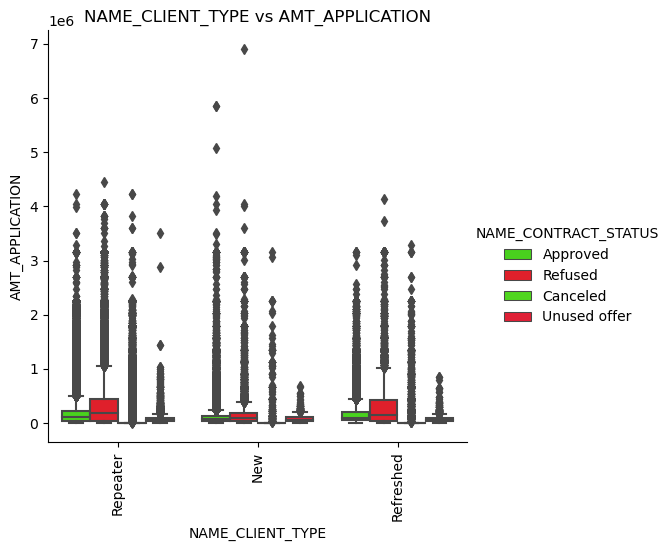

<Figure size 1800x600 with 0 Axes>

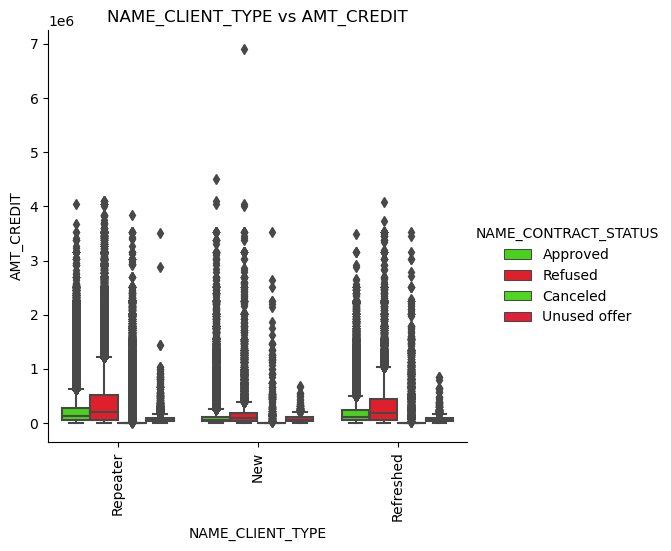

<Figure size 1800x600 with 0 Axes>

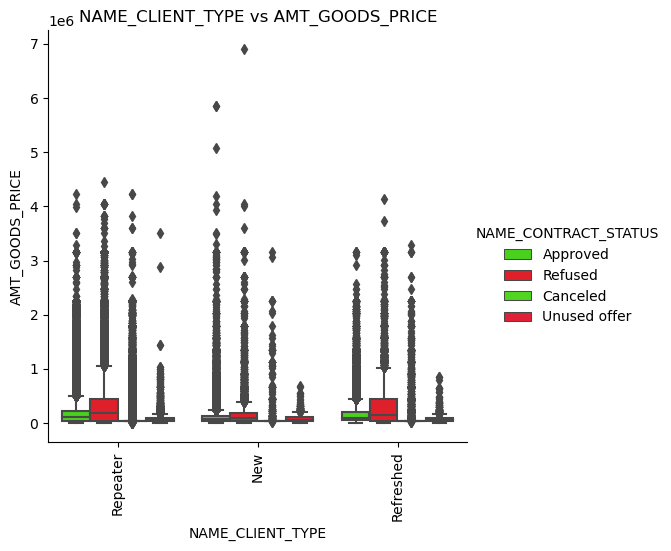

<Figure size 1800x600 with 0 Axes>

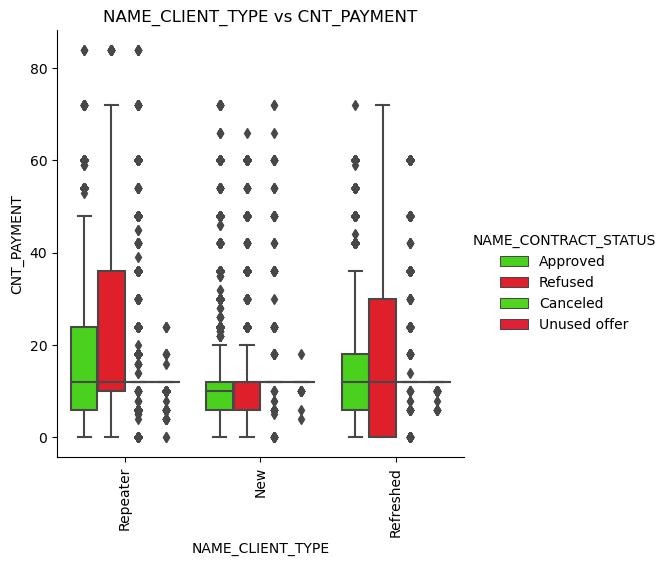

<Figure size 1800x600 with 0 Axes>

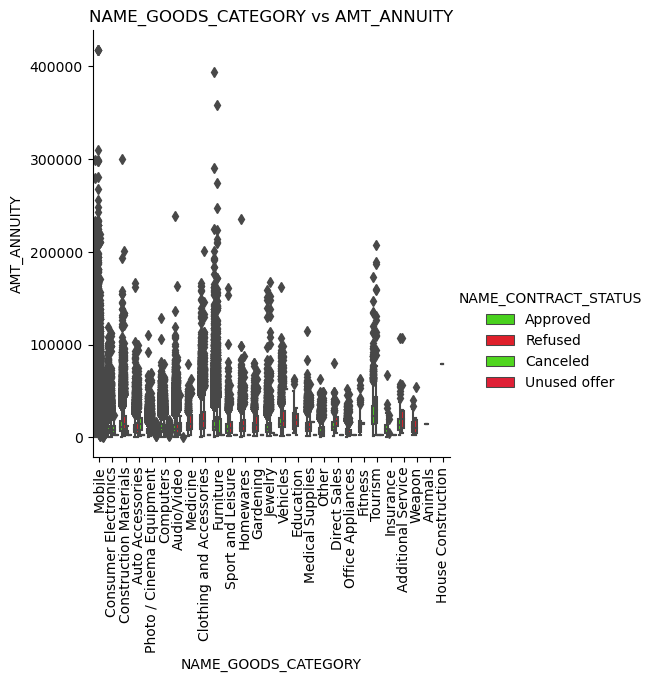

<Figure size 1800x600 with 0 Axes>

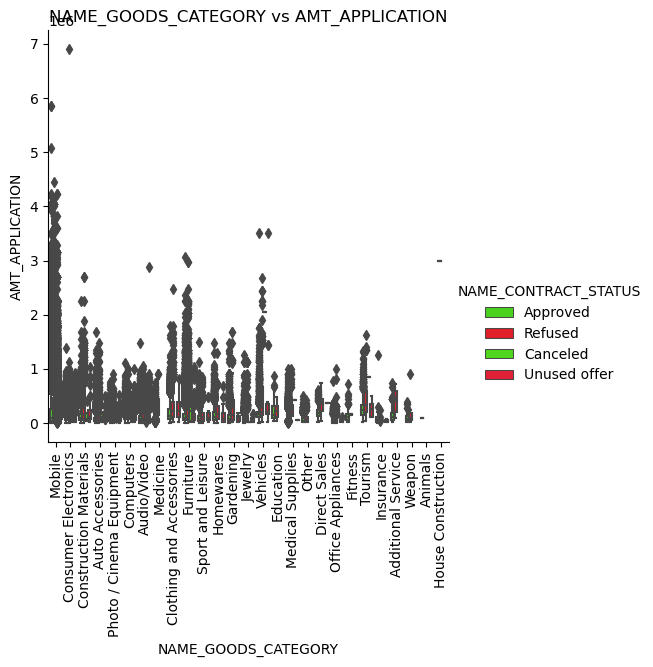

<Figure size 1800x600 with 0 Axes>

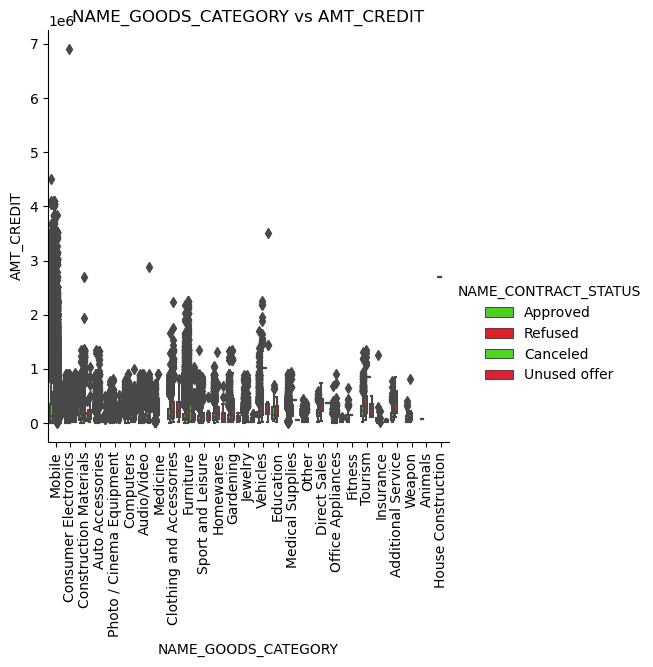

<Figure size 1800x600 with 0 Axes>

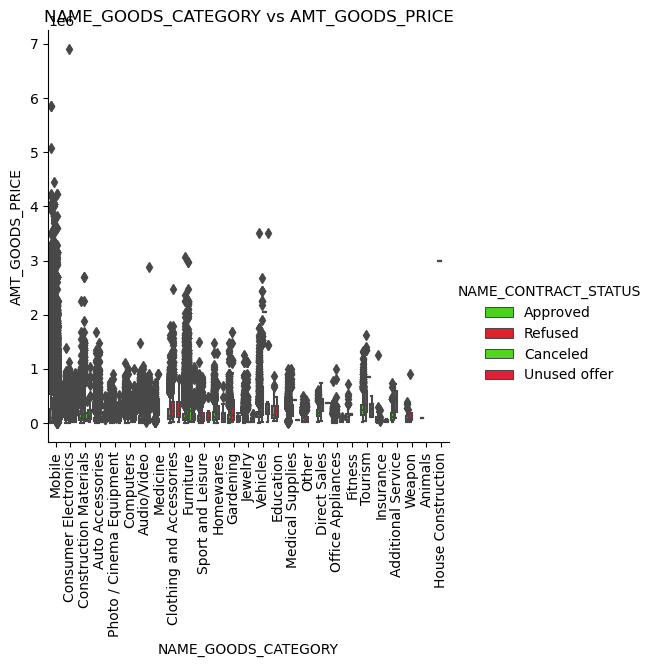

<Figure size 1800x600 with 0 Axes>

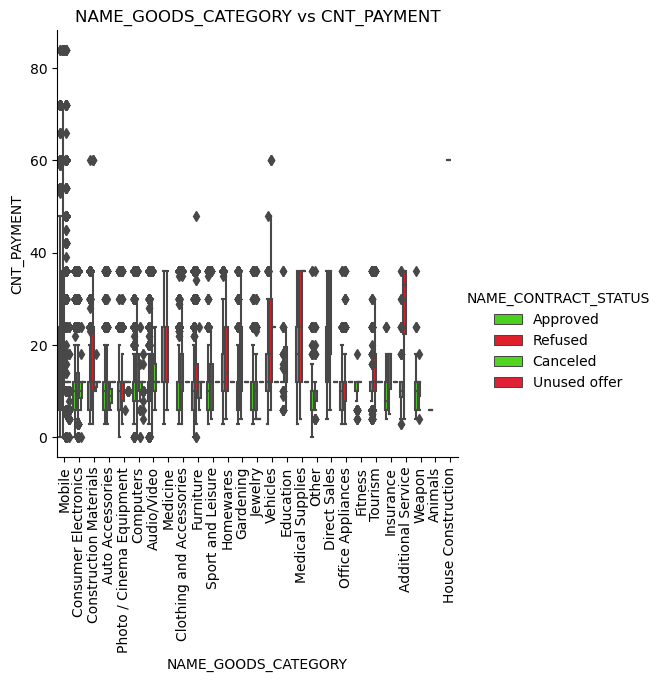

<Figure size 1800x600 with 0 Axes>

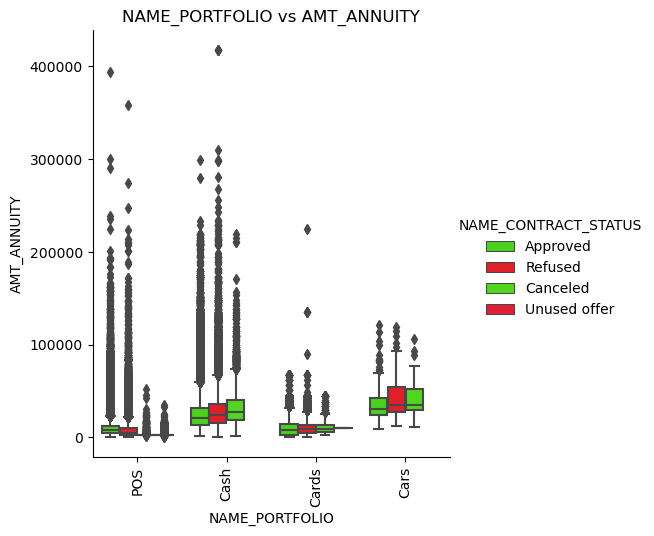

<Figure size 1800x600 with 0 Axes>

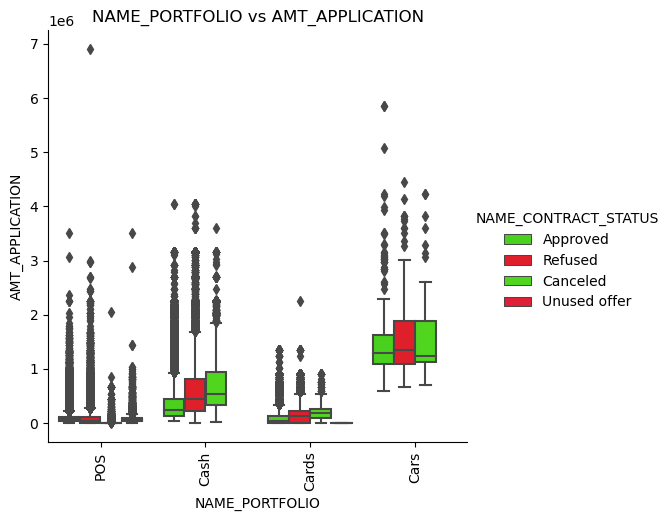

<Figure size 1800x600 with 0 Axes>

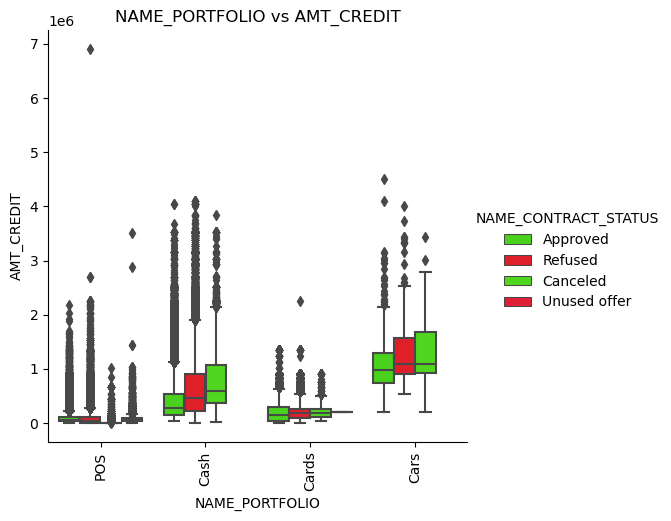

<Figure size 1800x600 with 0 Axes>

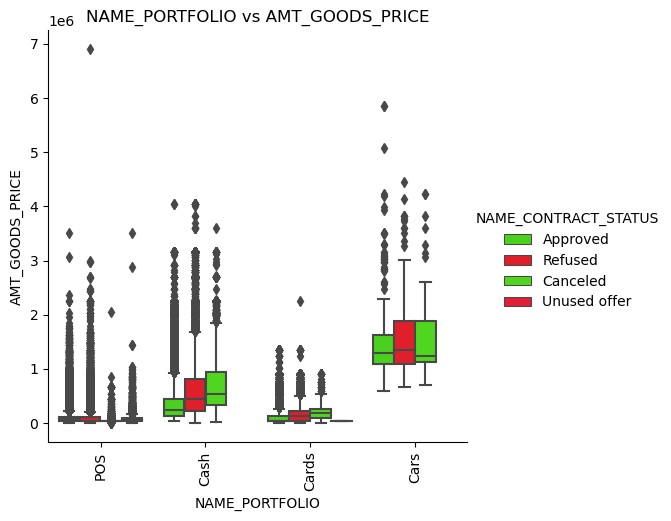

<Figure size 1800x600 with 0 Axes>

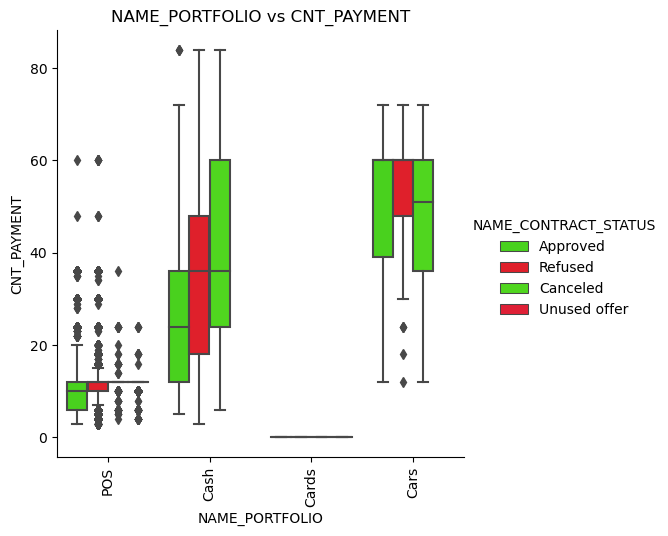

<Figure size 1800x600 with 0 Axes>

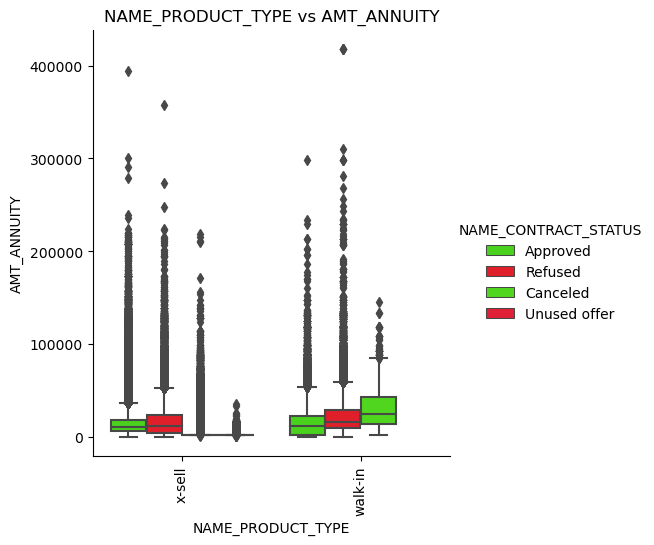

<Figure size 1800x600 with 0 Axes>

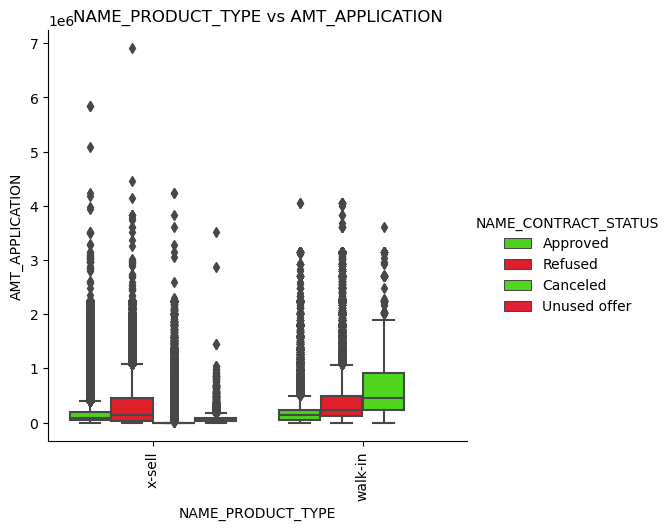

<Figure size 1800x600 with 0 Axes>

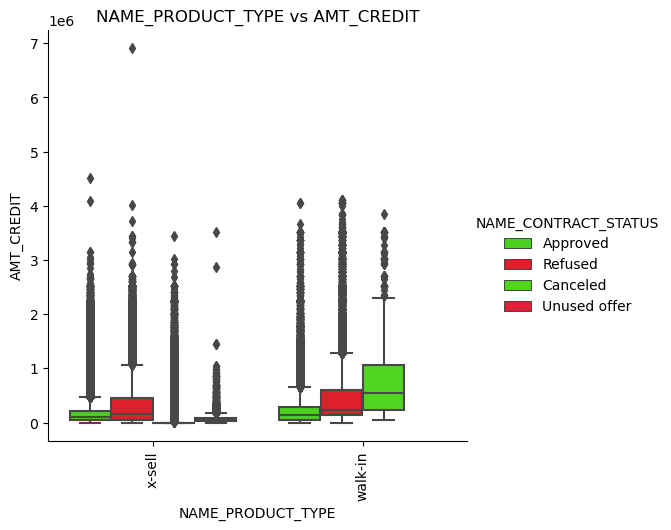

<Figure size 1800x600 with 0 Axes>

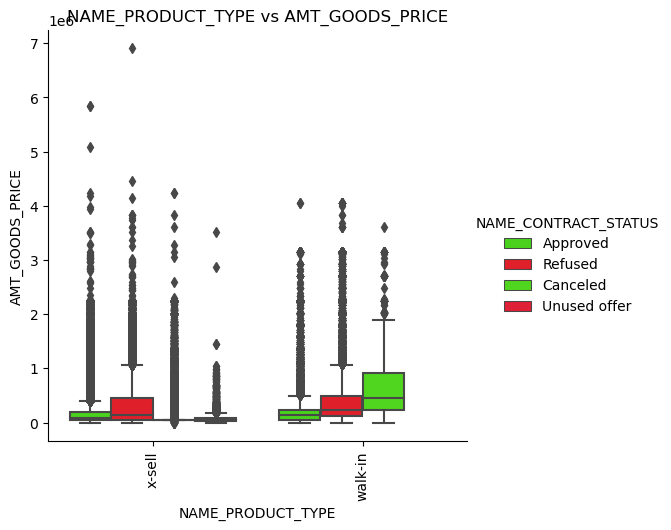

<Figure size 1800x600 with 0 Axes>

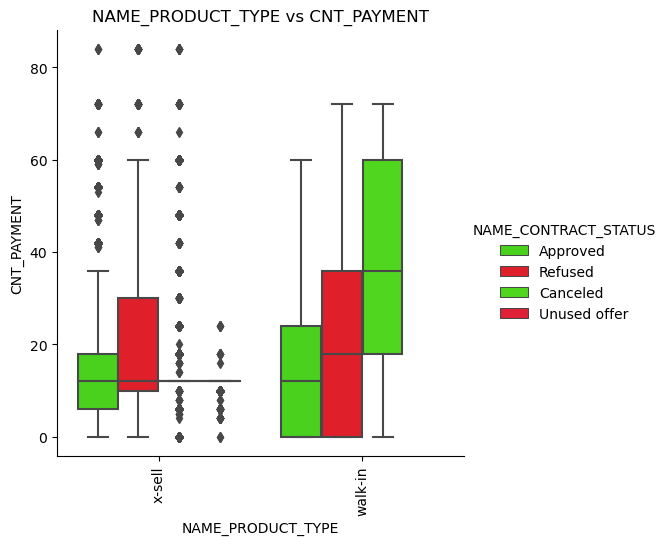

<Figure size 1800x600 with 0 Axes>

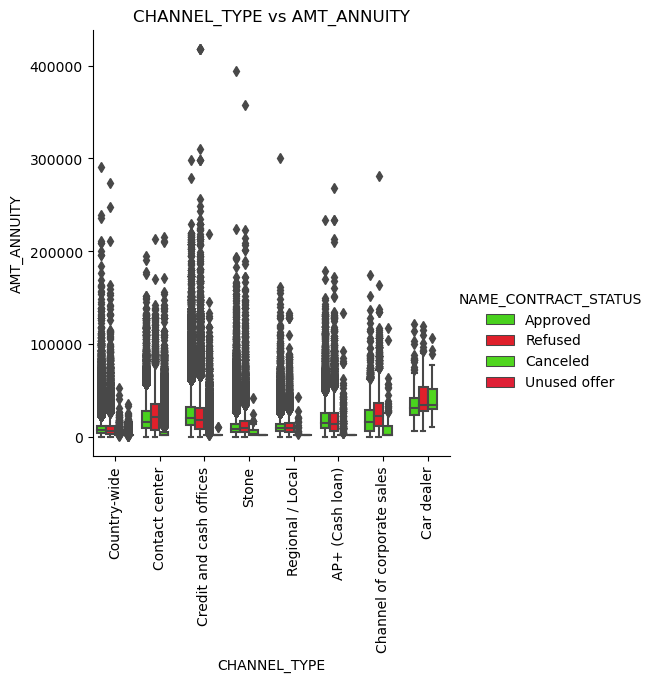

<Figure size 1800x600 with 0 Axes>

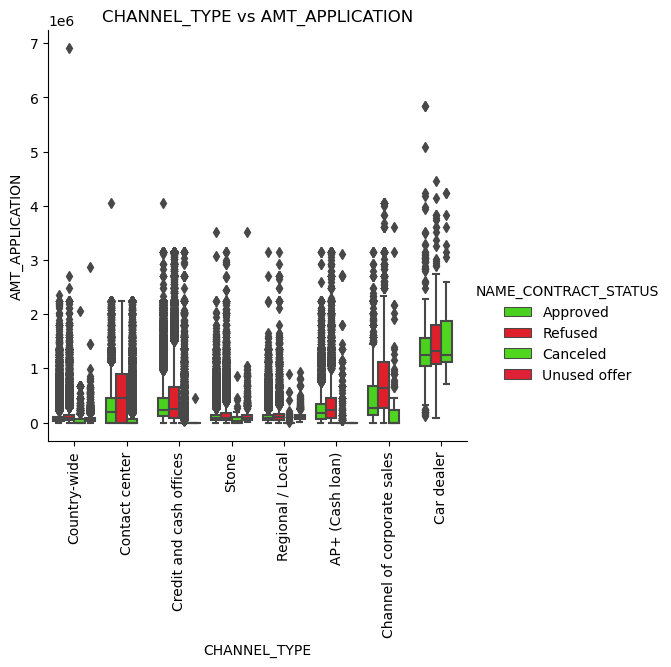

<Figure size 1800x600 with 0 Axes>

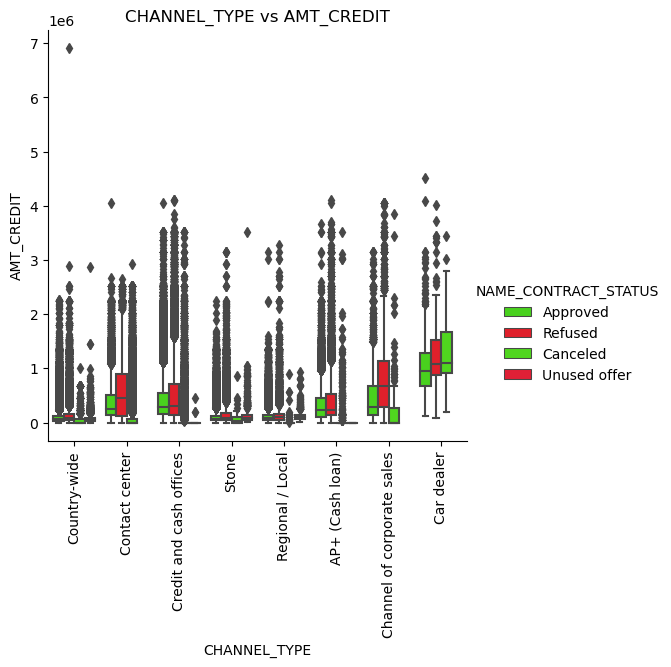

<Figure size 1800x600 with 0 Axes>

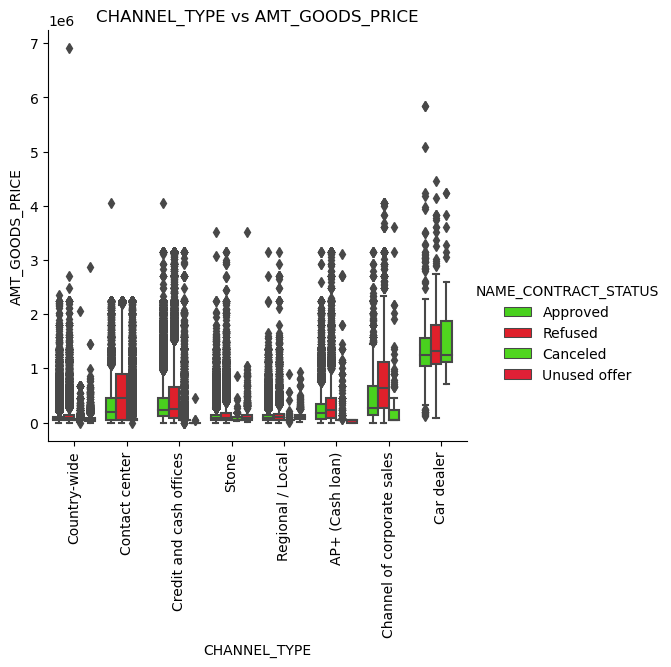

<Figure size 1800x600 with 0 Axes>

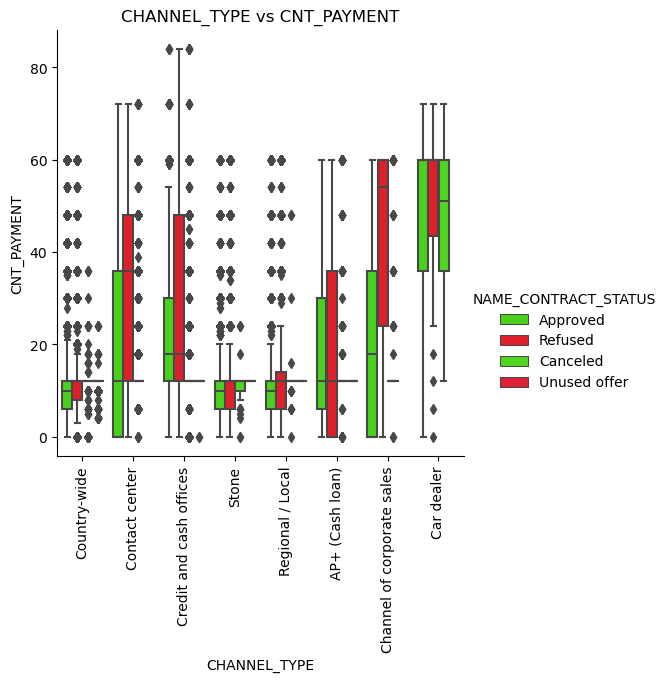

<Figure size 1800x600 with 0 Axes>

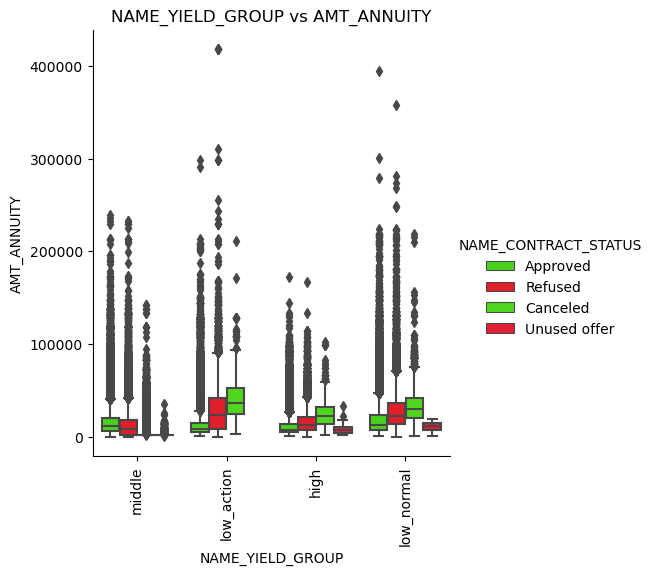

<Figure size 1800x600 with 0 Axes>

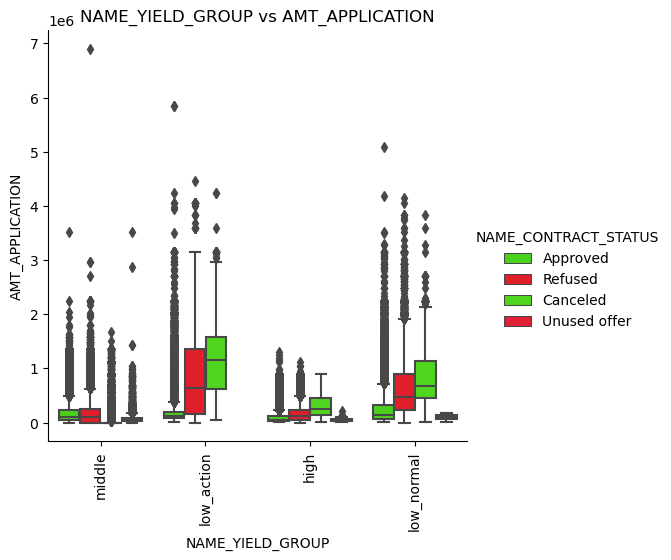

<Figure size 1800x600 with 0 Axes>

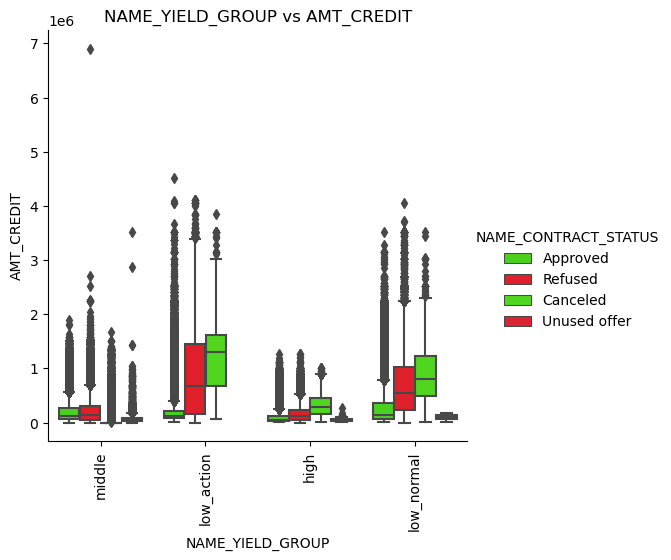

<Figure size 1800x600 with 0 Axes>

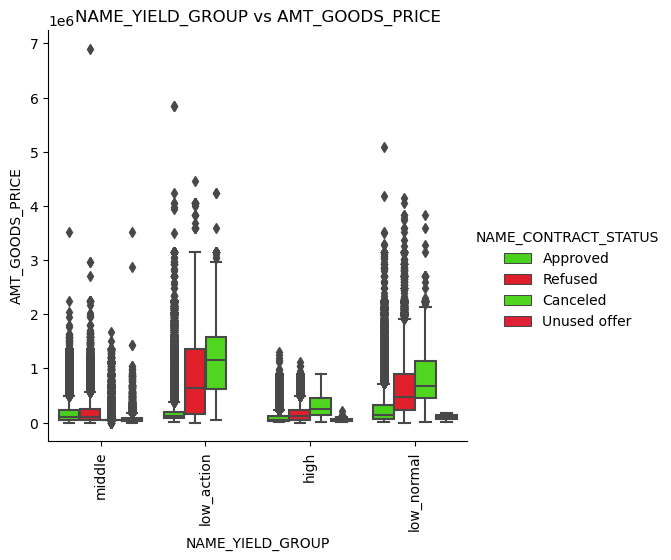

<Figure size 1800x600 with 0 Axes>

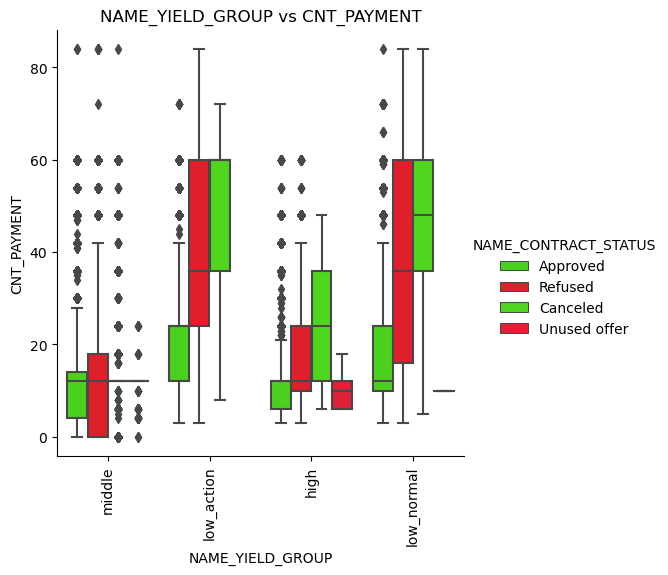

<Figure size 1800x600 with 0 Axes>

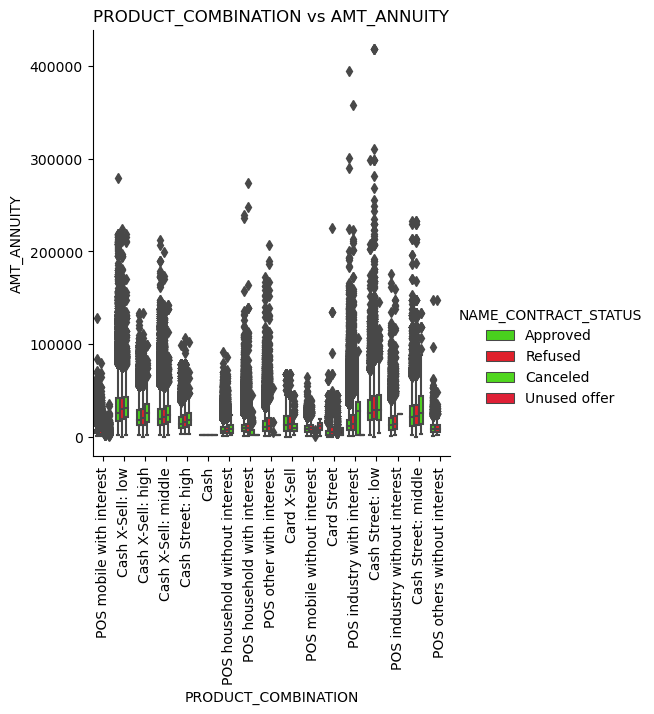

<Figure size 1800x600 with 0 Axes>

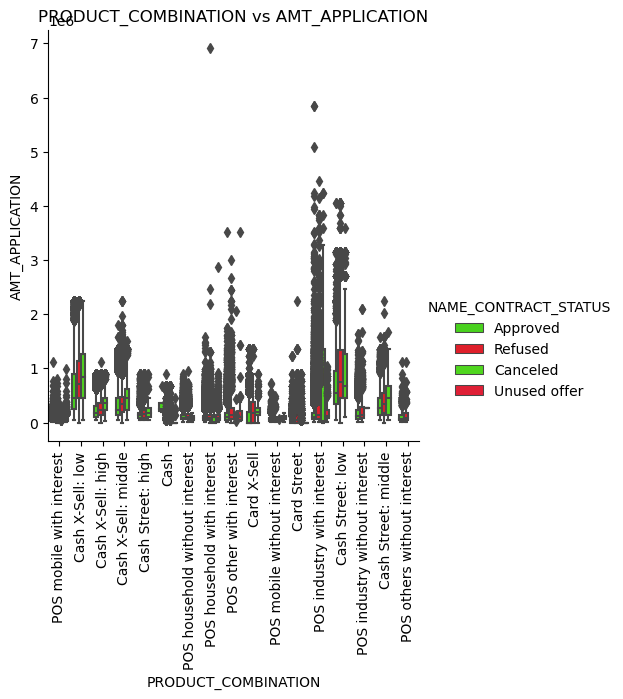

<Figure size 1800x600 with 0 Axes>

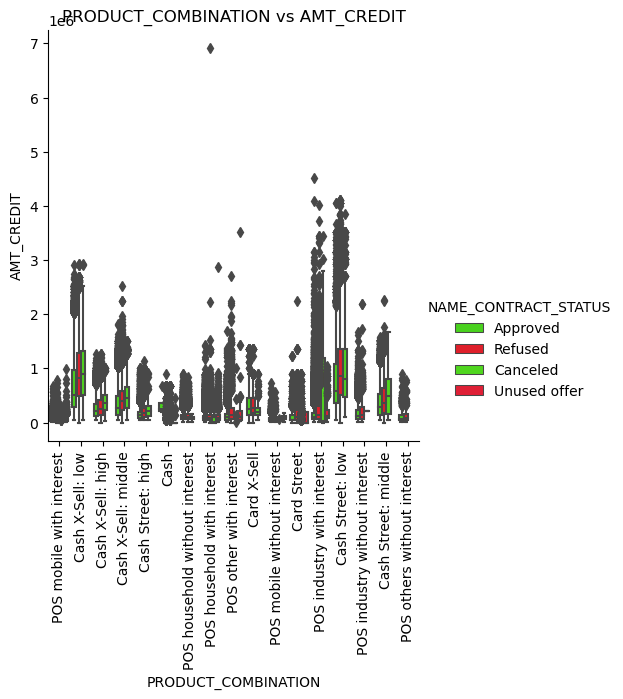

<Figure size 1800x600 with 0 Axes>

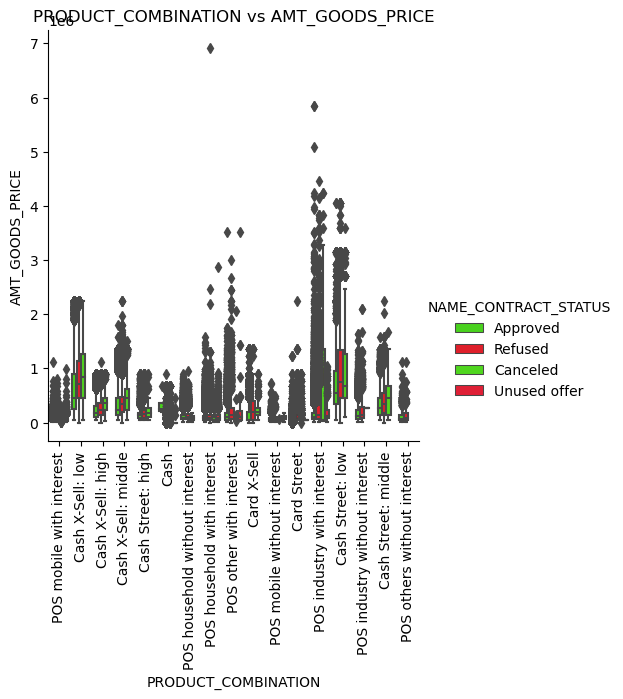

<Figure size 1800x600 with 0 Axes>

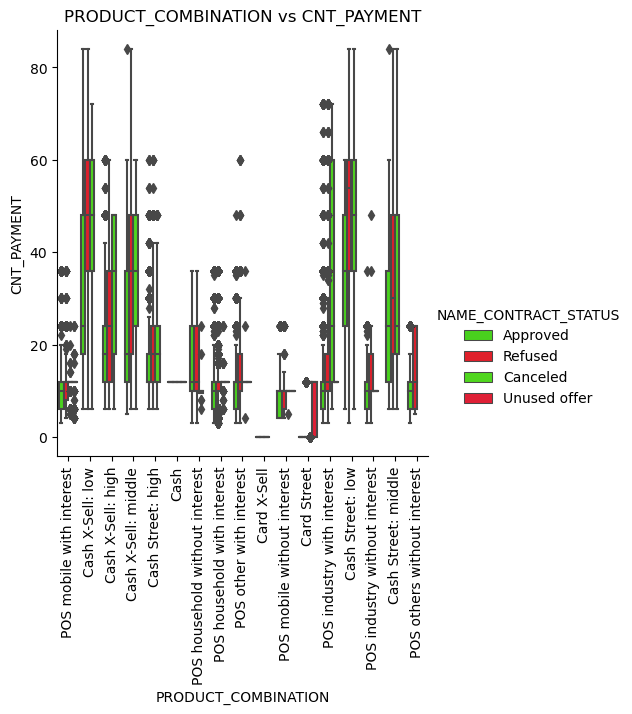

In [83]:
for obj_col in objects2:
    for num_col in conts2:
        plt.figure(figsize=(18, 6))
        sns.catplot(x=obj_col, y=num_col, data=df2, kind='box',hue='NAME_CONTRACT_STATUS')
        plt.title(f"{obj_col} vs {num_col}")
        plt.xticks(rotation=90)
        plt.xlabel(obj_col)
        plt.ylabel(num_col)
        plt.show()

### Categorical - Categorical

<Figure size 1200x400 with 0 Axes>

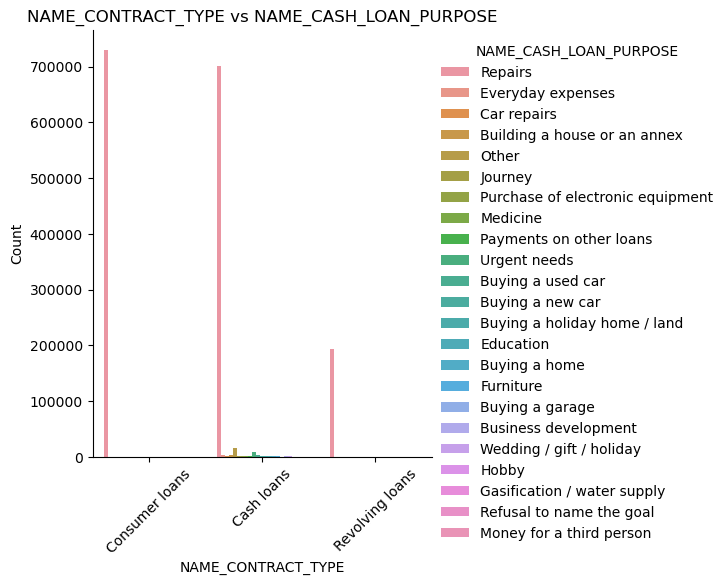

<Figure size 1200x400 with 0 Axes>

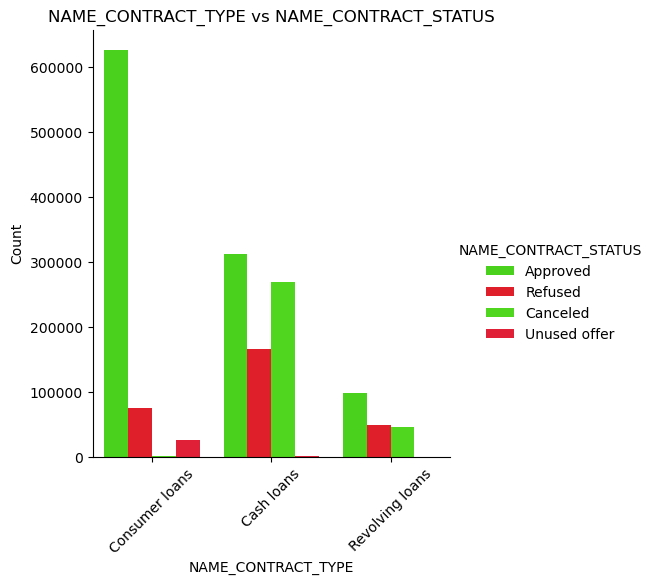

<Figure size 1200x400 with 0 Axes>

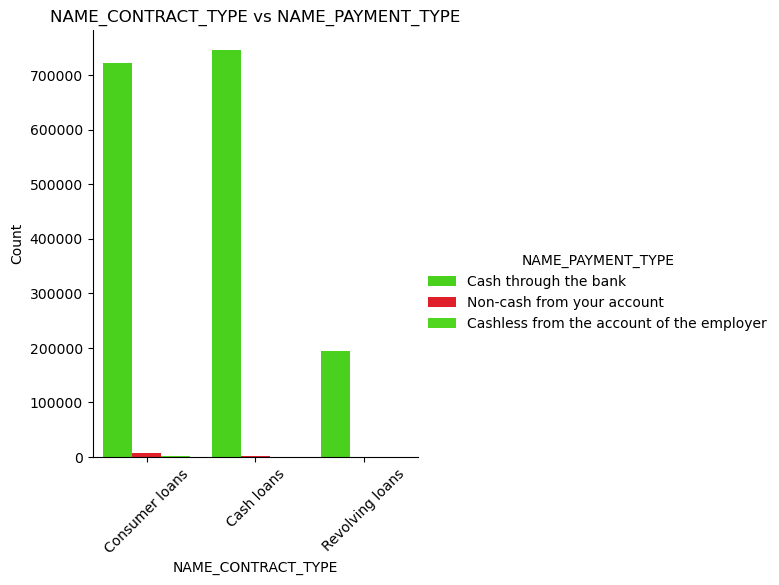

<Figure size 1200x400 with 0 Axes>

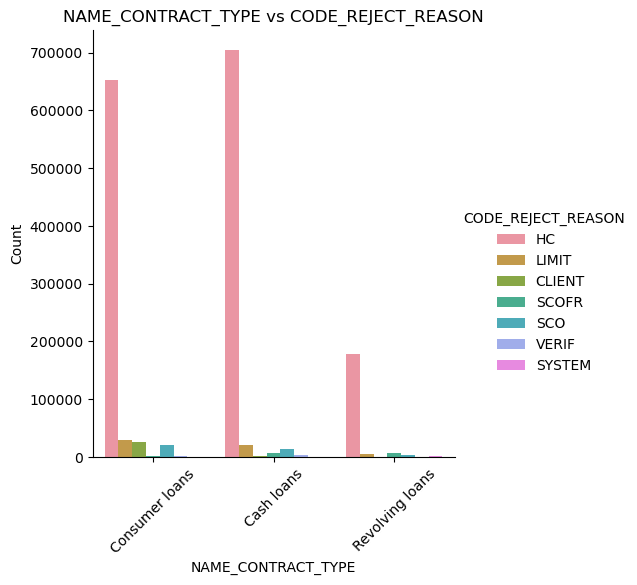

<Figure size 1200x400 with 0 Axes>

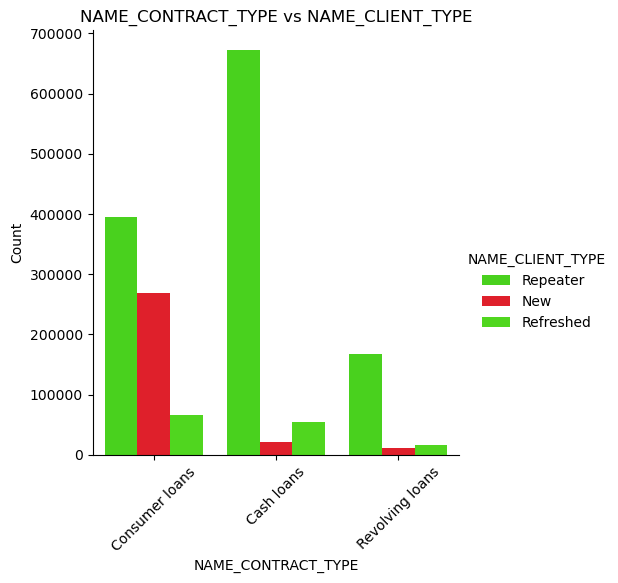

<Figure size 1200x400 with 0 Axes>

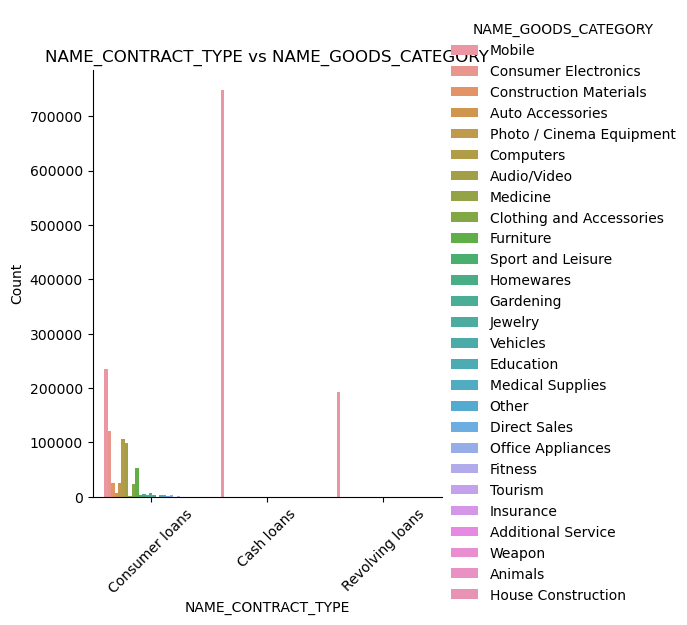

<Figure size 1200x400 with 0 Axes>

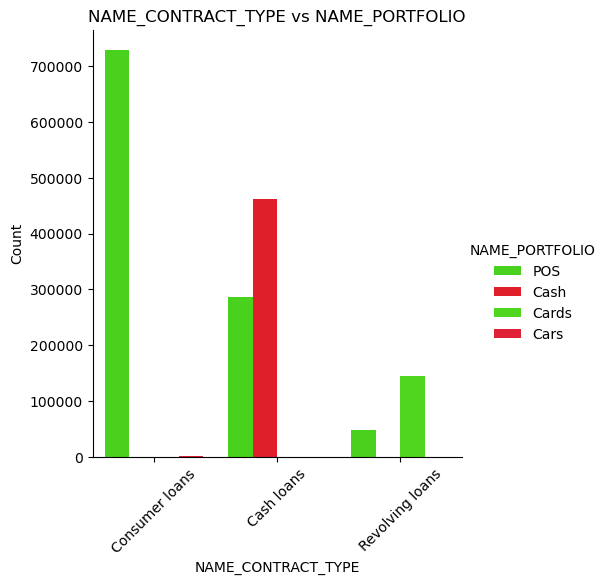

<Figure size 1200x400 with 0 Axes>

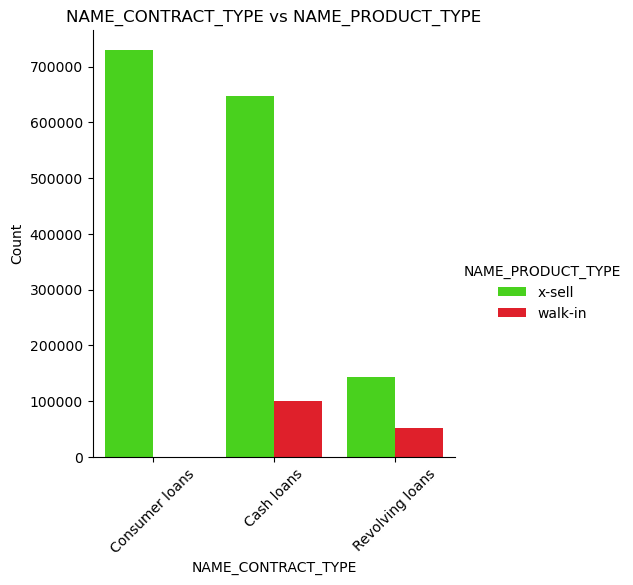

<Figure size 1200x400 with 0 Axes>

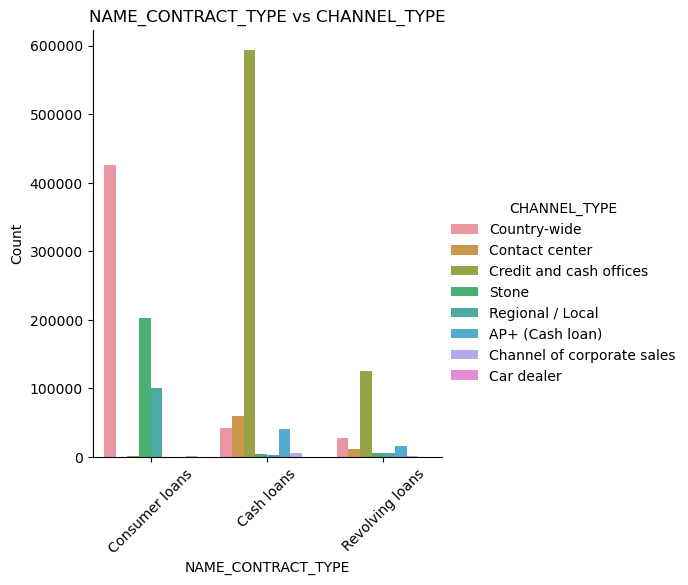

<Figure size 1200x400 with 0 Axes>

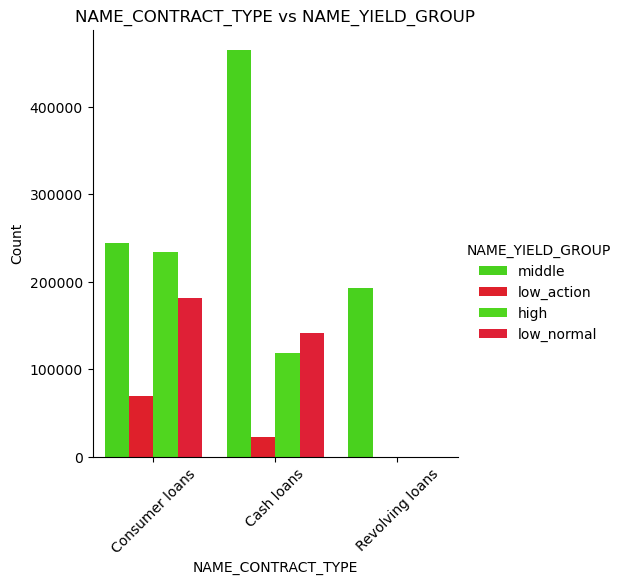

<Figure size 1200x400 with 0 Axes>

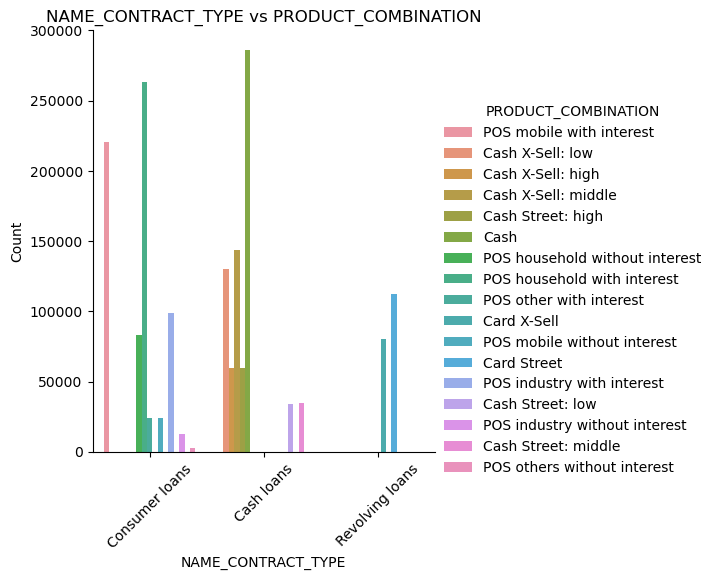

<Figure size 1200x400 with 0 Axes>

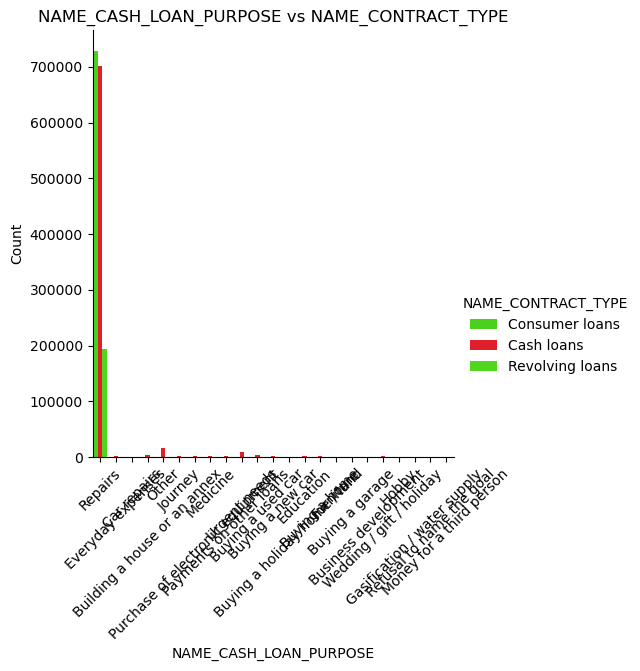

<Figure size 1200x400 with 0 Axes>

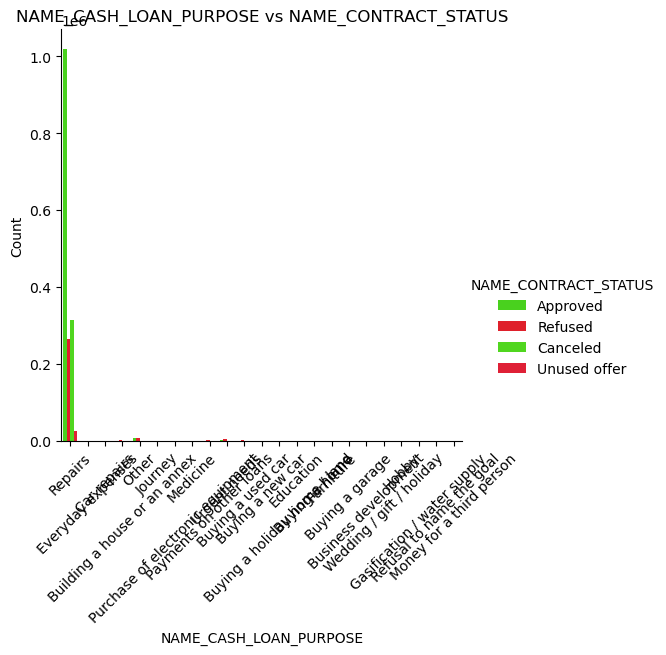

<Figure size 1200x400 with 0 Axes>

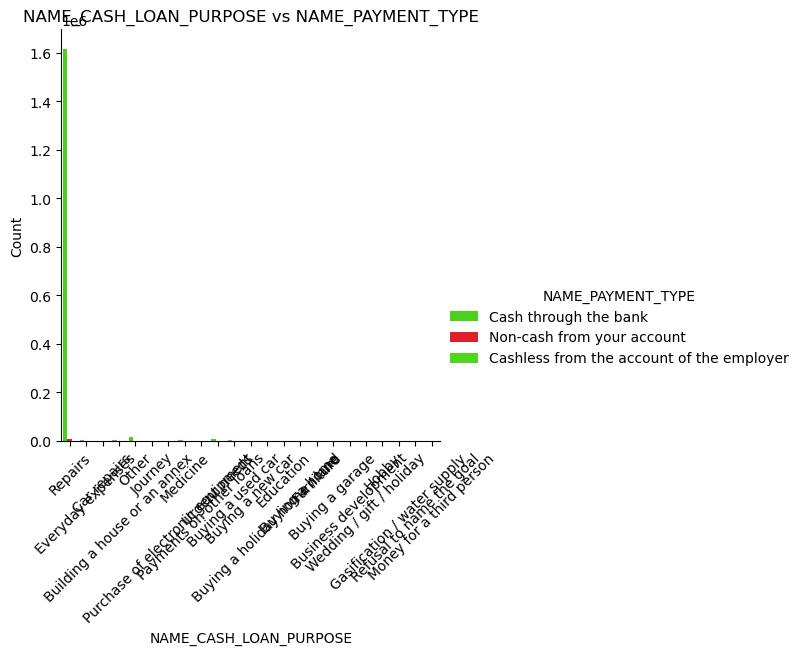

<Figure size 1200x400 with 0 Axes>

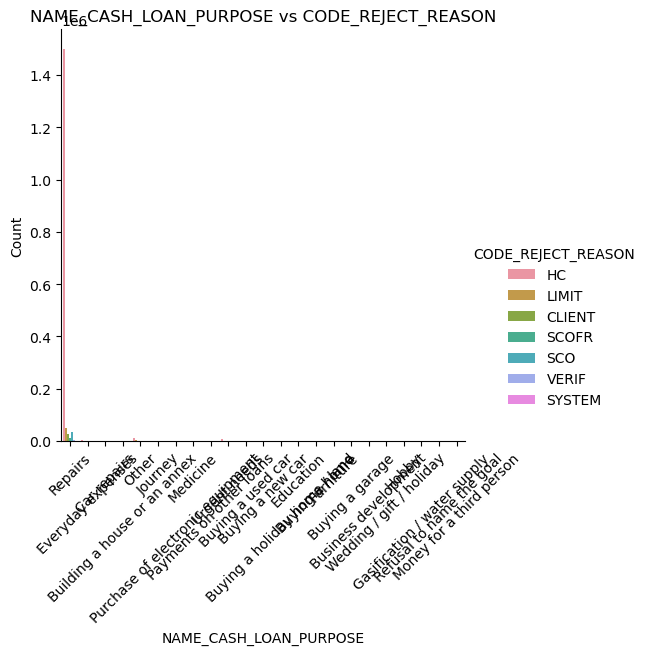

<Figure size 1200x400 with 0 Axes>

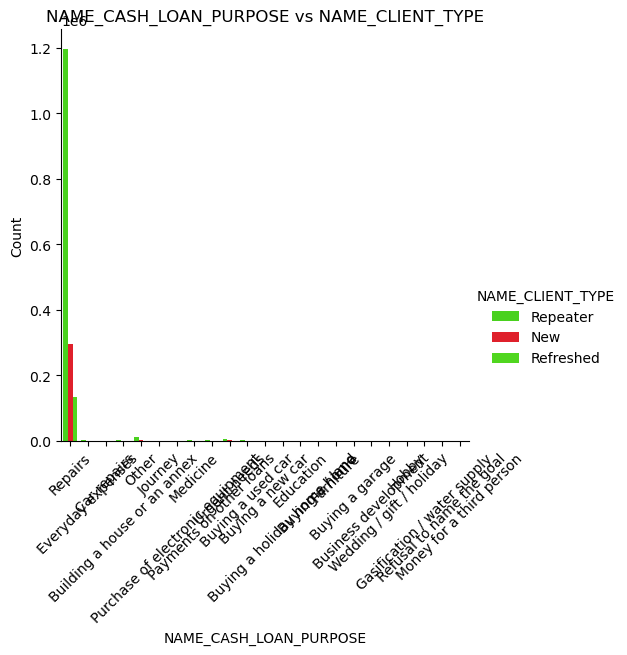

<Figure size 1200x400 with 0 Axes>

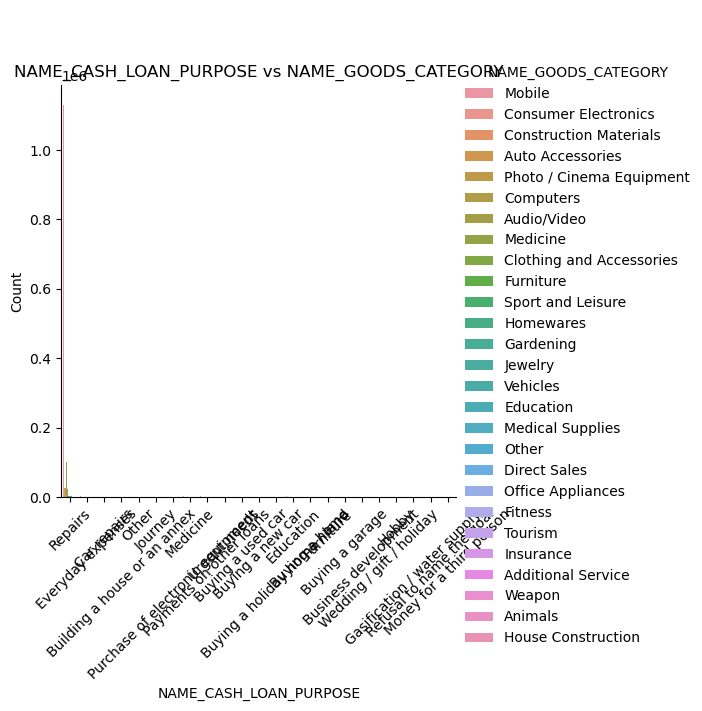

<Figure size 1200x400 with 0 Axes>

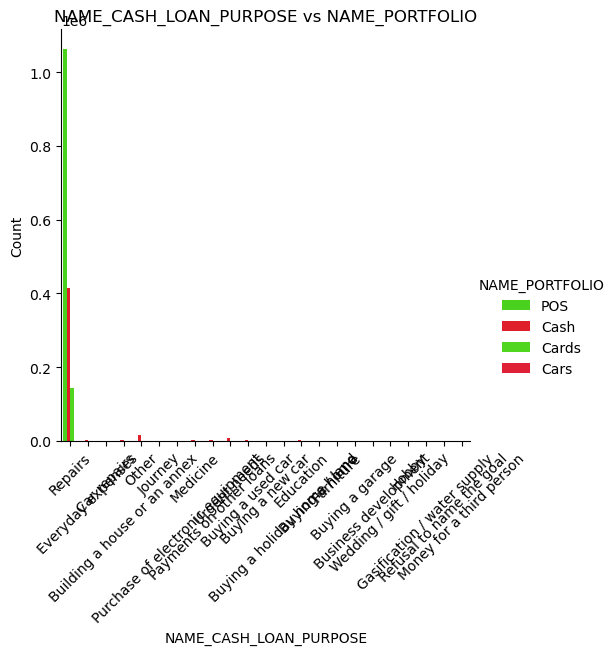

<Figure size 1200x400 with 0 Axes>

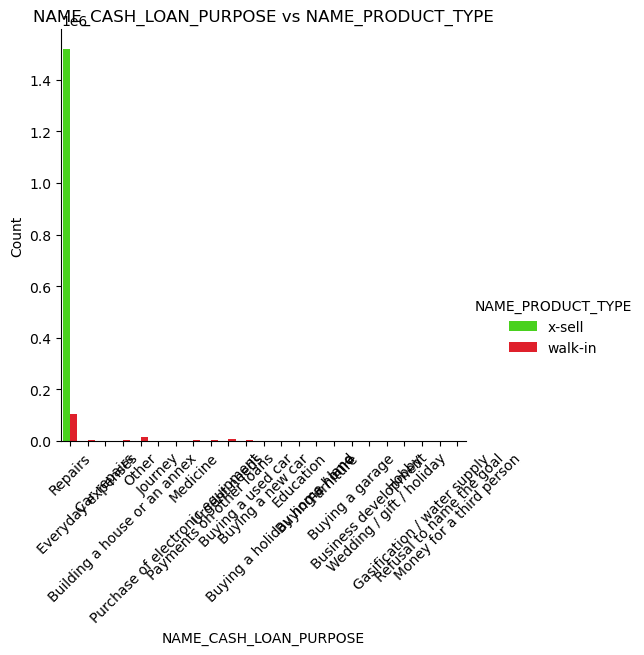

<Figure size 1200x400 with 0 Axes>

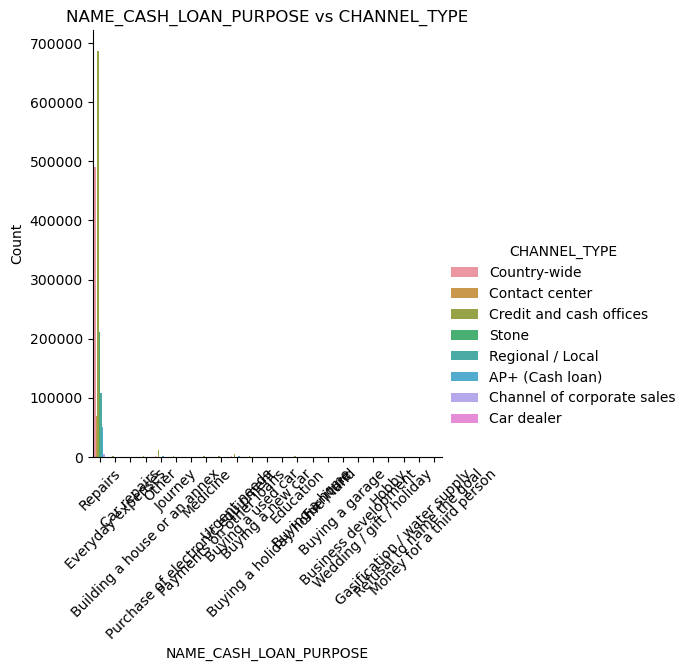

<Figure size 1200x400 with 0 Axes>

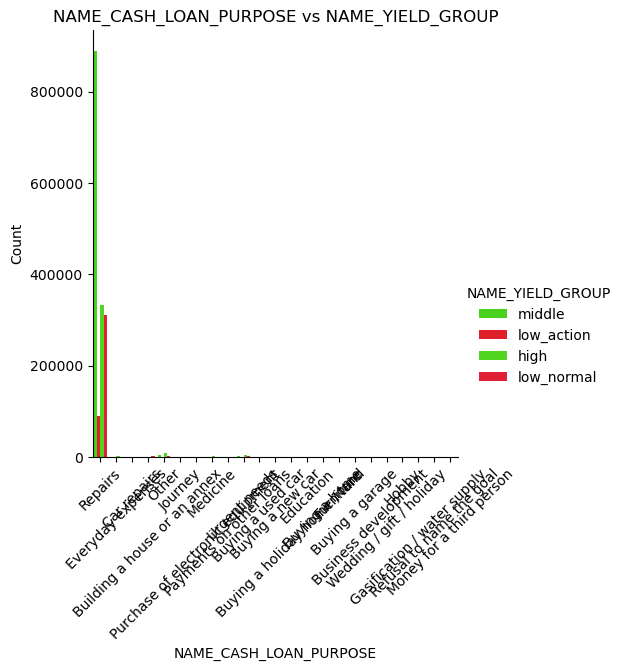

<Figure size 1200x400 with 0 Axes>

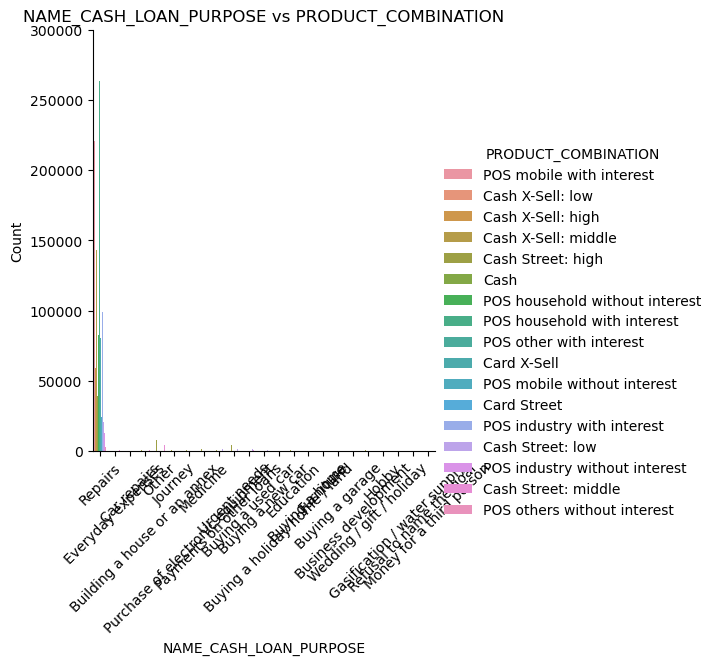

<Figure size 1200x400 with 0 Axes>

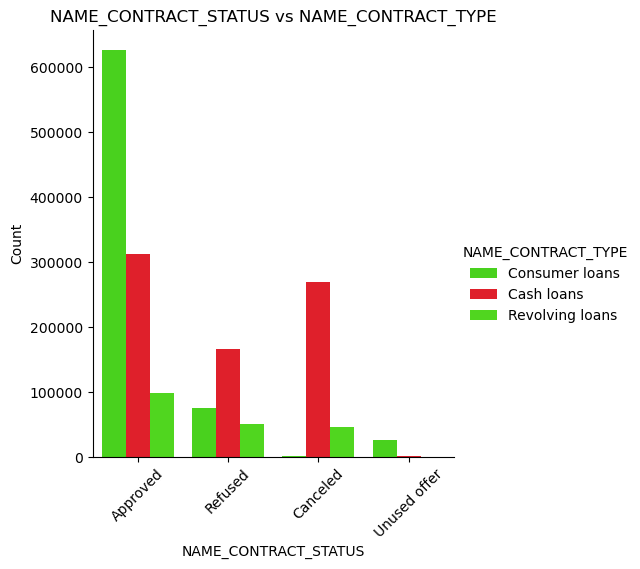

<Figure size 1200x400 with 0 Axes>

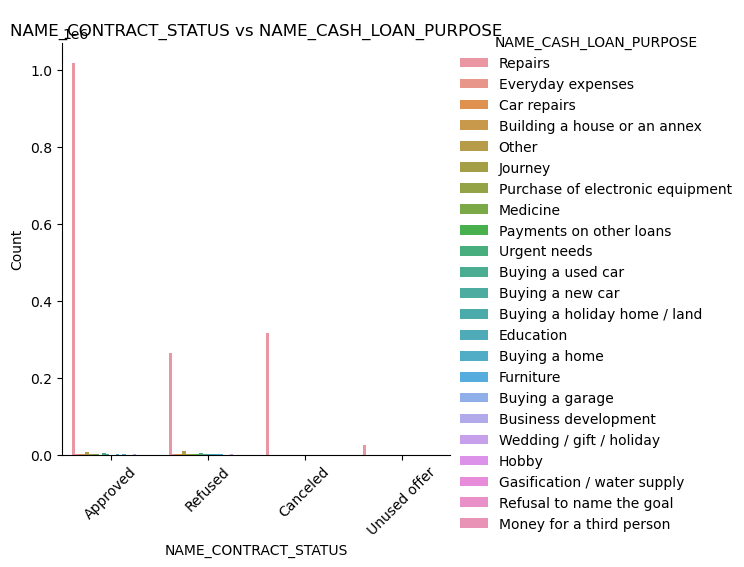

<Figure size 1200x400 with 0 Axes>

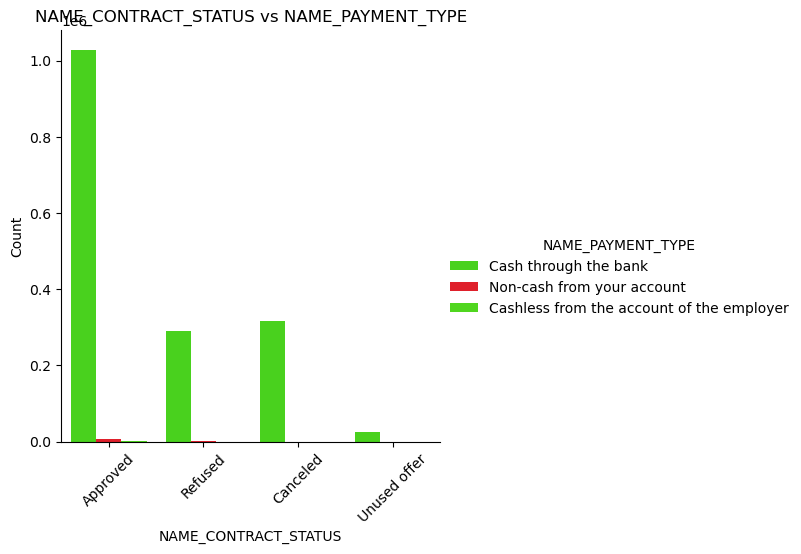

<Figure size 1200x400 with 0 Axes>

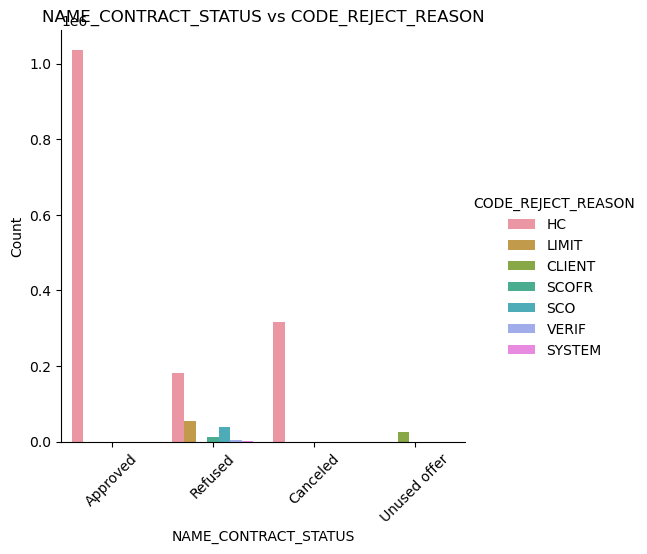

<Figure size 1200x400 with 0 Axes>

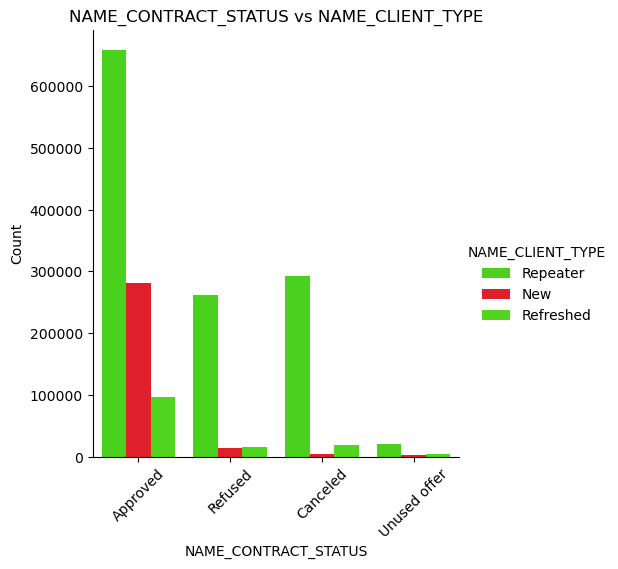

<Figure size 1200x400 with 0 Axes>

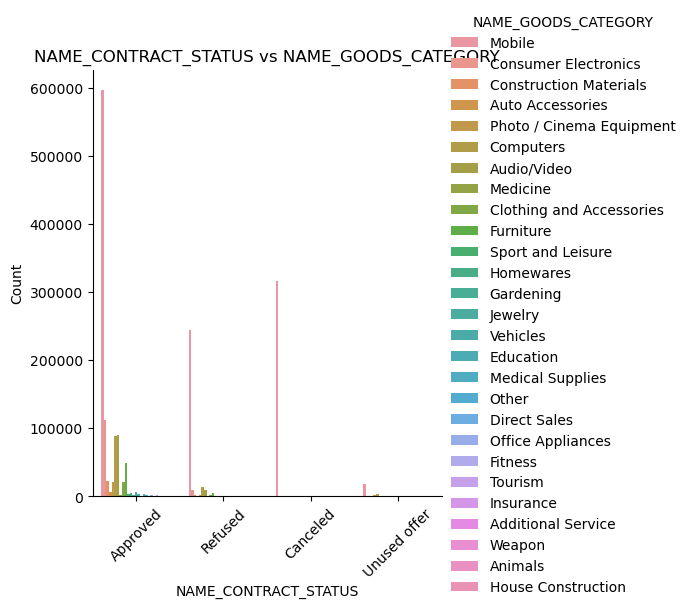

<Figure size 1200x400 with 0 Axes>

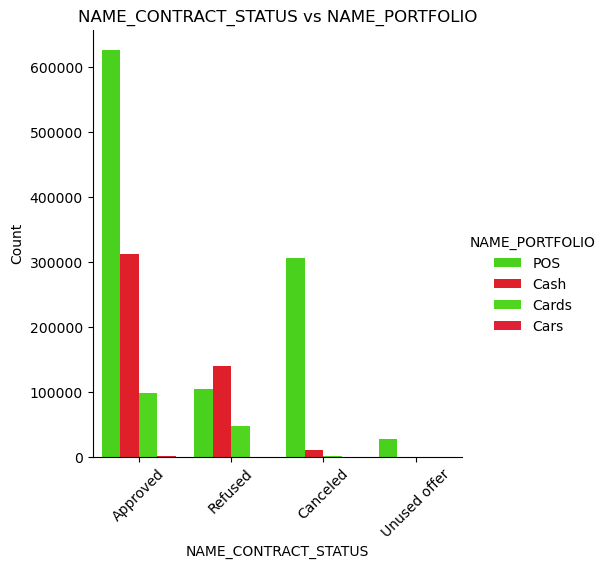

<Figure size 1200x400 with 0 Axes>

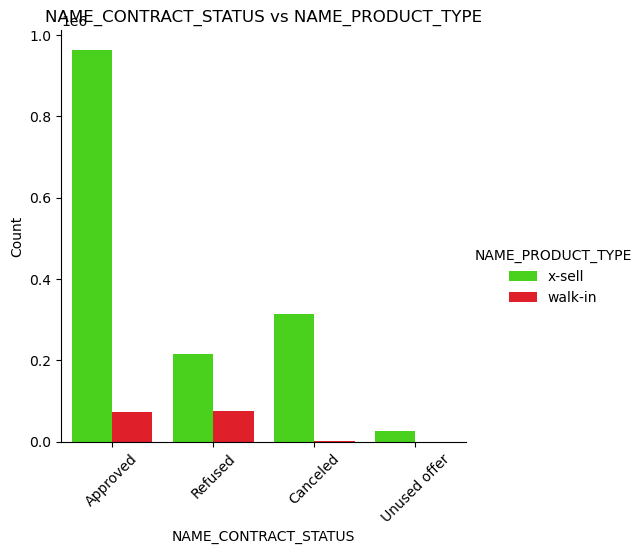

<Figure size 1200x400 with 0 Axes>

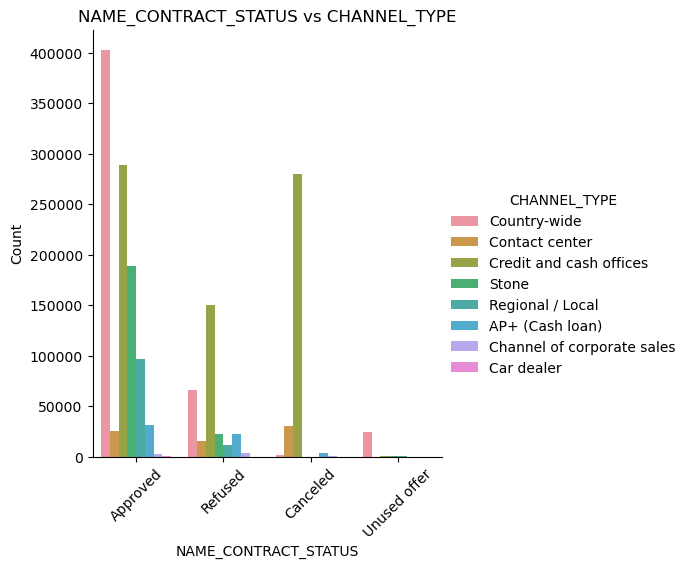

<Figure size 1200x400 with 0 Axes>

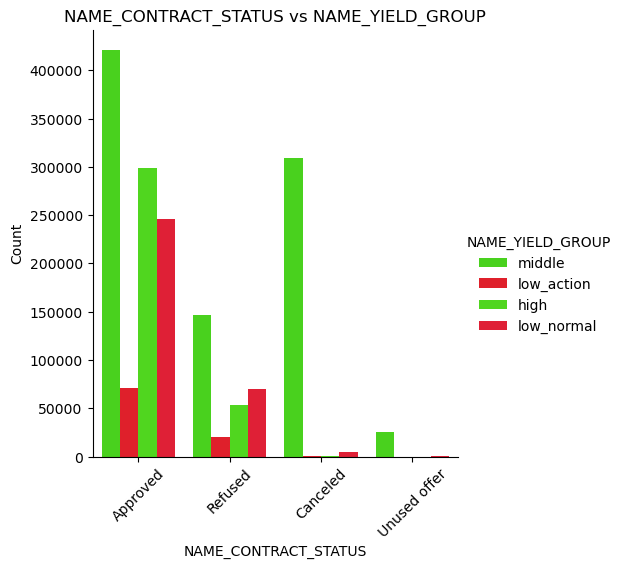

<Figure size 1200x400 with 0 Axes>

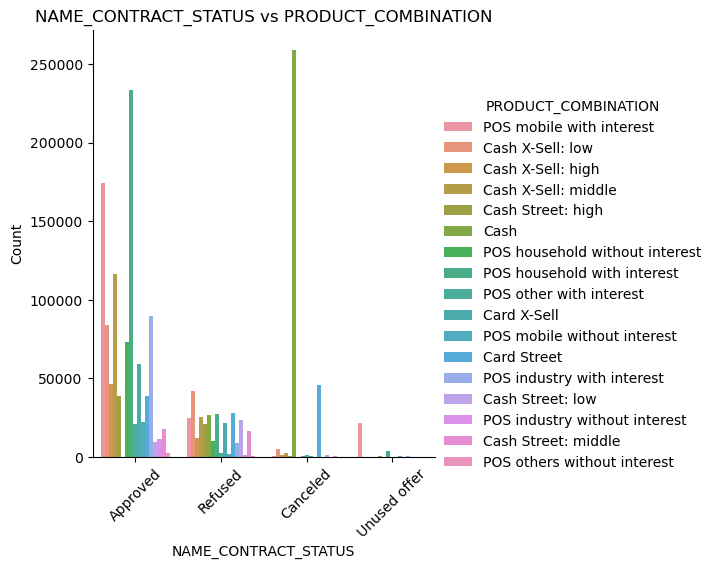

<Figure size 1200x400 with 0 Axes>

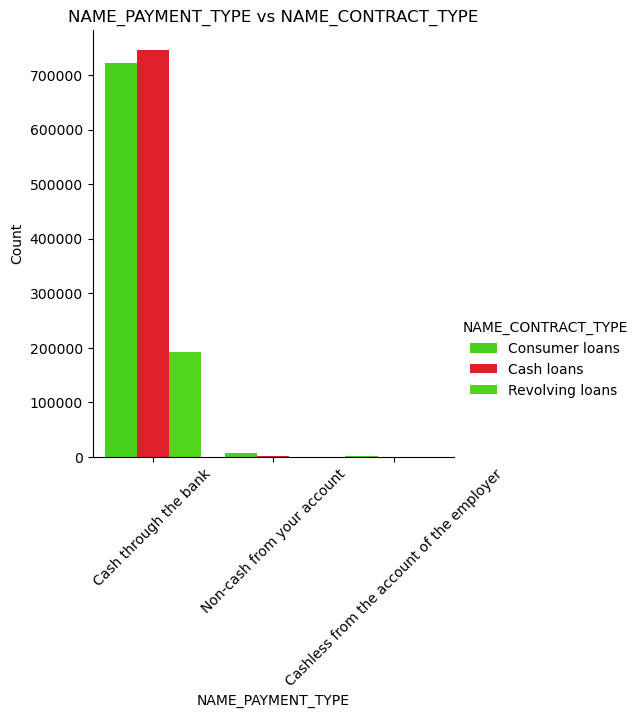

<Figure size 1200x400 with 0 Axes>

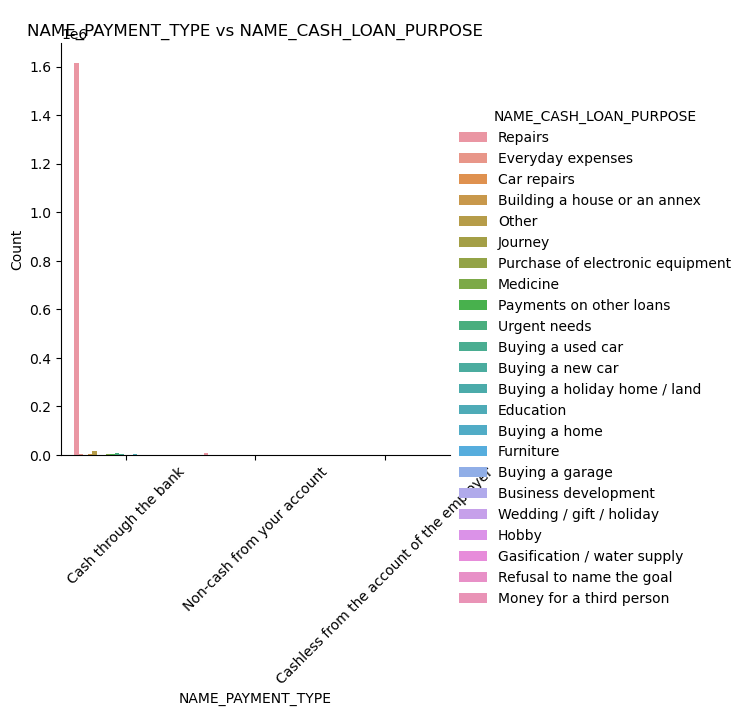

<Figure size 1200x400 with 0 Axes>

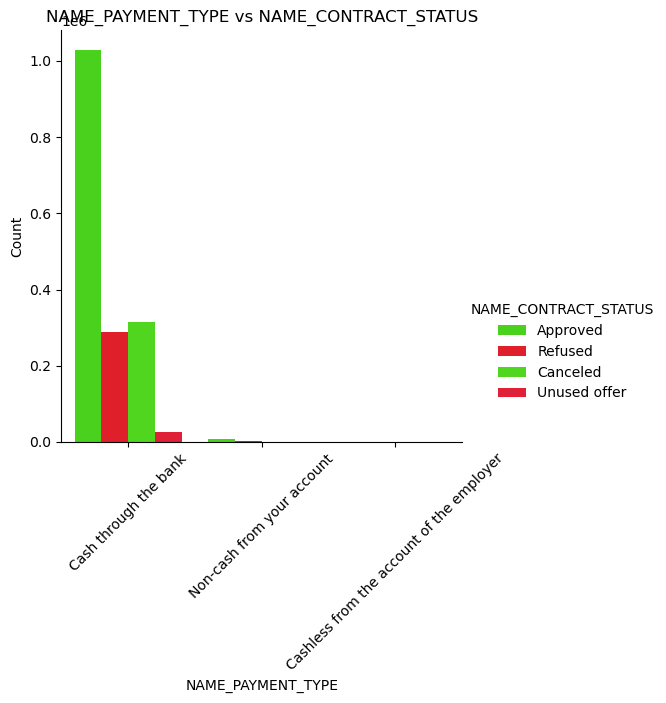

<Figure size 1200x400 with 0 Axes>

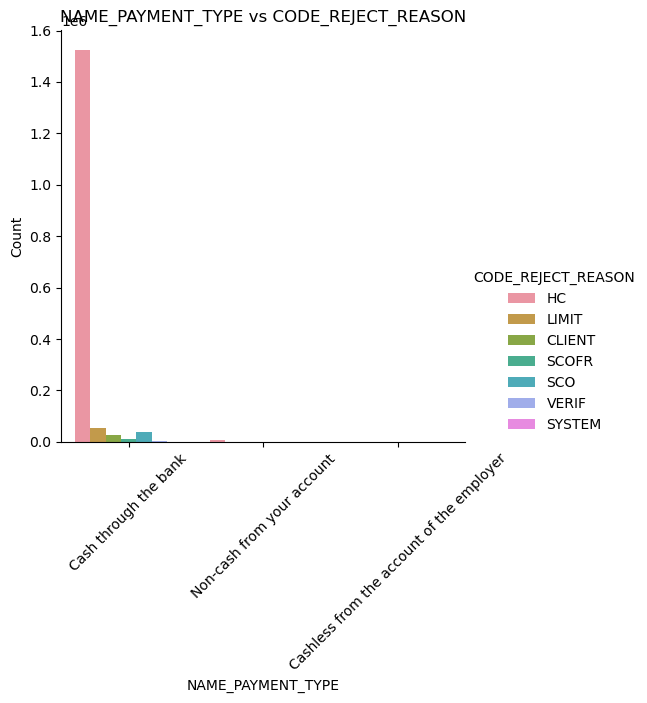

<Figure size 1200x400 with 0 Axes>

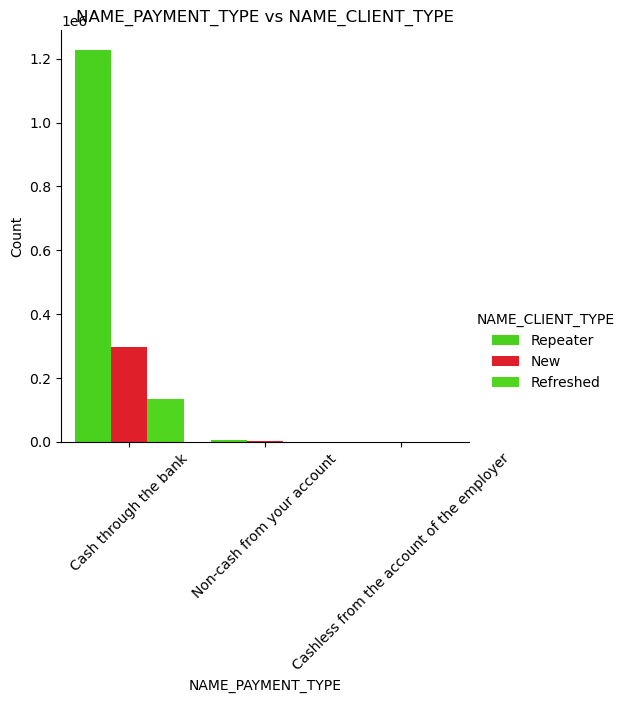

<Figure size 1200x400 with 0 Axes>

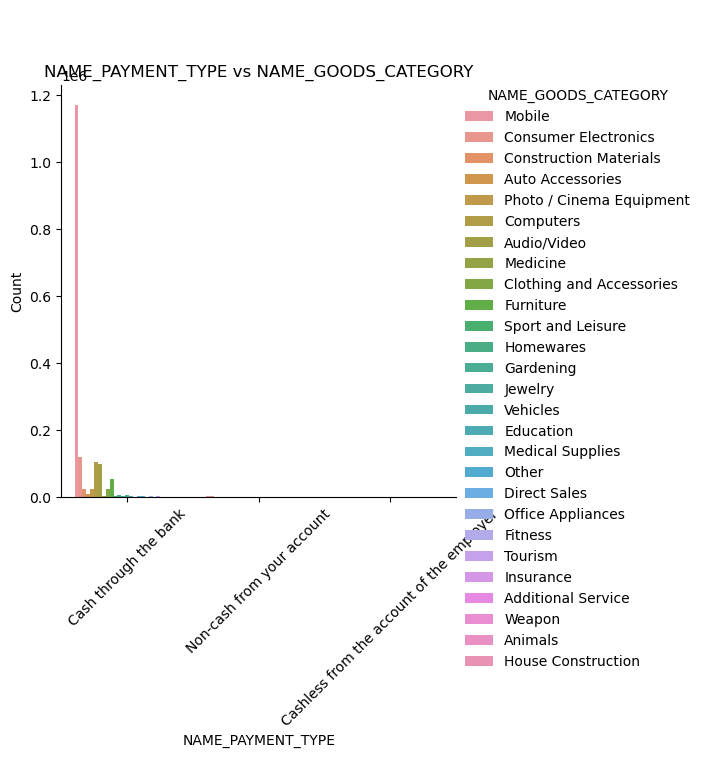

<Figure size 1200x400 with 0 Axes>

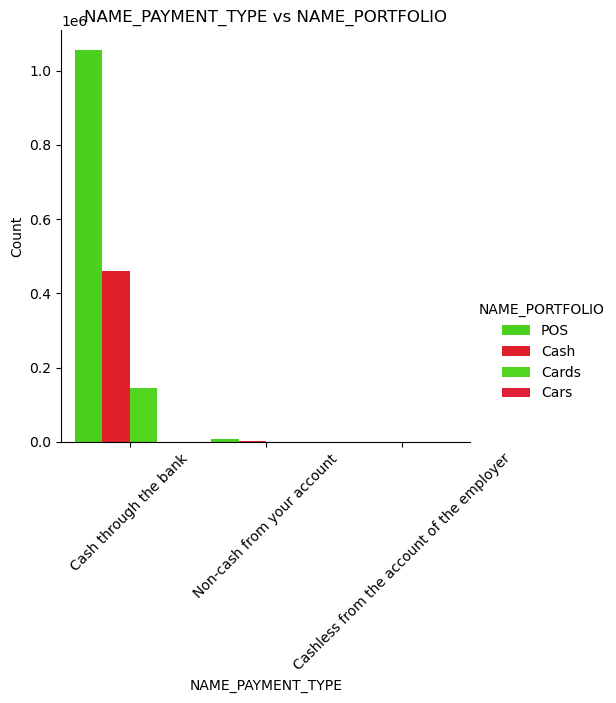

<Figure size 1200x400 with 0 Axes>

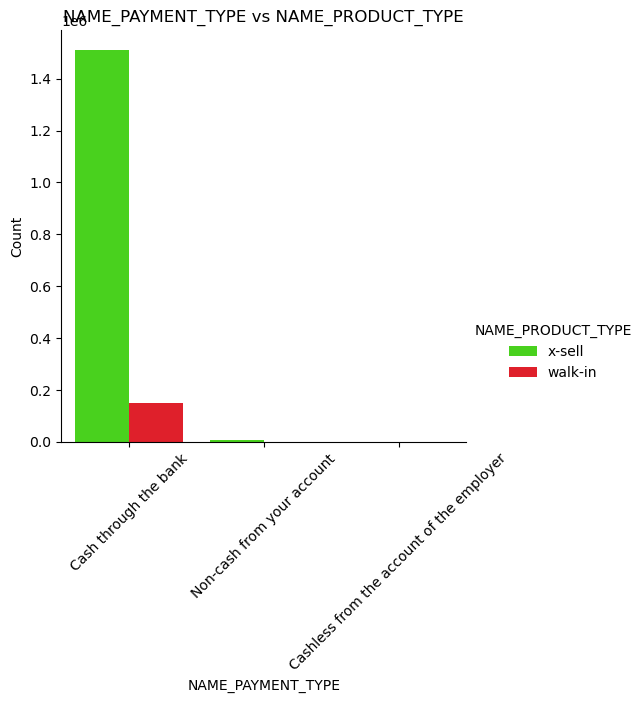

<Figure size 1200x400 with 0 Axes>

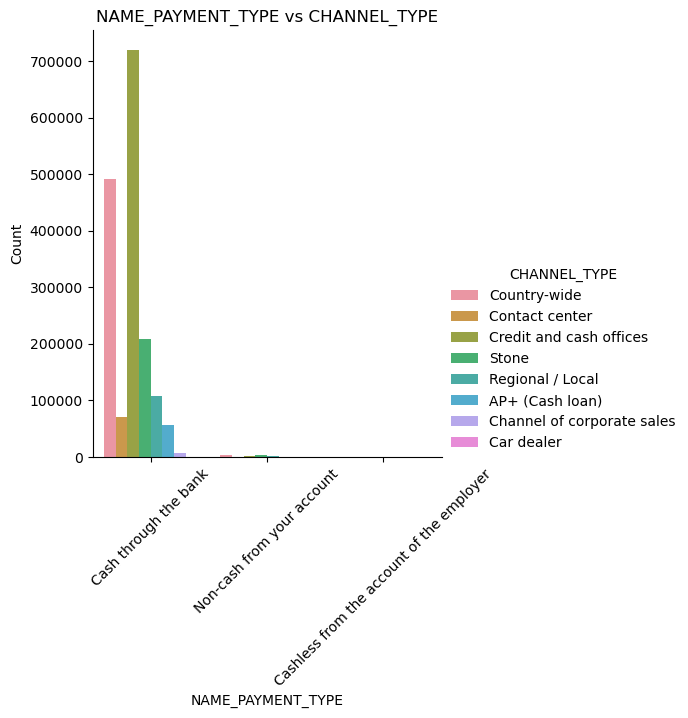

<Figure size 1200x400 with 0 Axes>

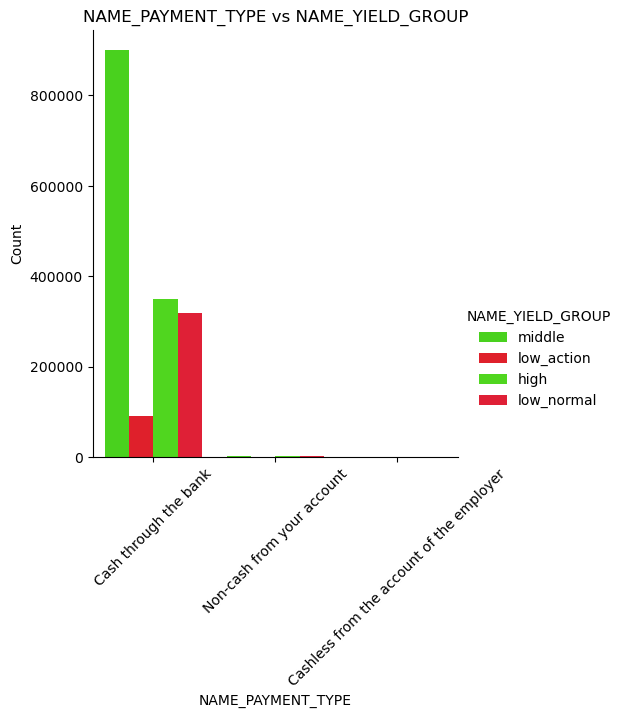

<Figure size 1200x400 with 0 Axes>

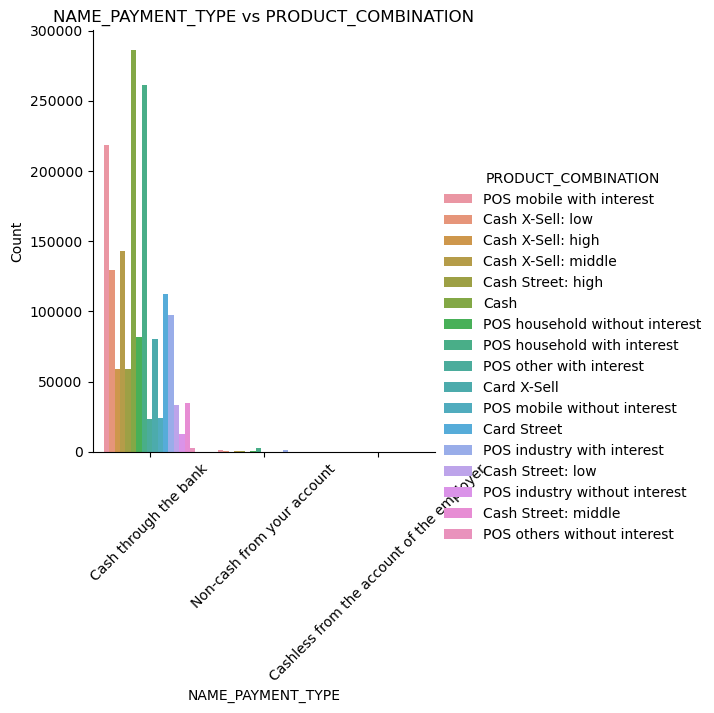

<Figure size 1200x400 with 0 Axes>

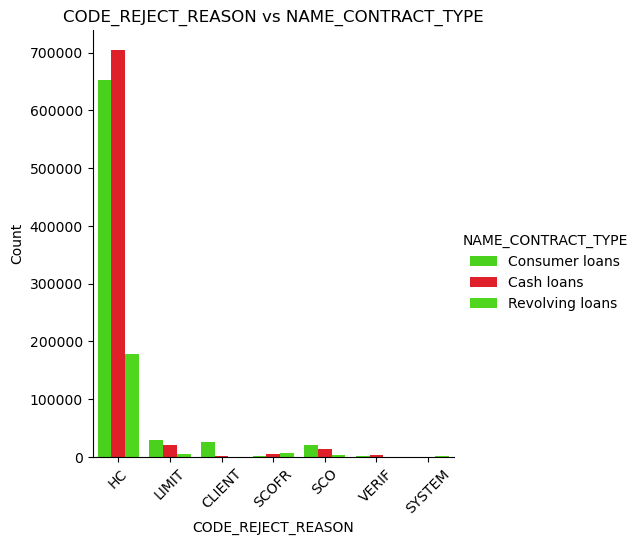

<Figure size 1200x400 with 0 Axes>

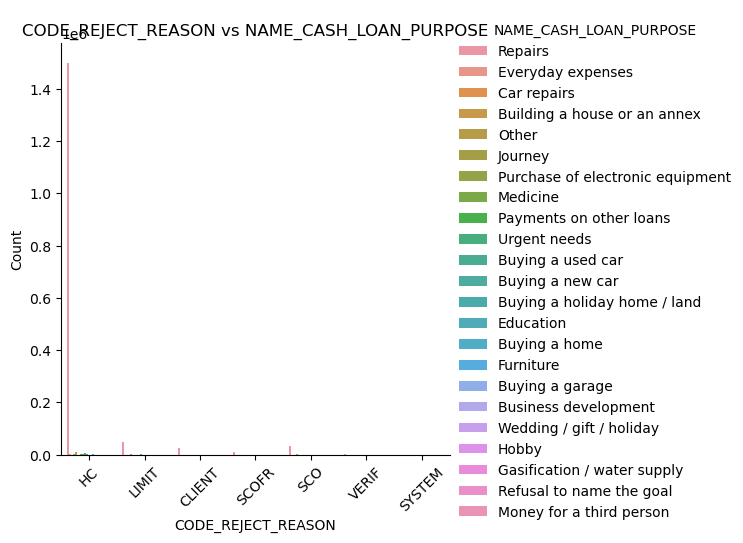

<Figure size 1200x400 with 0 Axes>

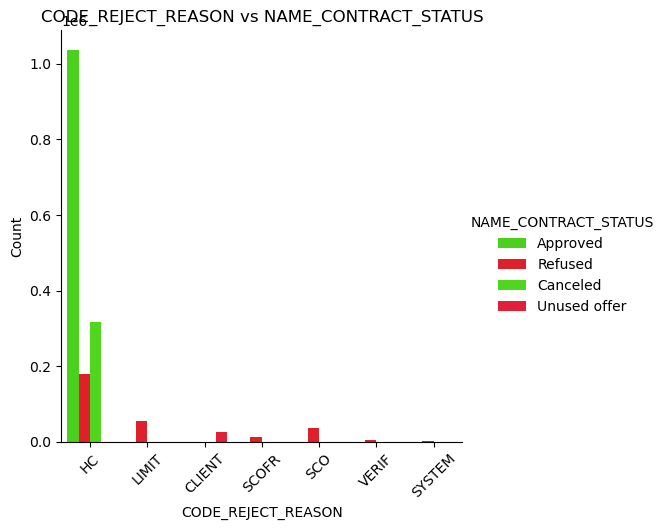

<Figure size 1200x400 with 0 Axes>

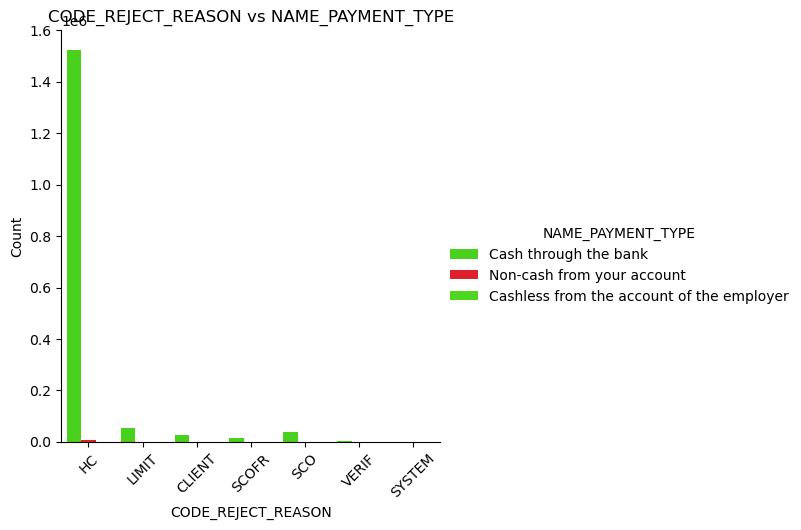

<Figure size 1200x400 with 0 Axes>

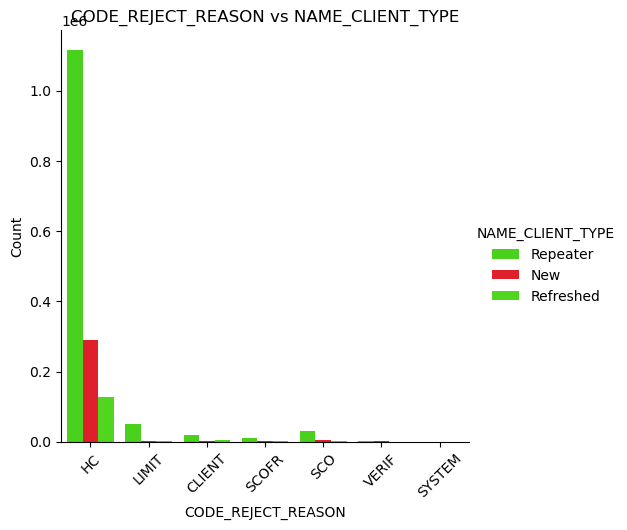

<Figure size 1200x400 with 0 Axes>

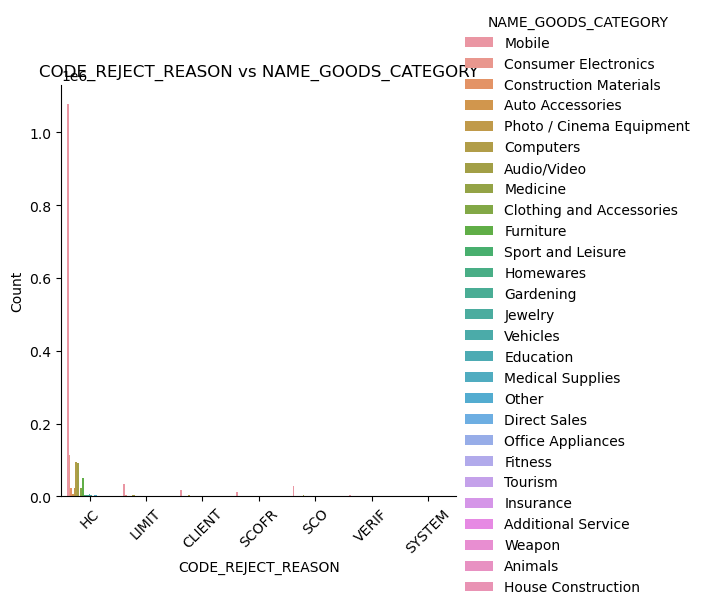

<Figure size 1200x400 with 0 Axes>

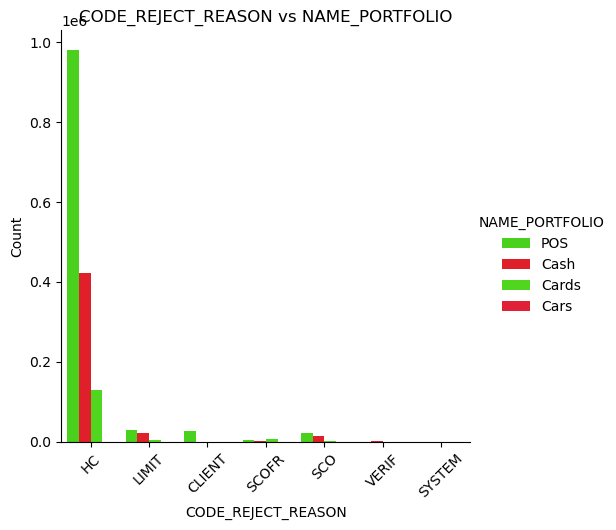

<Figure size 1200x400 with 0 Axes>

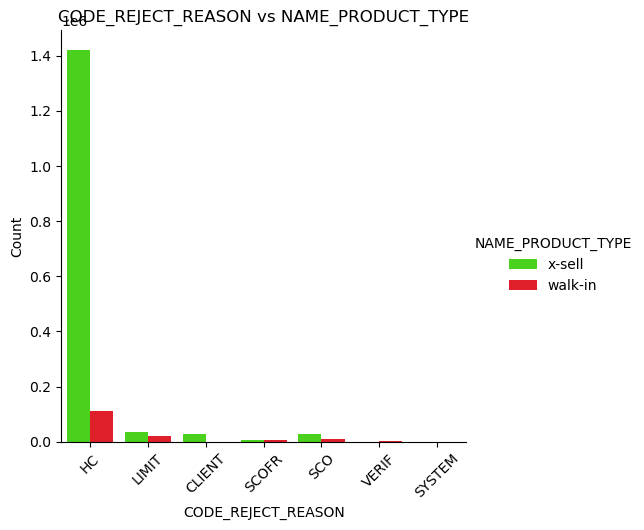

<Figure size 1200x400 with 0 Axes>

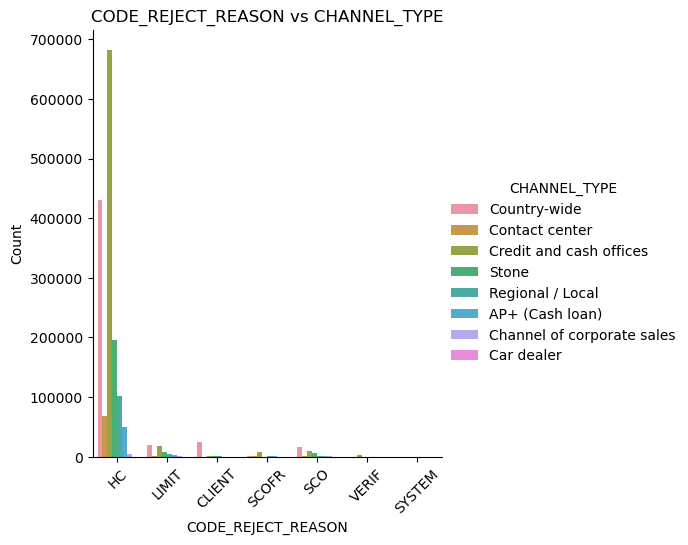

<Figure size 1200x400 with 0 Axes>

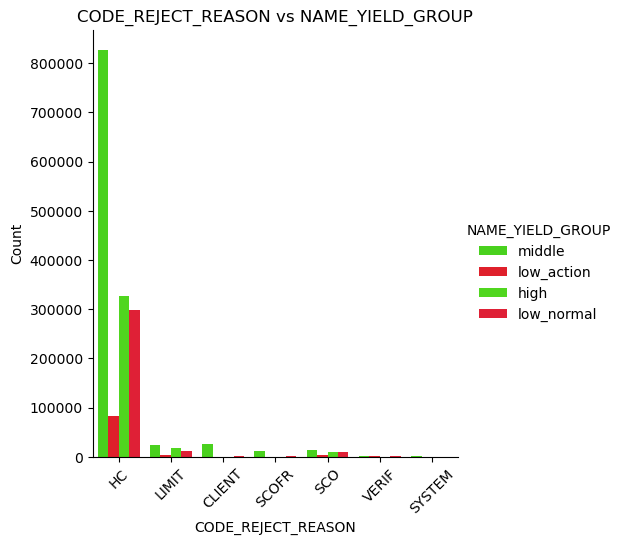

<Figure size 1200x400 with 0 Axes>

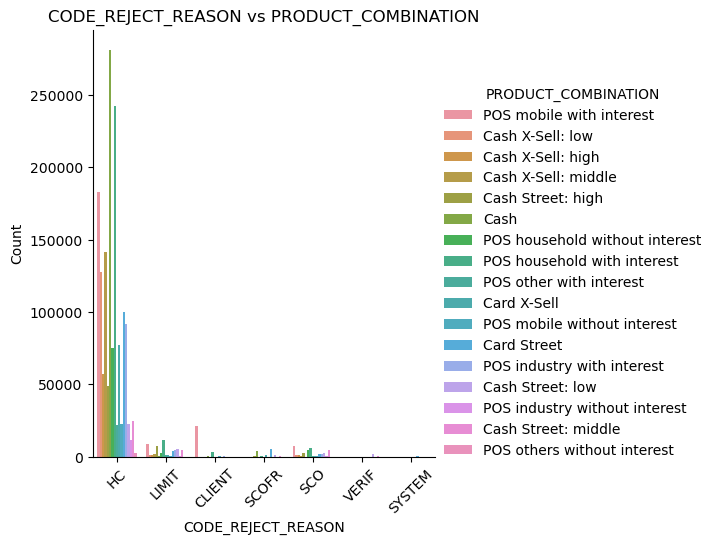

<Figure size 1200x400 with 0 Axes>

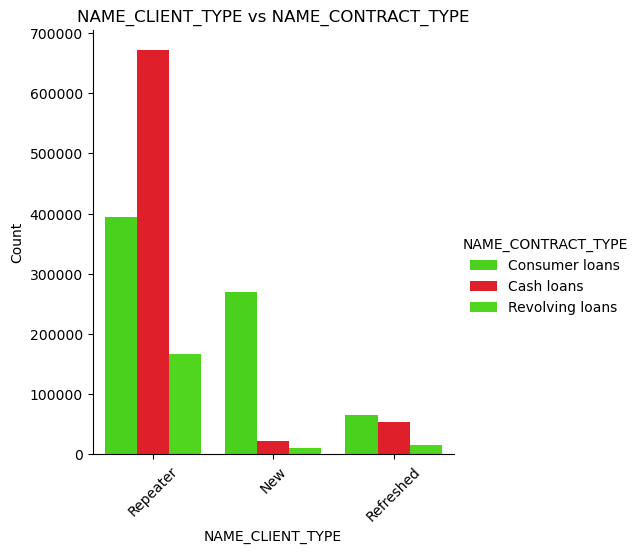

<Figure size 1200x400 with 0 Axes>

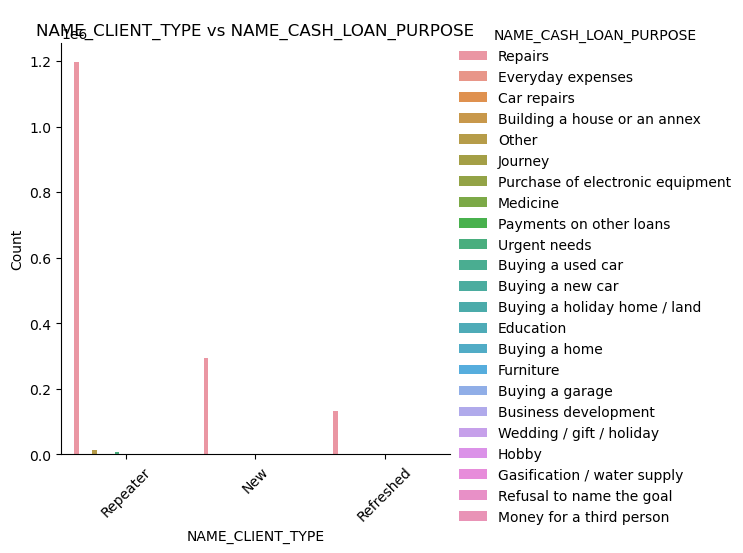

<Figure size 1200x400 with 0 Axes>

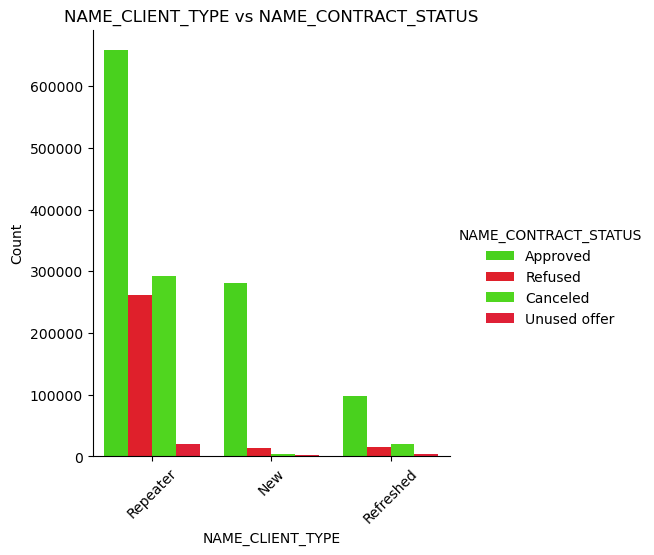

<Figure size 1200x400 with 0 Axes>

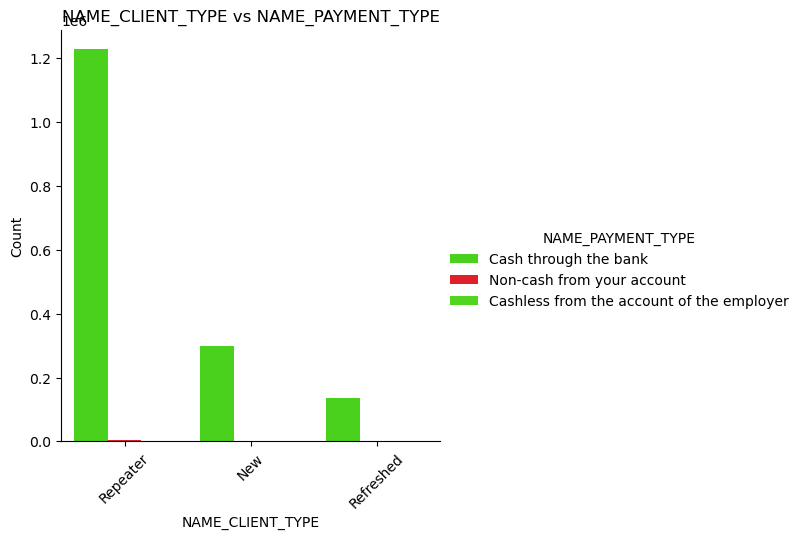

<Figure size 1200x400 with 0 Axes>

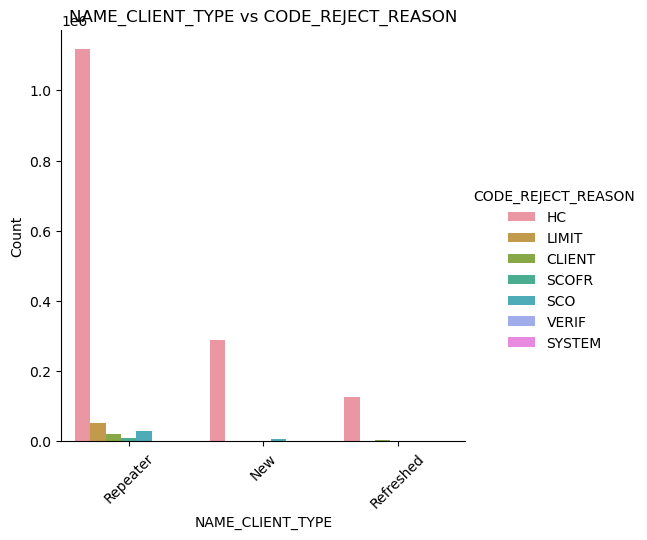

<Figure size 1200x400 with 0 Axes>

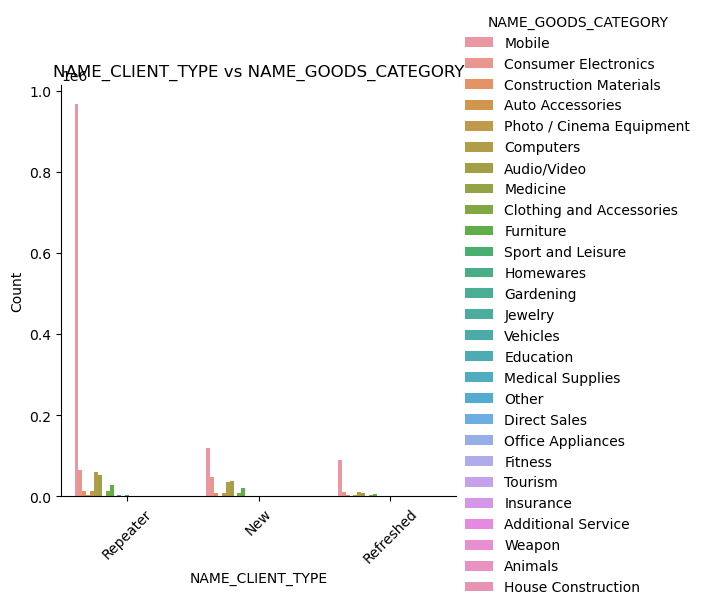

<Figure size 1200x400 with 0 Axes>

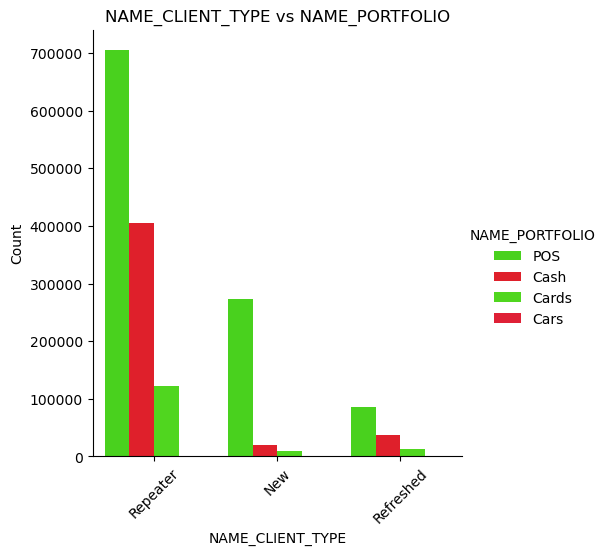

<Figure size 1200x400 with 0 Axes>

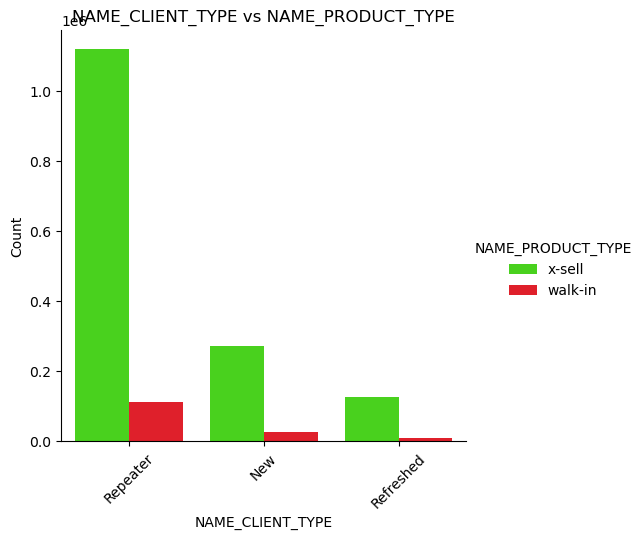

<Figure size 1200x400 with 0 Axes>

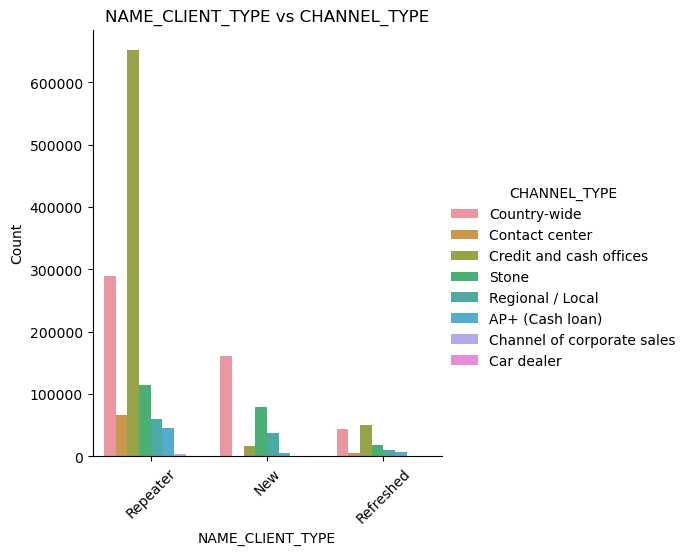

<Figure size 1200x400 with 0 Axes>

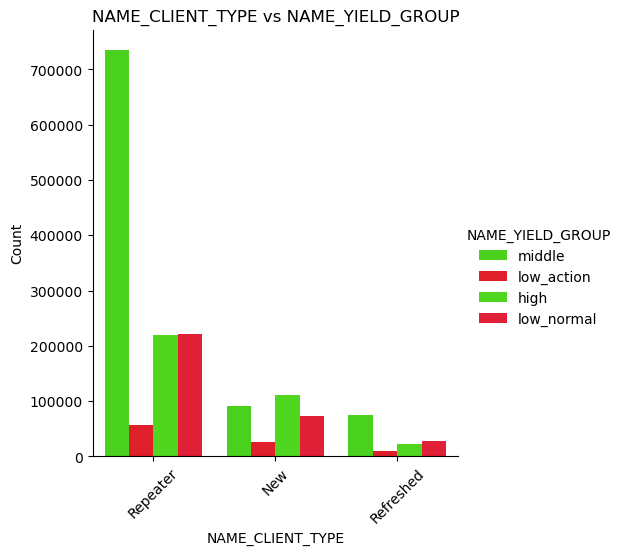

<Figure size 1200x400 with 0 Axes>

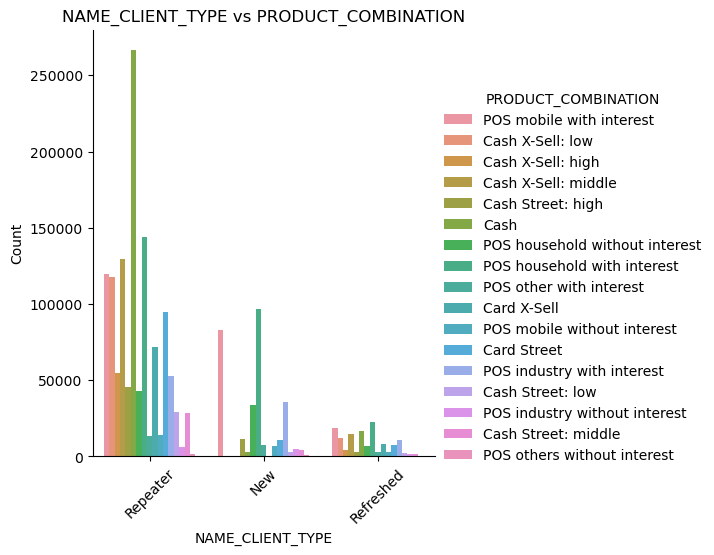

<Figure size 1200x400 with 0 Axes>

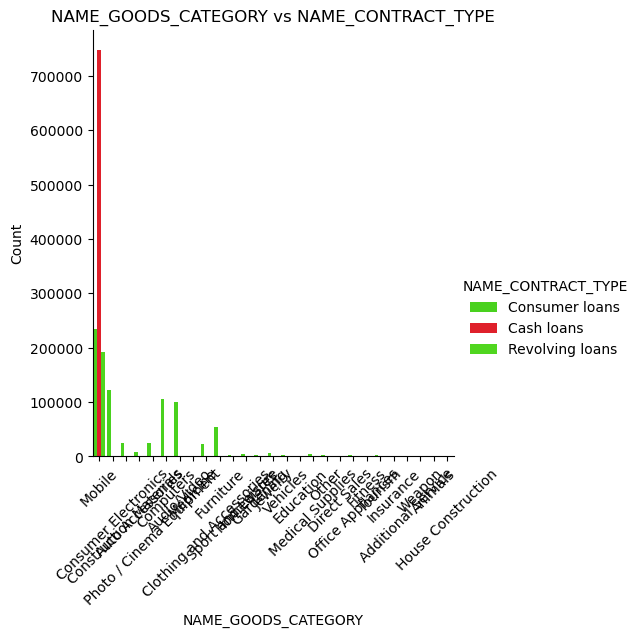

<Figure size 1200x400 with 0 Axes>

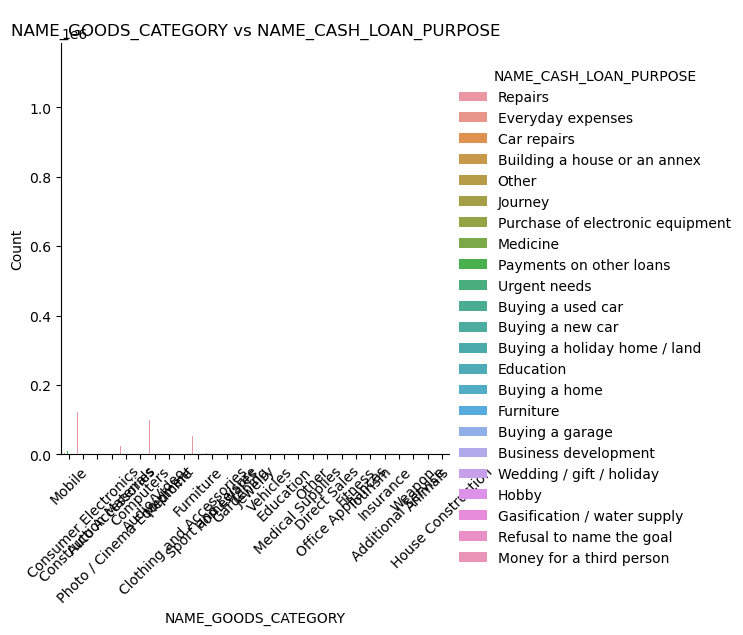

<Figure size 1200x400 with 0 Axes>

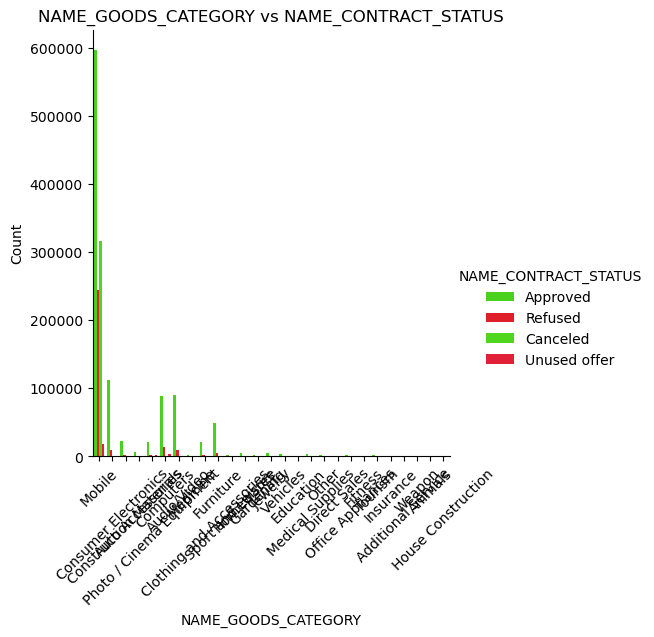

<Figure size 1200x400 with 0 Axes>

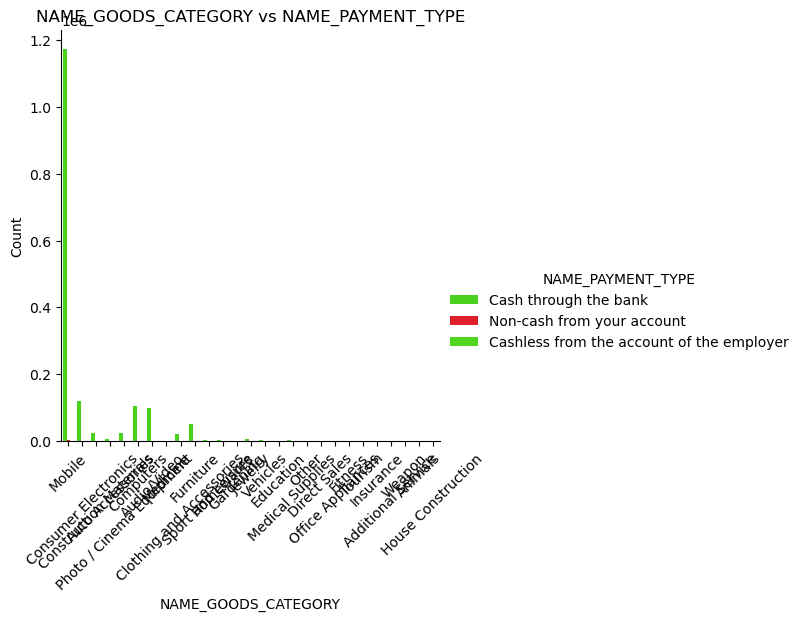

<Figure size 1200x400 with 0 Axes>

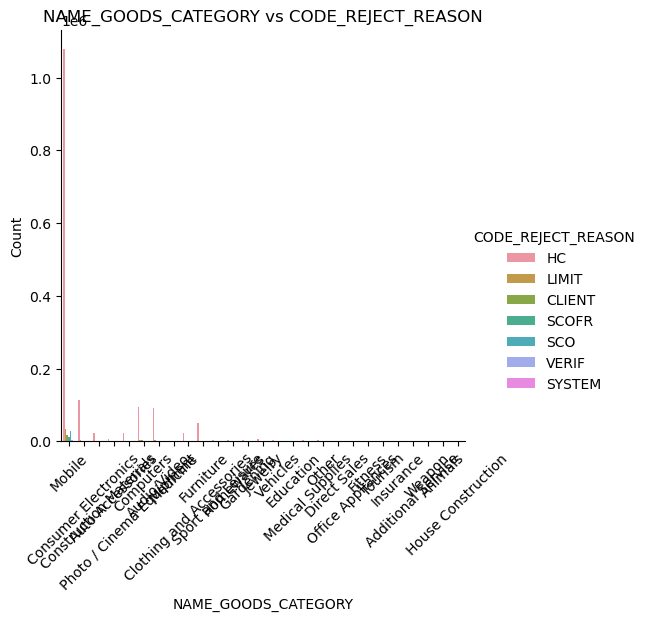

<Figure size 1200x400 with 0 Axes>

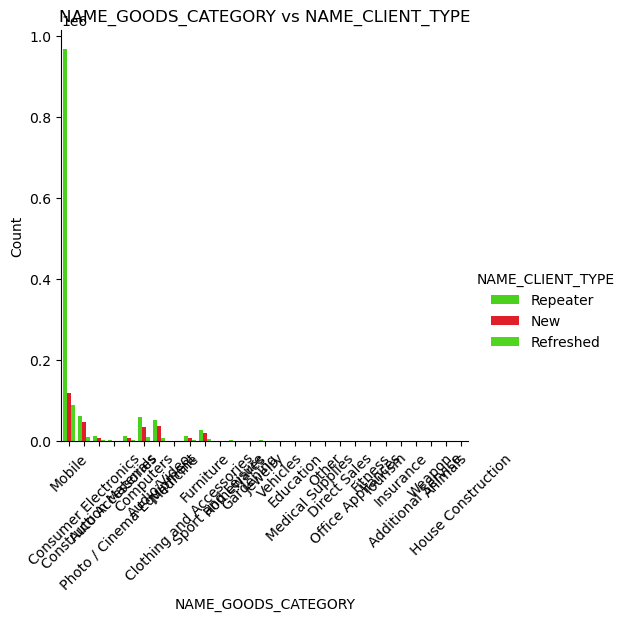

<Figure size 1200x400 with 0 Axes>

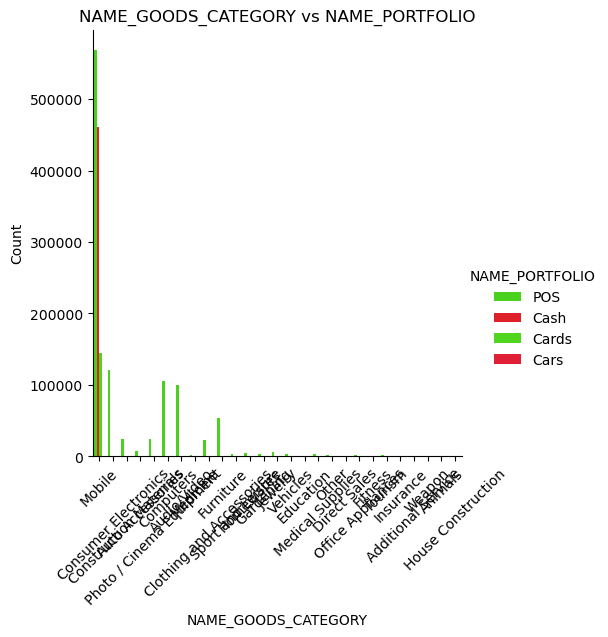

<Figure size 1200x400 with 0 Axes>

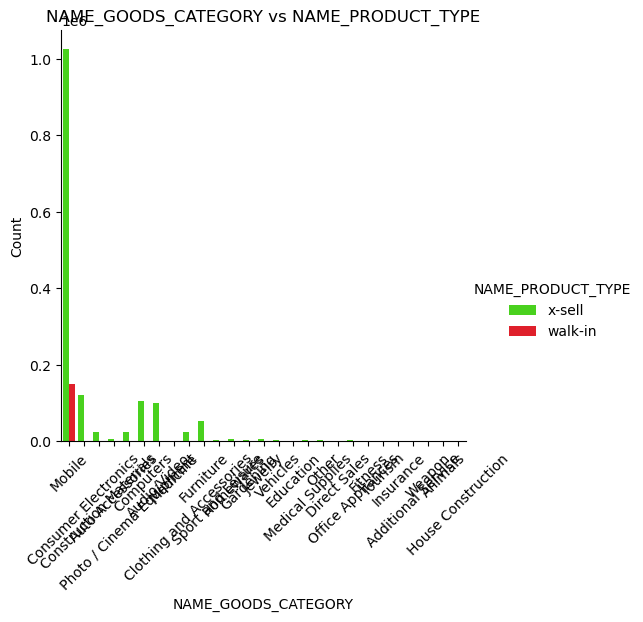

<Figure size 1200x400 with 0 Axes>

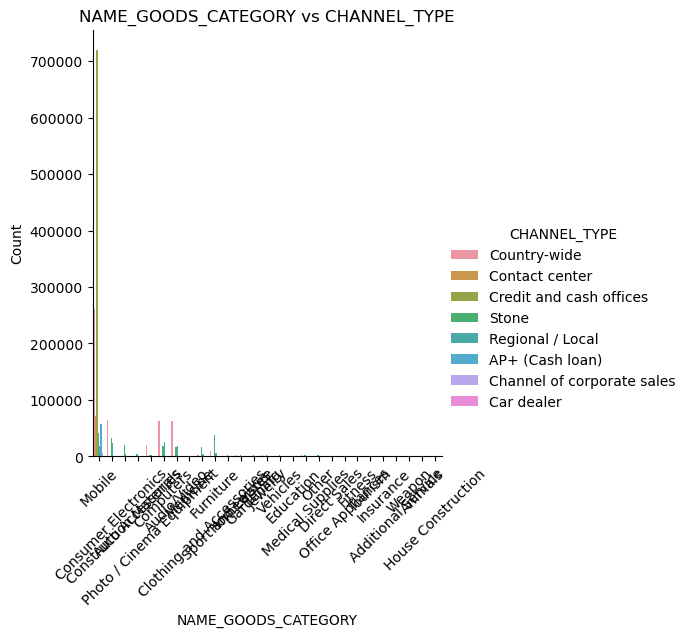

<Figure size 1200x400 with 0 Axes>

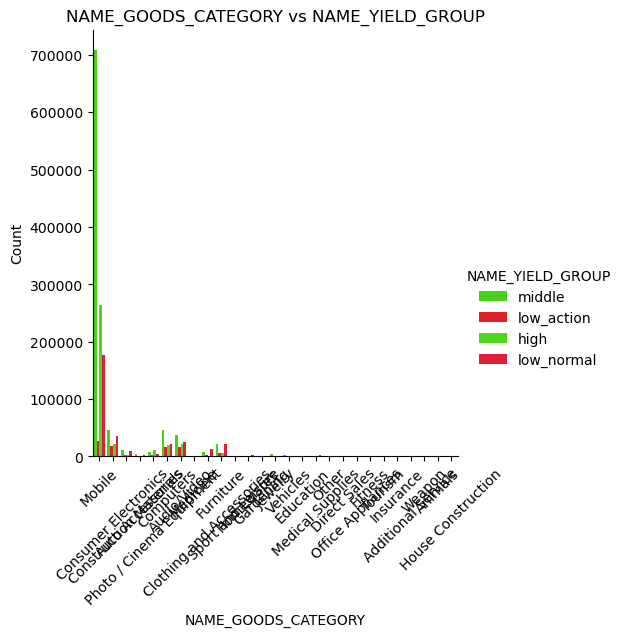

<Figure size 1200x400 with 0 Axes>

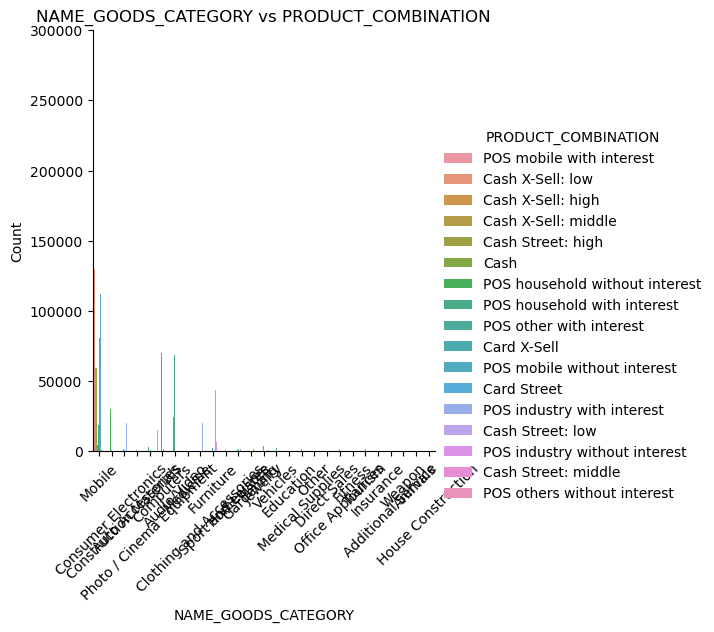

<Figure size 1200x400 with 0 Axes>

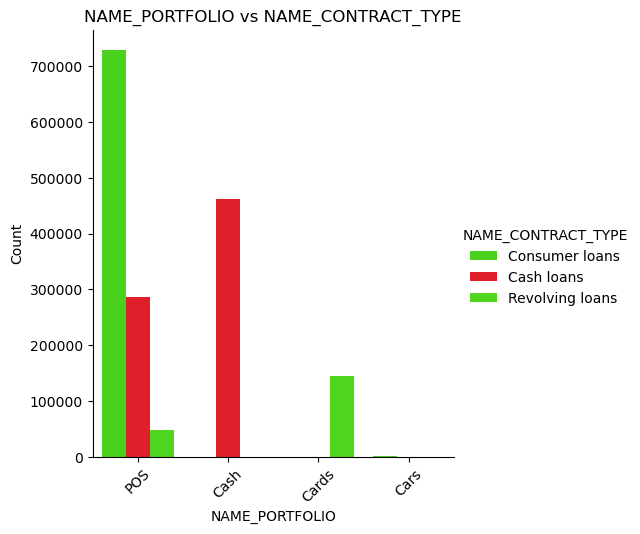

<Figure size 1200x400 with 0 Axes>

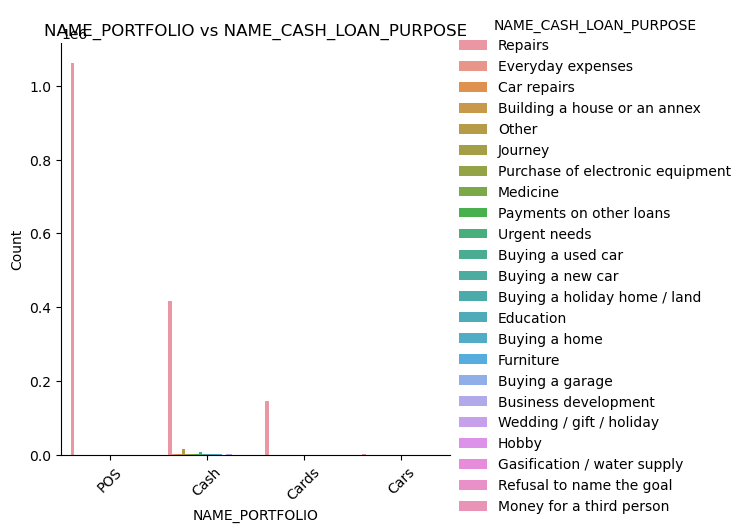

<Figure size 1200x400 with 0 Axes>

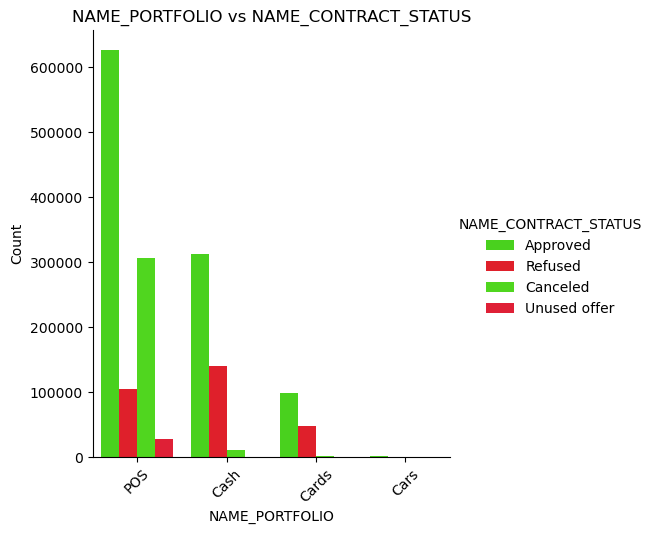

<Figure size 1200x400 with 0 Axes>

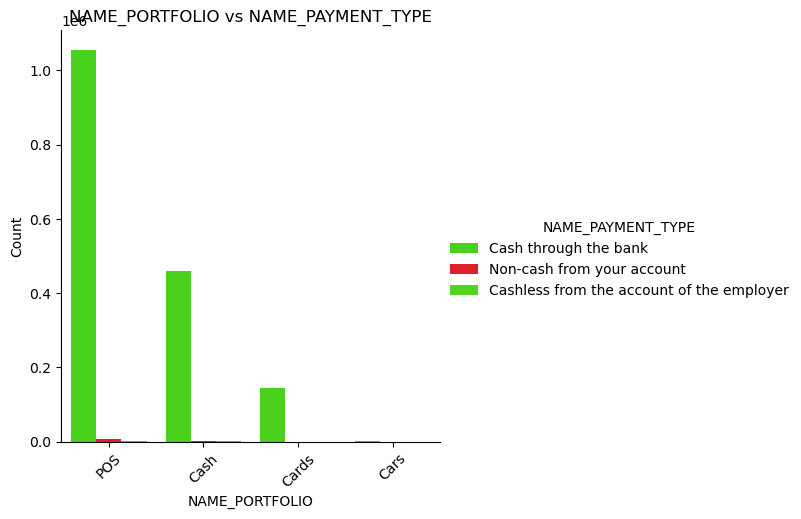

<Figure size 1200x400 with 0 Axes>

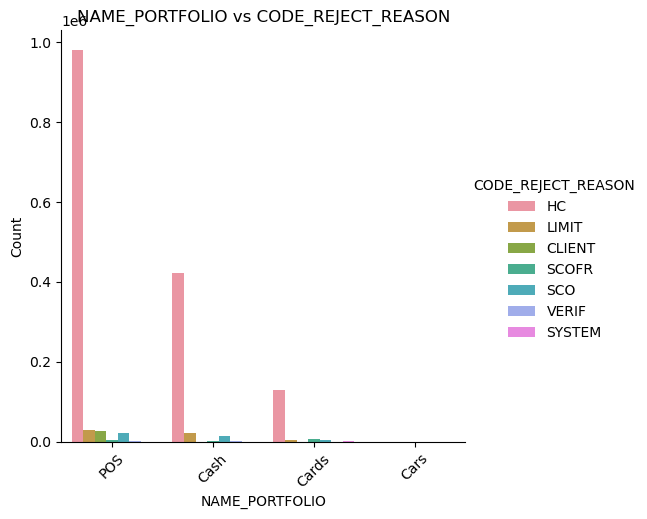

<Figure size 1200x400 with 0 Axes>

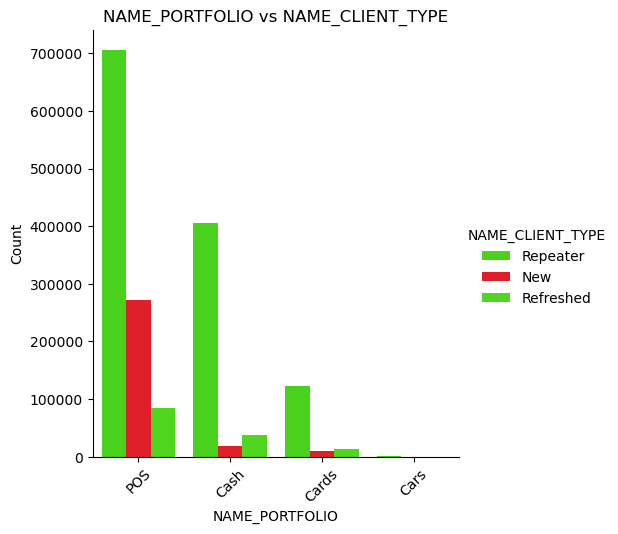

<Figure size 1200x400 with 0 Axes>

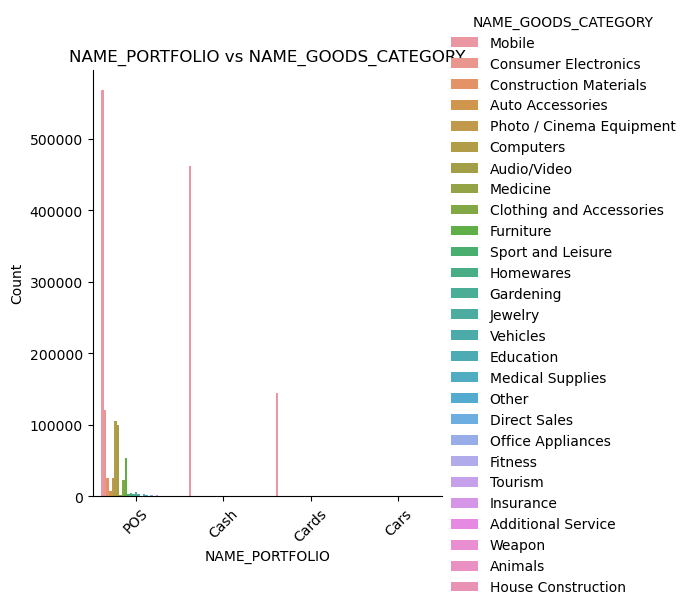

<Figure size 1200x400 with 0 Axes>

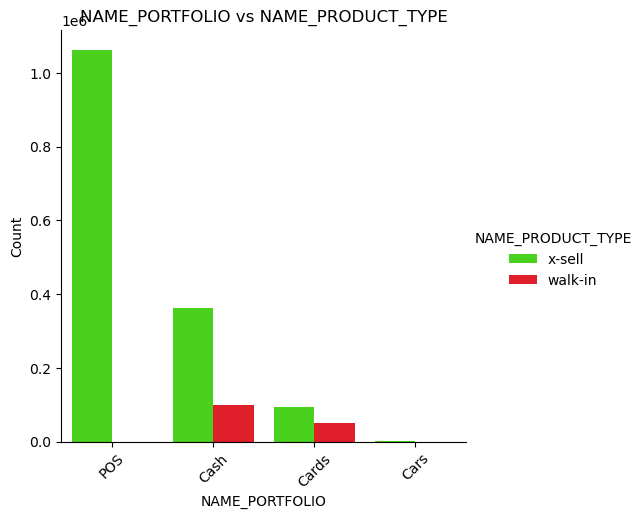

<Figure size 1200x400 with 0 Axes>

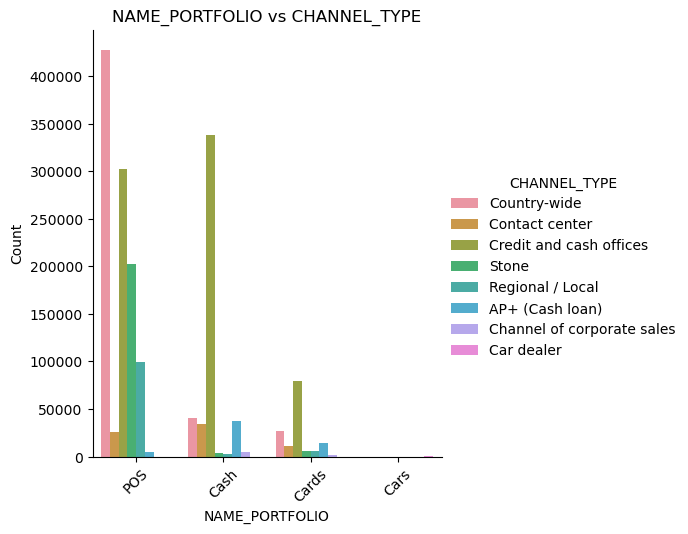

<Figure size 1200x400 with 0 Axes>

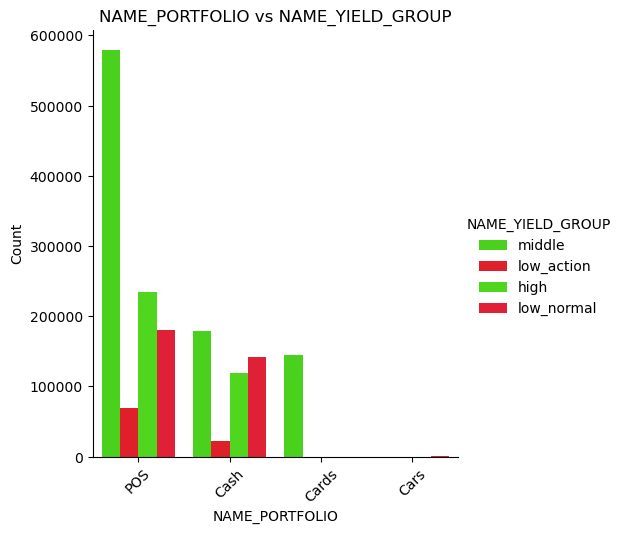

<Figure size 1200x400 with 0 Axes>

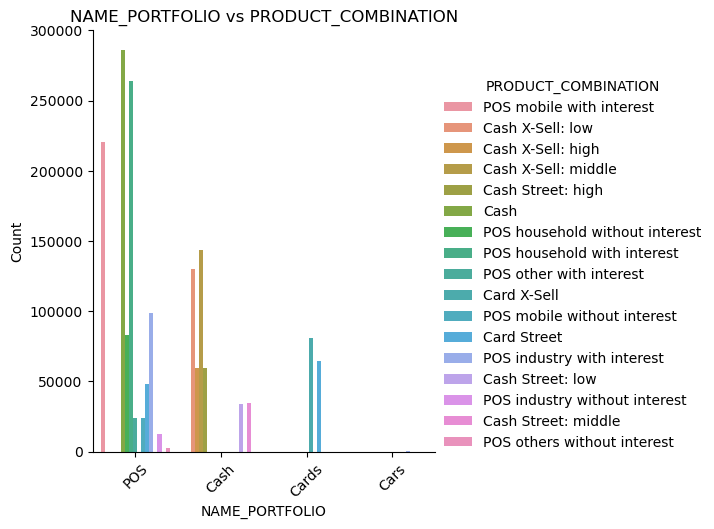

<Figure size 1200x400 with 0 Axes>

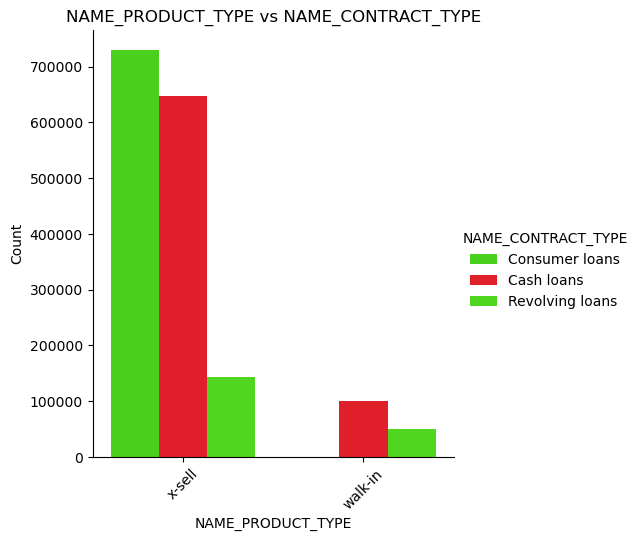

<Figure size 1200x400 with 0 Axes>

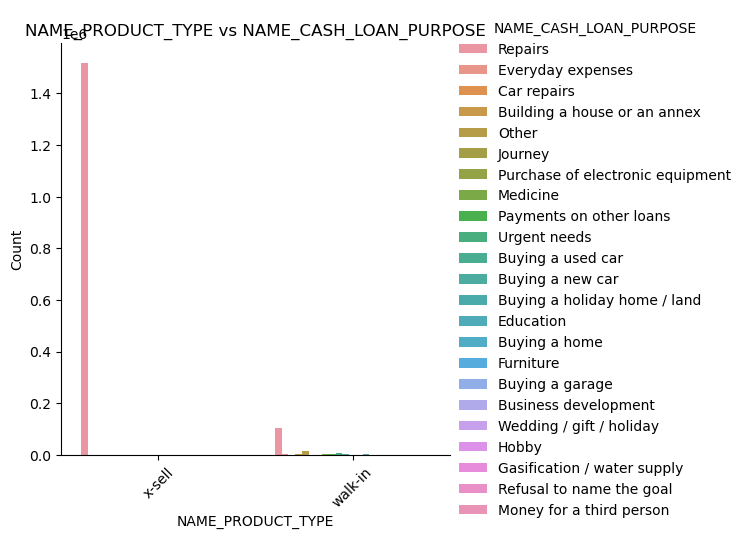

<Figure size 1200x400 with 0 Axes>

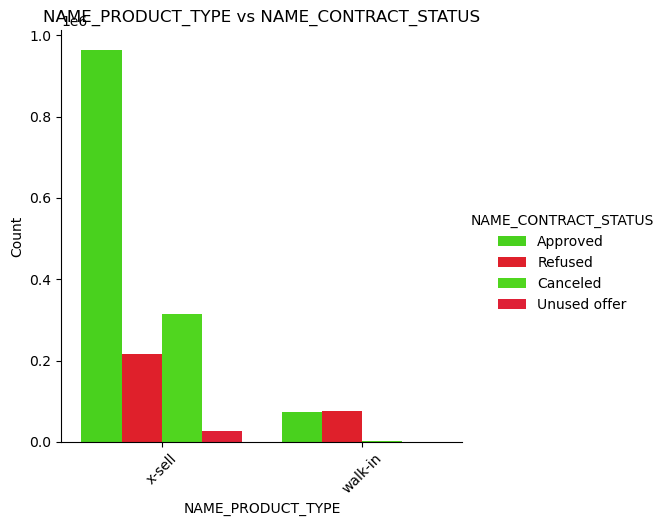

<Figure size 1200x400 with 0 Axes>

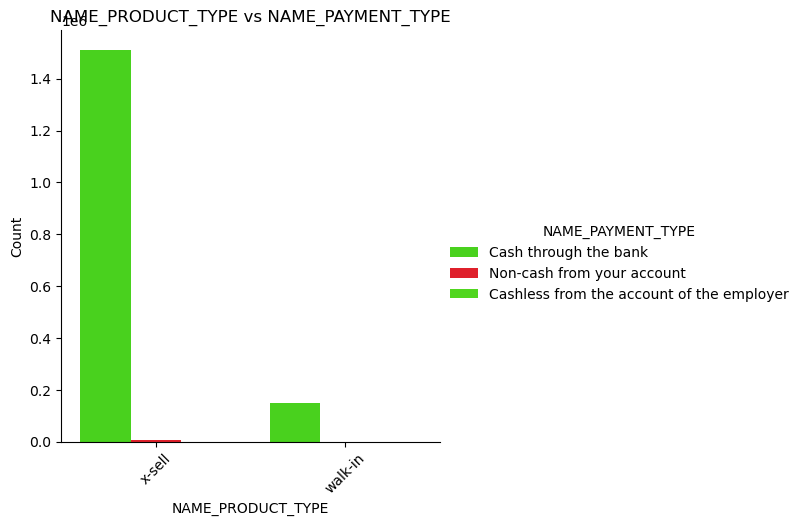

<Figure size 1200x400 with 0 Axes>

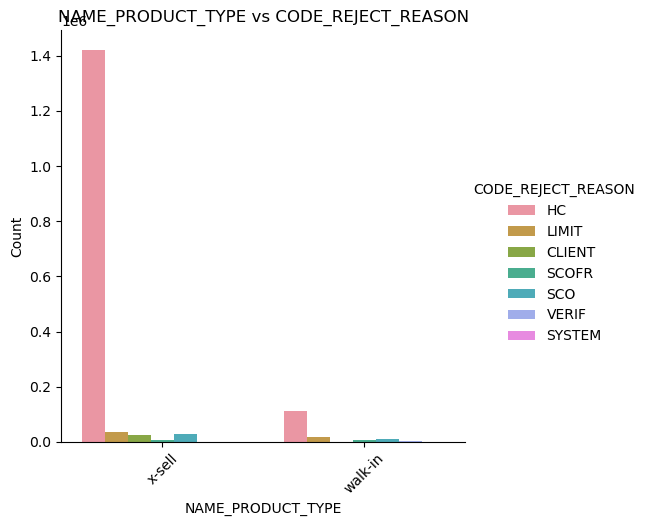

<Figure size 1200x400 with 0 Axes>

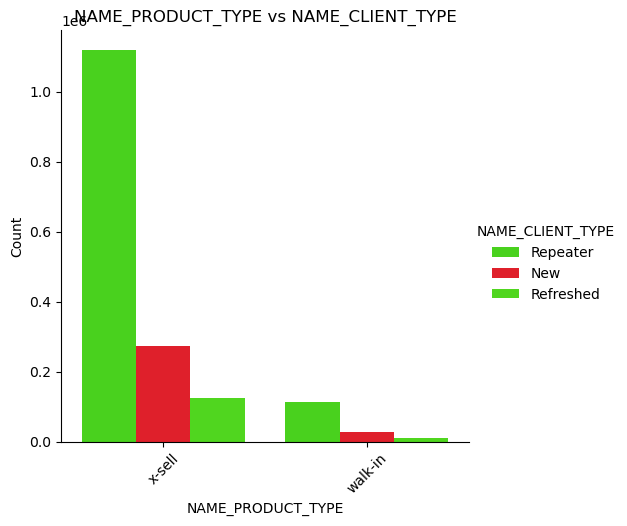

<Figure size 1200x400 with 0 Axes>

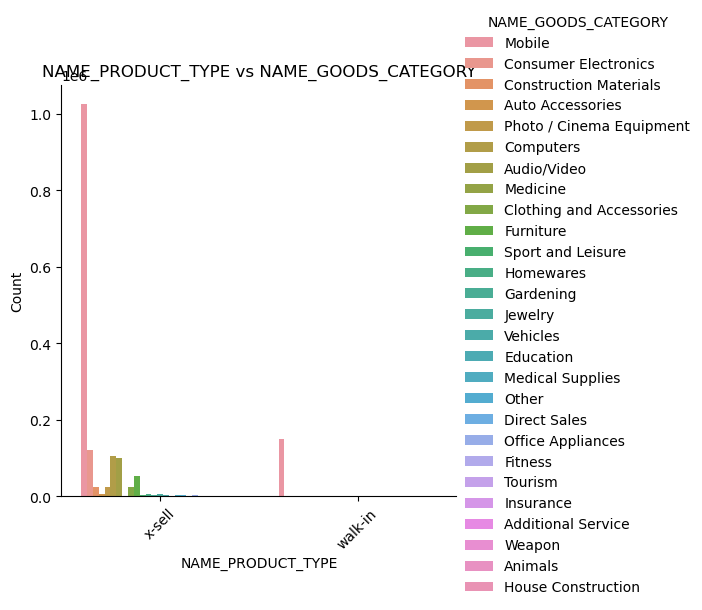

<Figure size 1200x400 with 0 Axes>

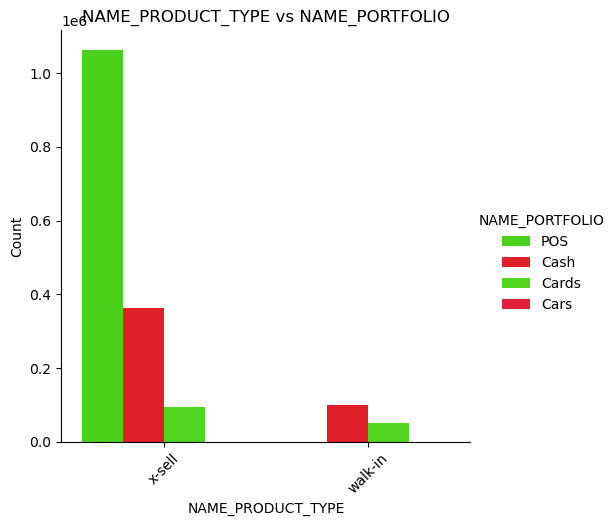

<Figure size 1200x400 with 0 Axes>

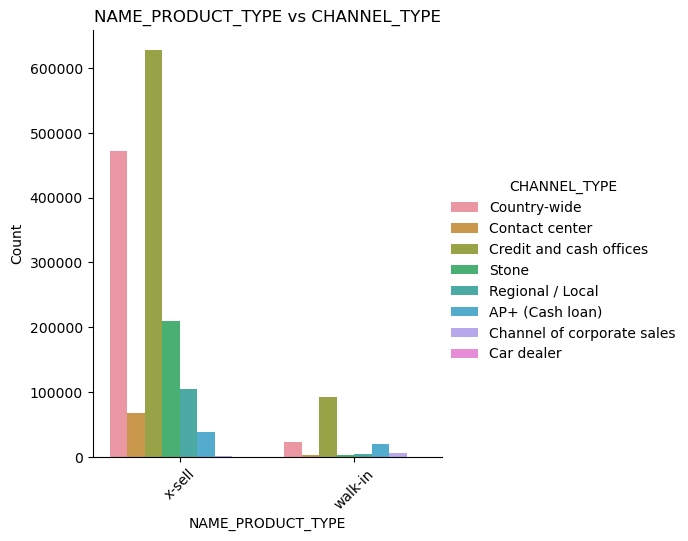

<Figure size 1200x400 with 0 Axes>

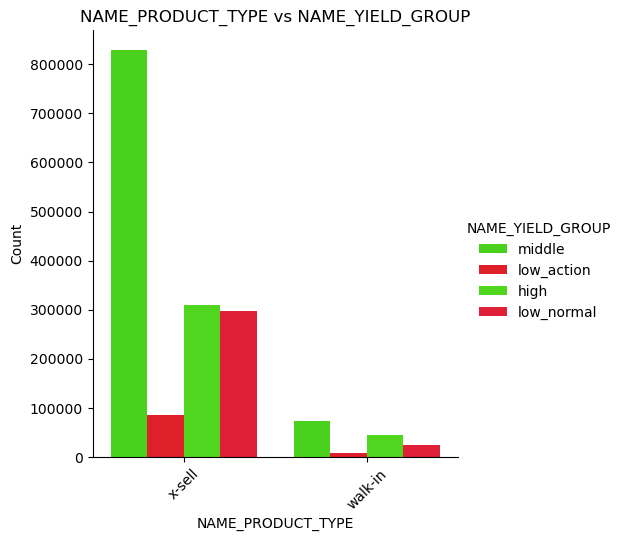

<Figure size 1200x400 with 0 Axes>

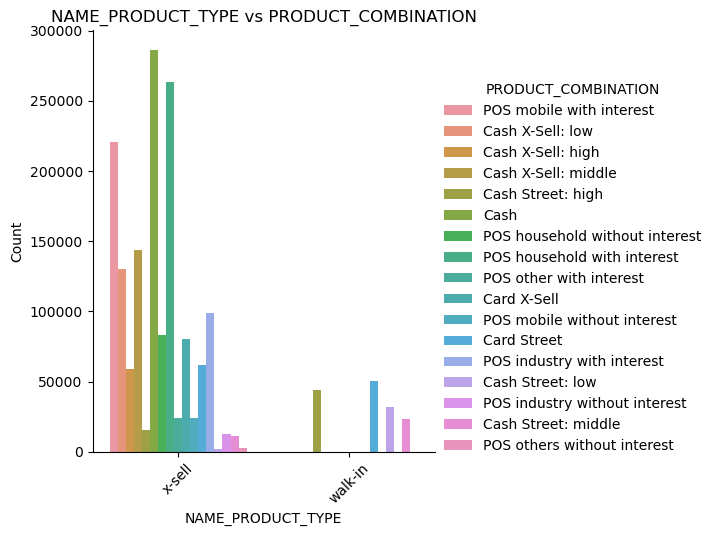

<Figure size 1200x400 with 0 Axes>

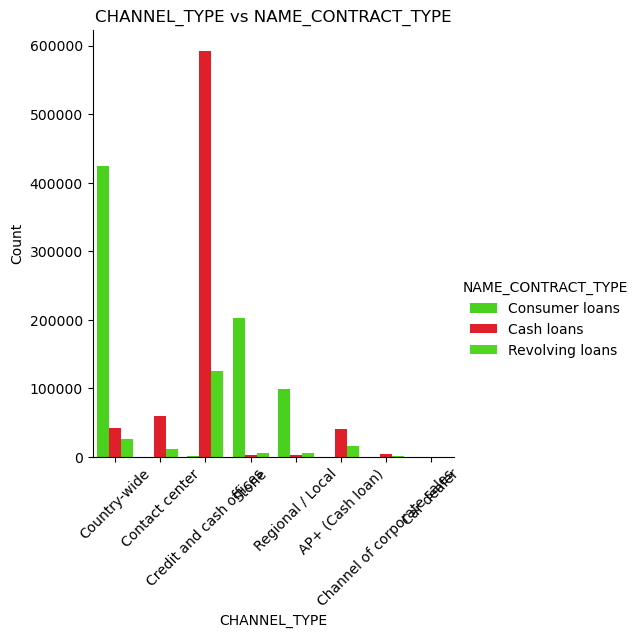

<Figure size 1200x400 with 0 Axes>

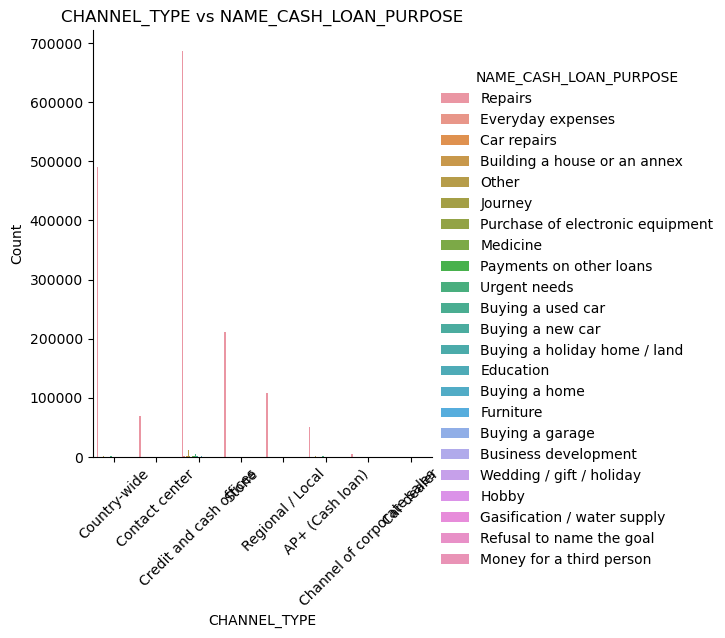

<Figure size 1200x400 with 0 Axes>

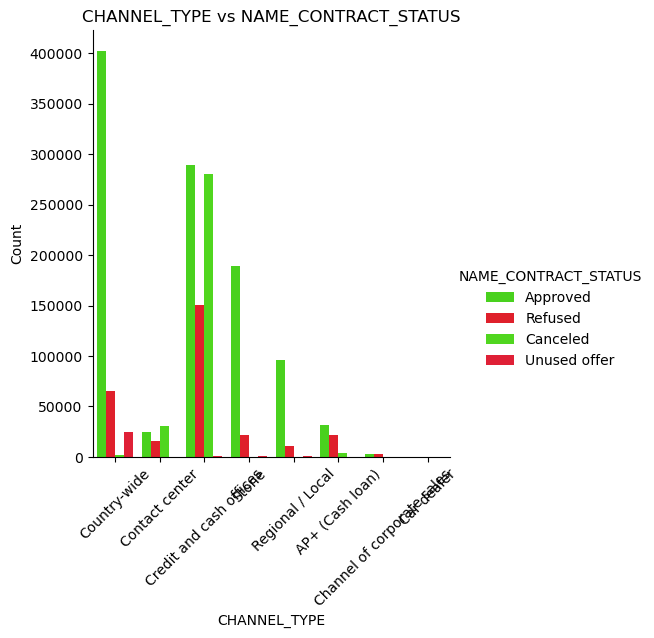

<Figure size 1200x400 with 0 Axes>

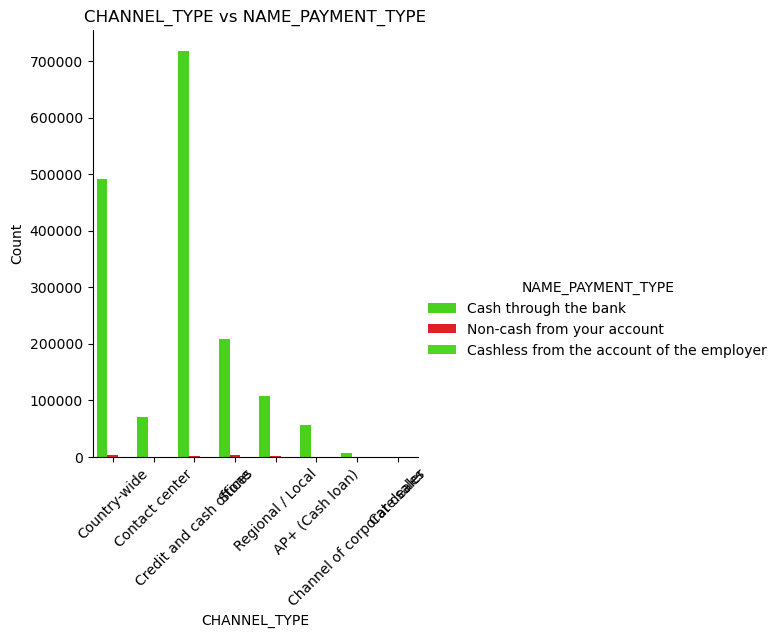

<Figure size 1200x400 with 0 Axes>

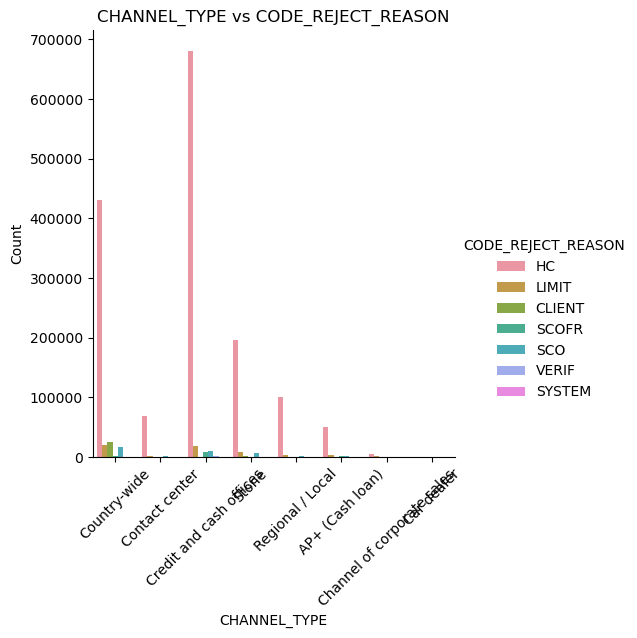

<Figure size 1200x400 with 0 Axes>

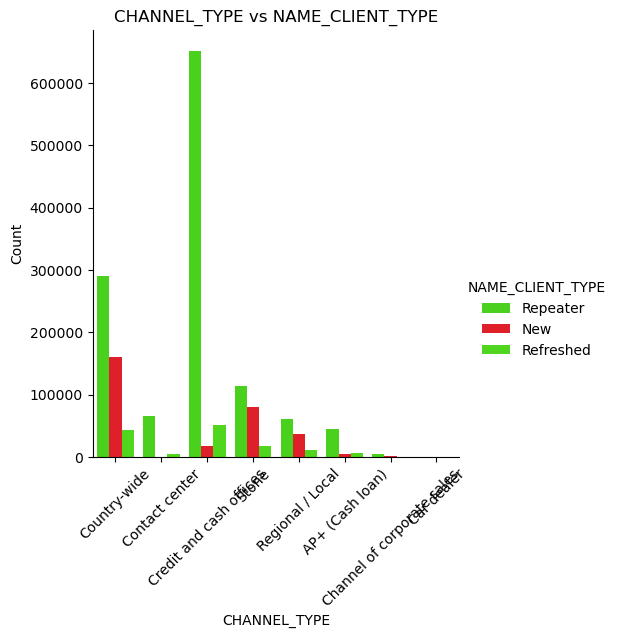

<Figure size 1200x400 with 0 Axes>

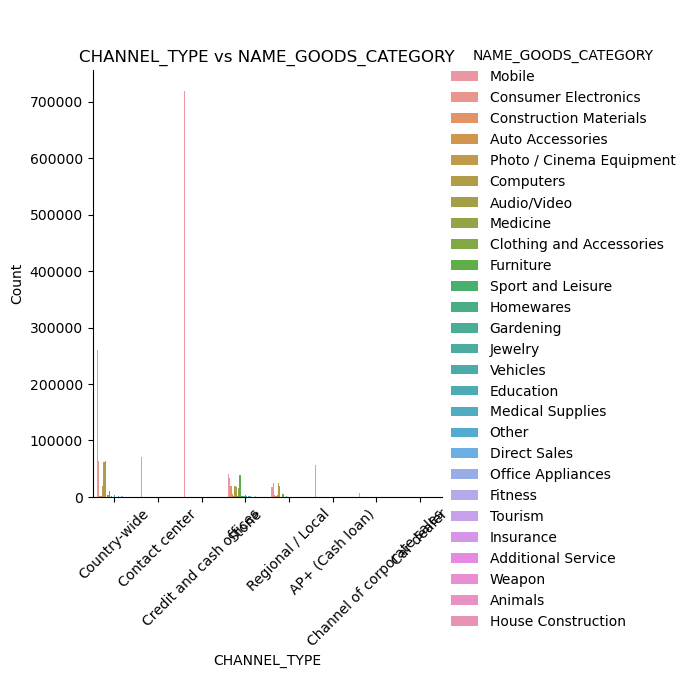

<Figure size 1200x400 with 0 Axes>

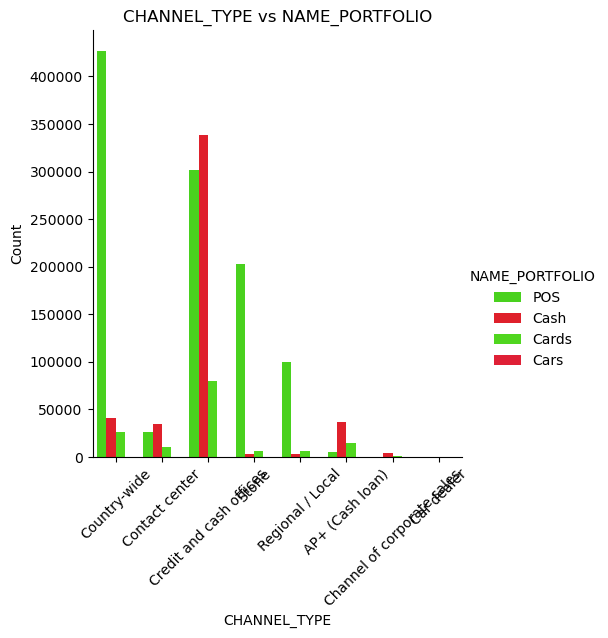

<Figure size 1200x400 with 0 Axes>

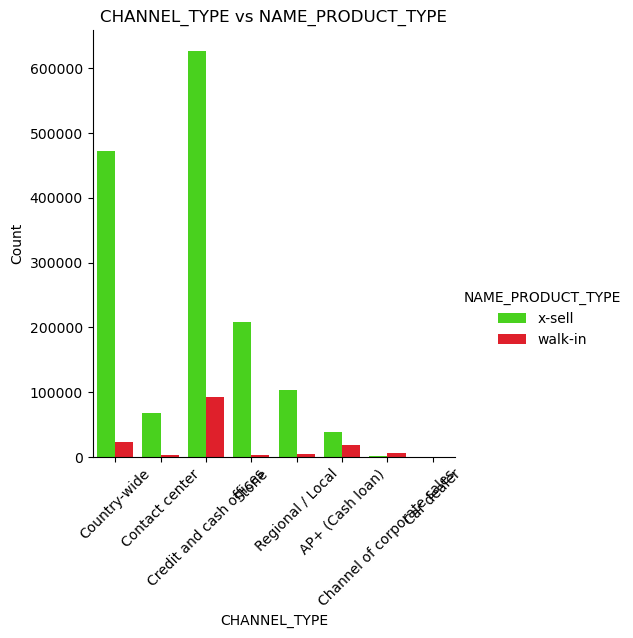

<Figure size 1200x400 with 0 Axes>

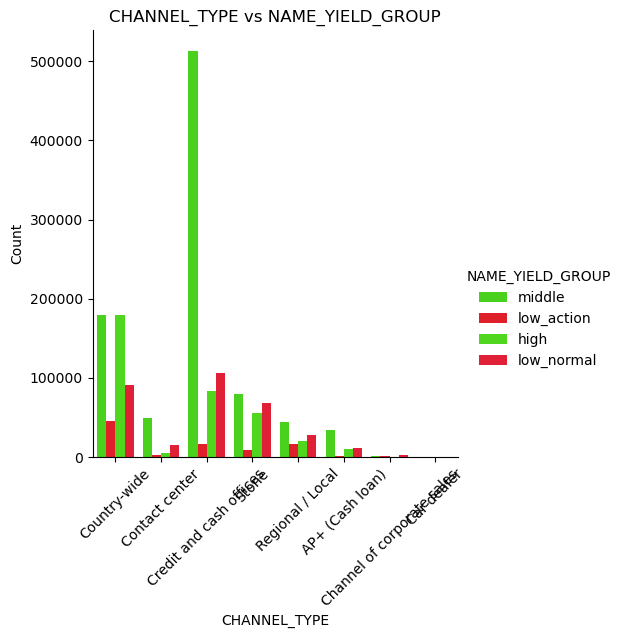

<Figure size 1200x400 with 0 Axes>

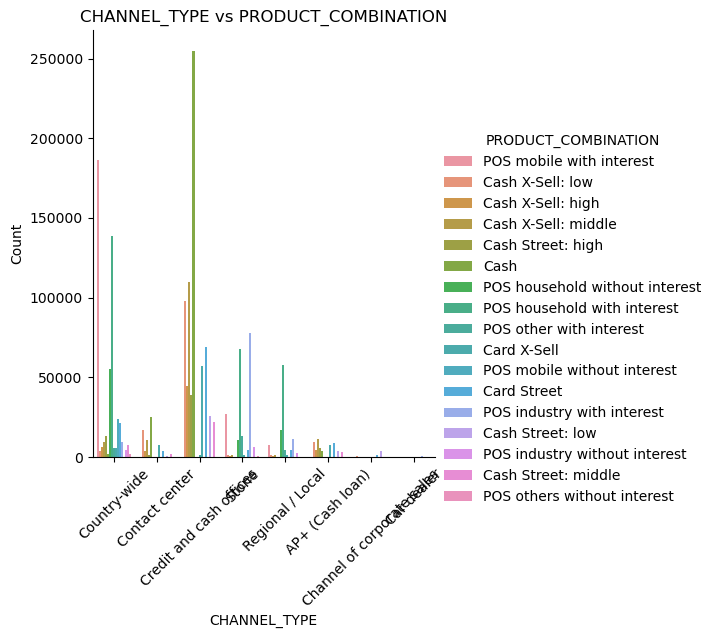

<Figure size 1200x400 with 0 Axes>

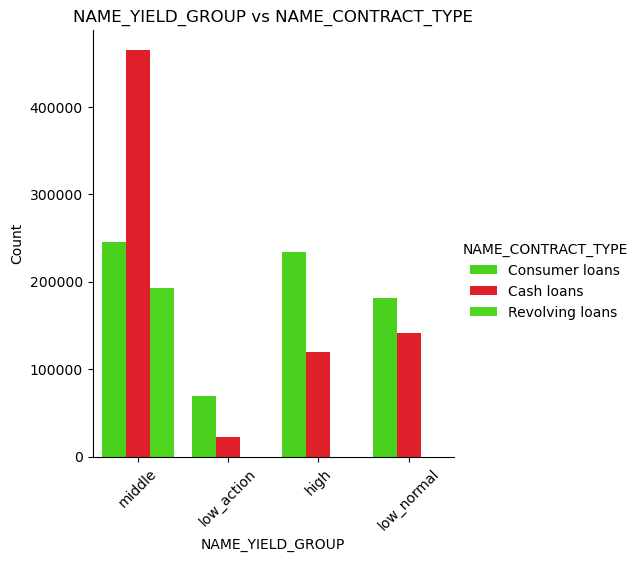

<Figure size 1200x400 with 0 Axes>

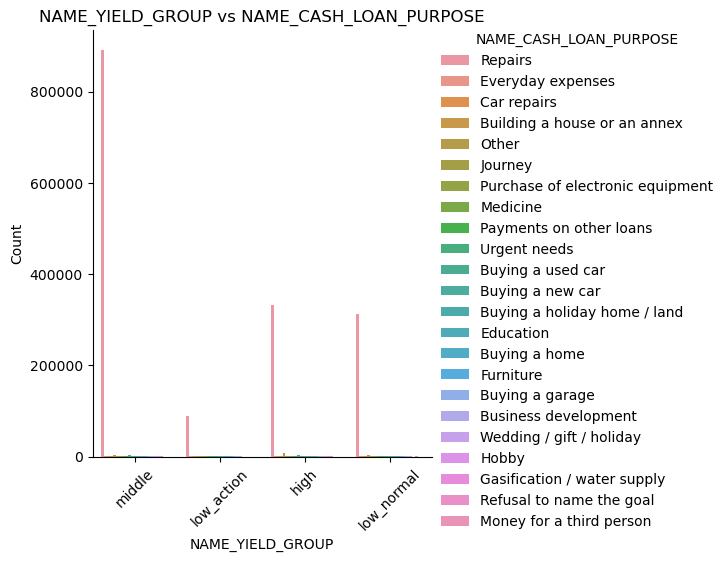

<Figure size 1200x400 with 0 Axes>

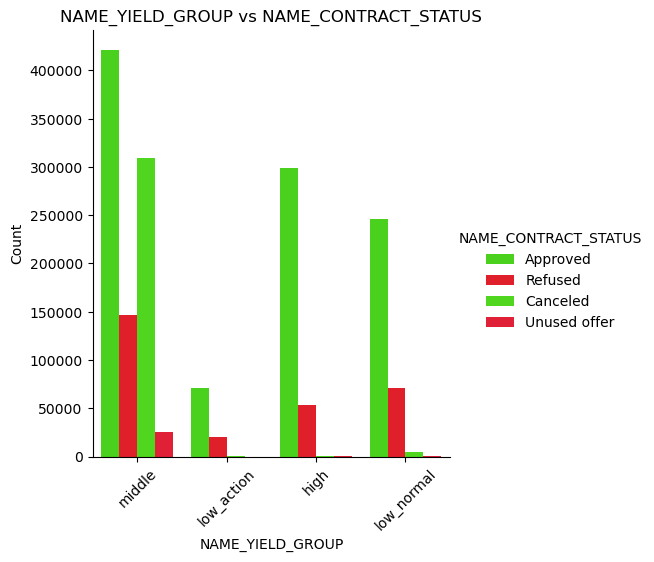

<Figure size 1200x400 with 0 Axes>

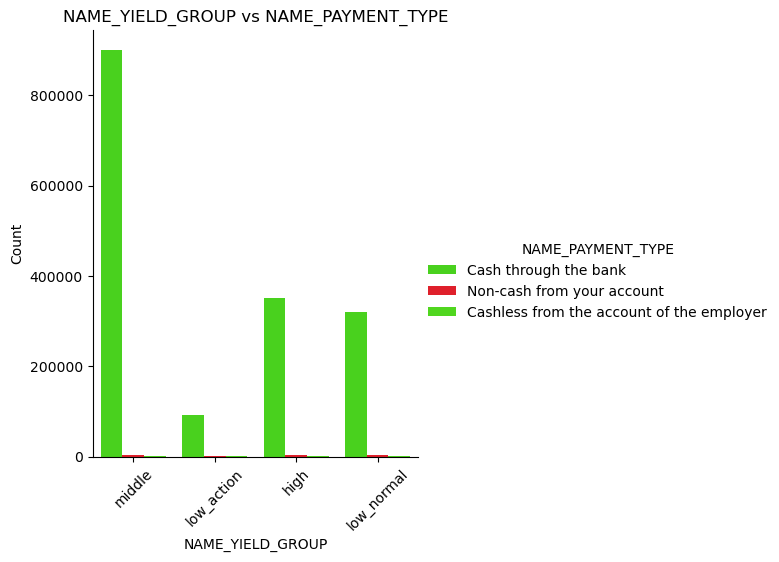

<Figure size 1200x400 with 0 Axes>

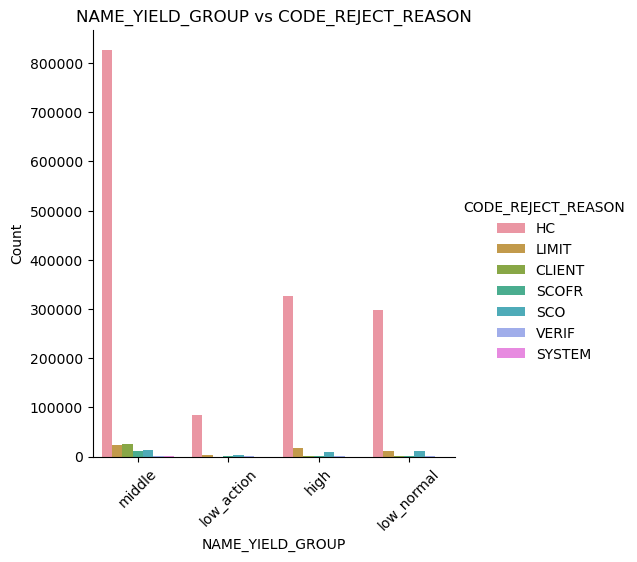

<Figure size 1200x400 with 0 Axes>

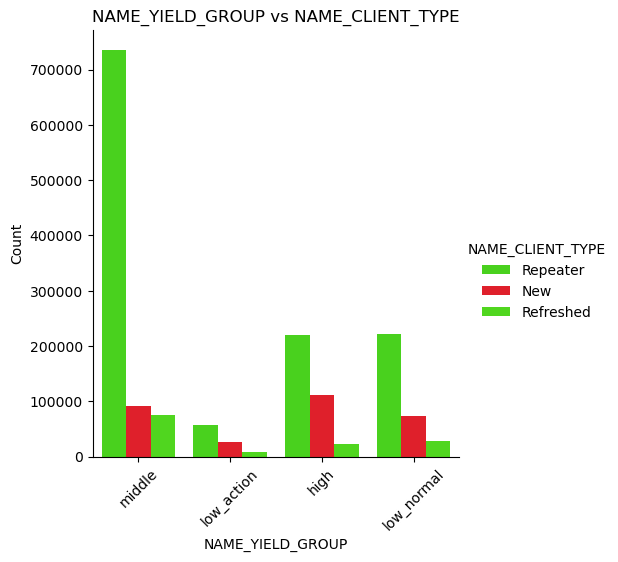

<Figure size 1200x400 with 0 Axes>

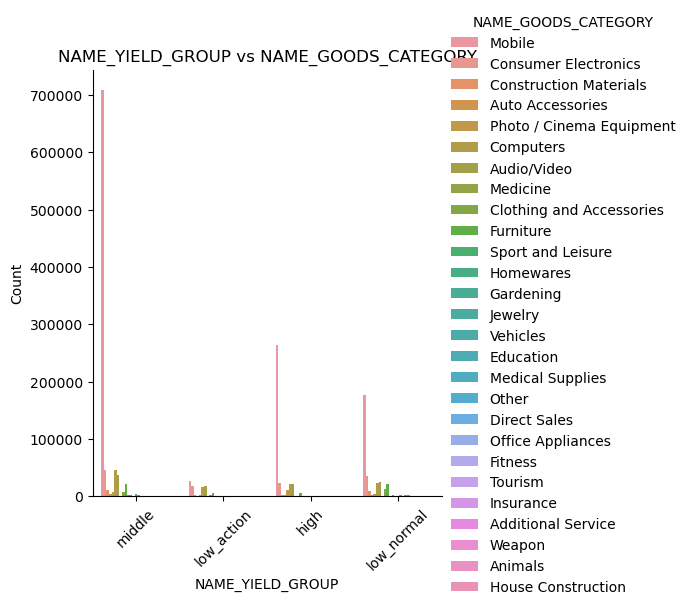

<Figure size 1200x400 with 0 Axes>

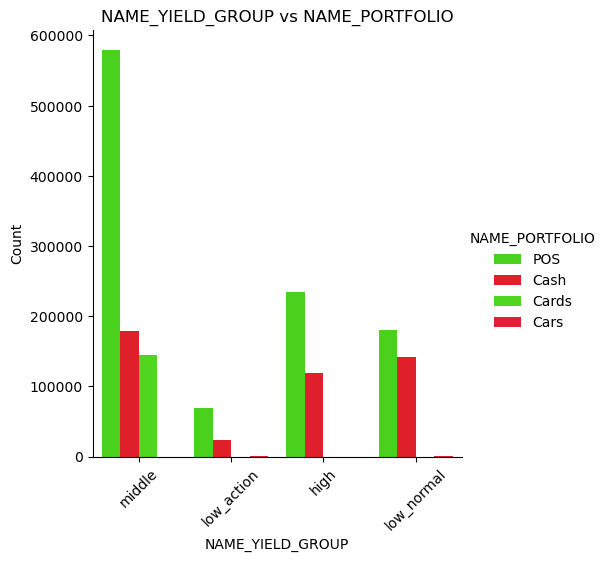

<Figure size 1200x400 with 0 Axes>

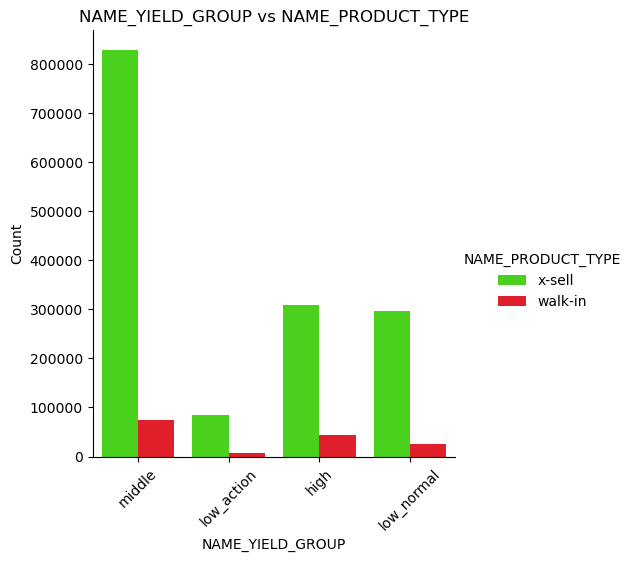

<Figure size 1200x400 with 0 Axes>

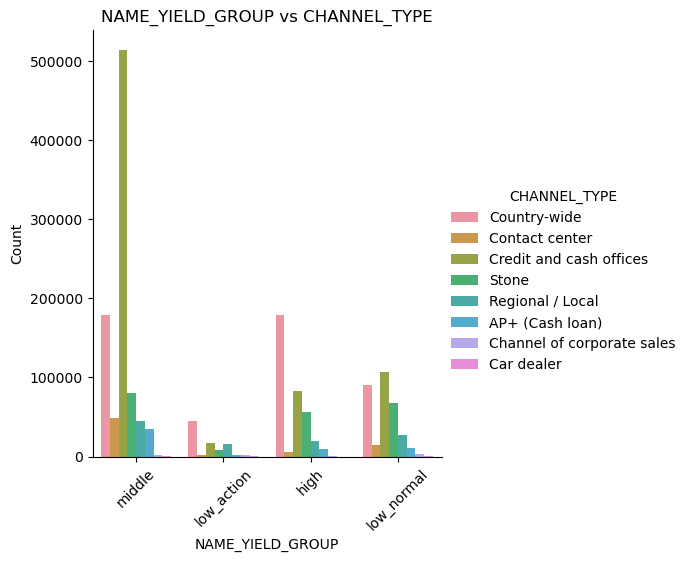

<Figure size 1200x400 with 0 Axes>

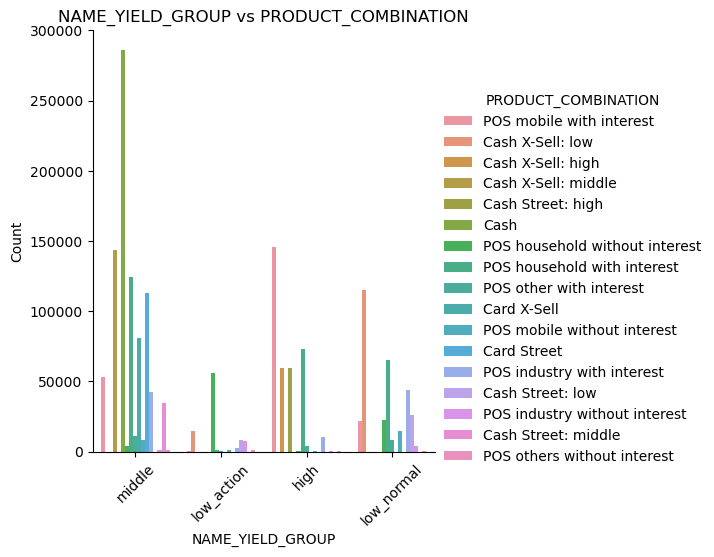

<Figure size 1200x400 with 0 Axes>

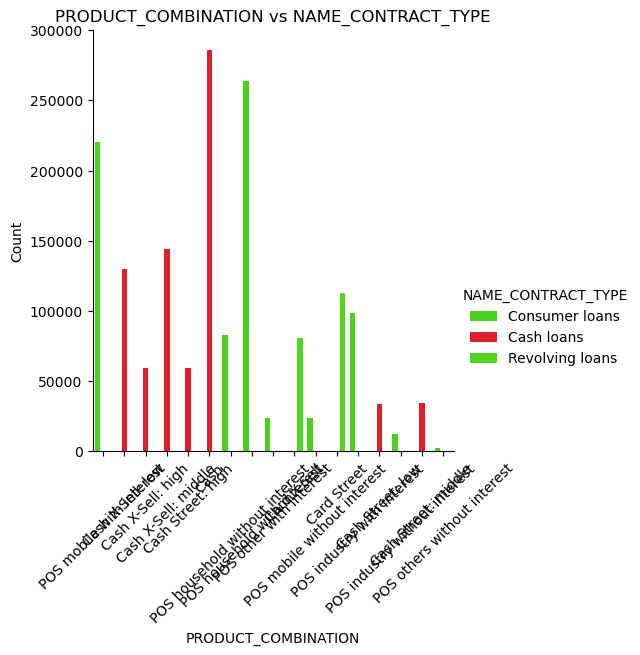

<Figure size 1200x400 with 0 Axes>

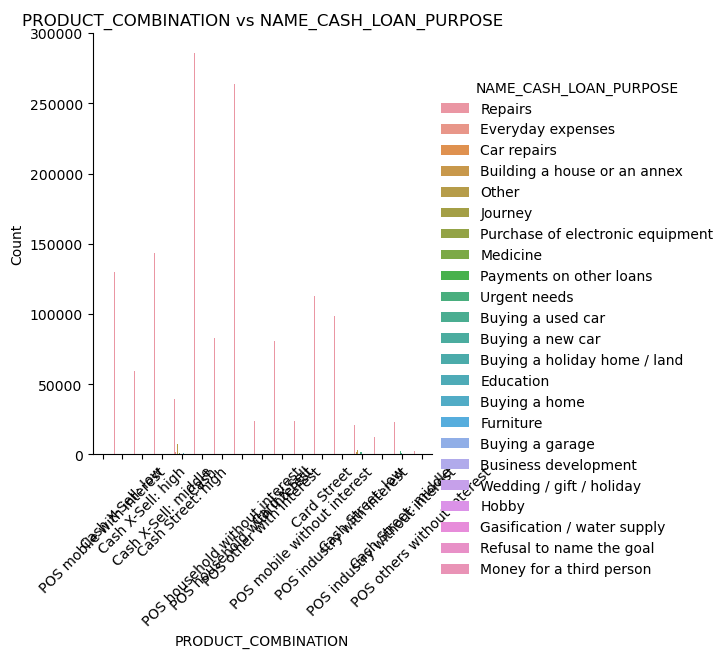

<Figure size 1200x400 with 0 Axes>

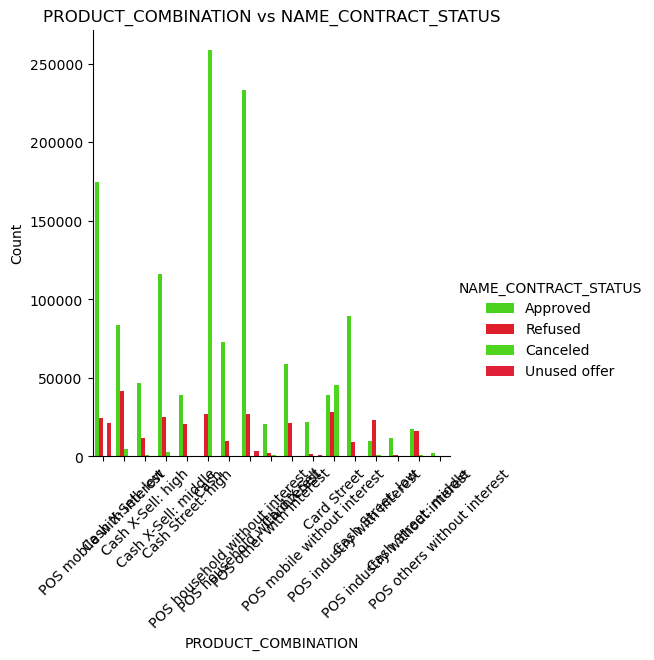

<Figure size 1200x400 with 0 Axes>

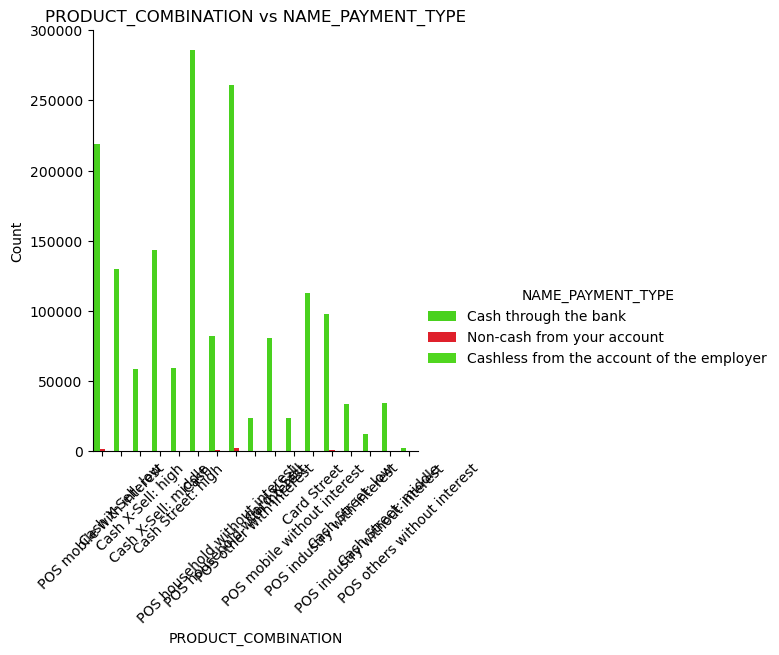

<Figure size 1200x400 with 0 Axes>

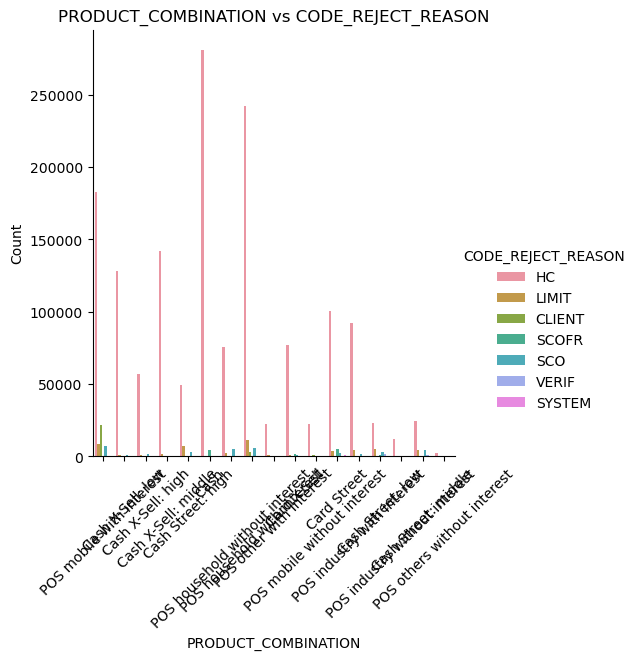

<Figure size 1200x400 with 0 Axes>

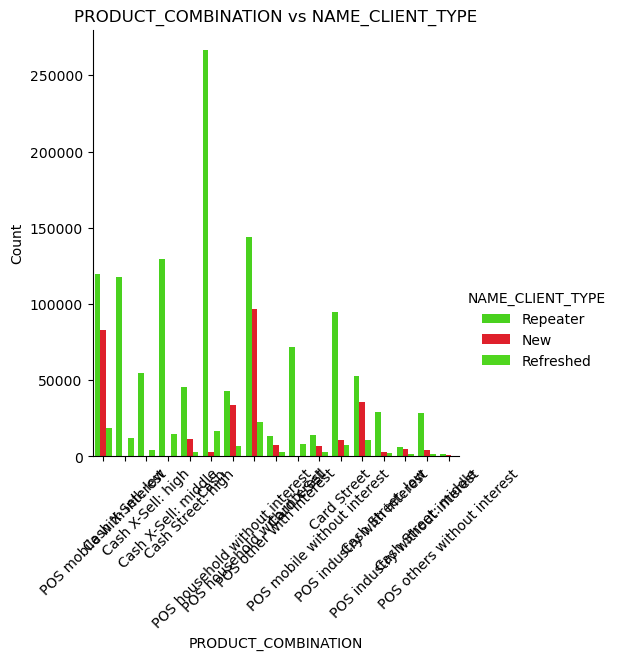

<Figure size 1200x400 with 0 Axes>

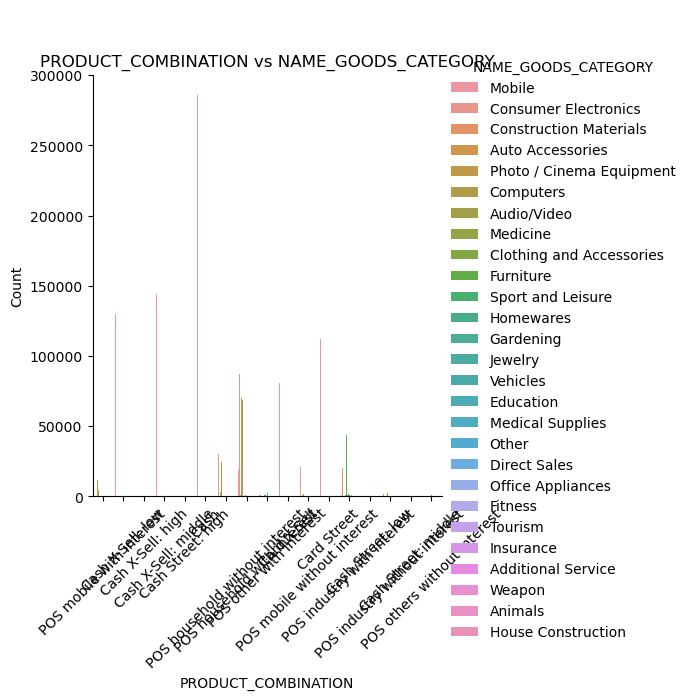

<Figure size 1200x400 with 0 Axes>

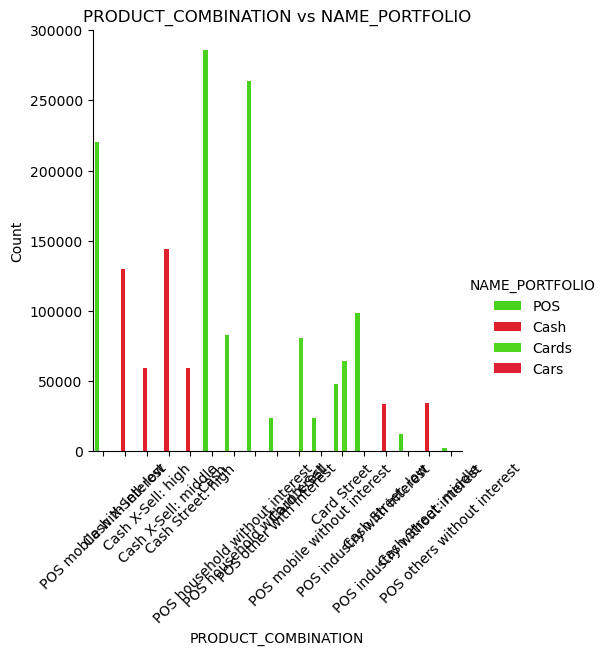

<Figure size 1200x400 with 0 Axes>

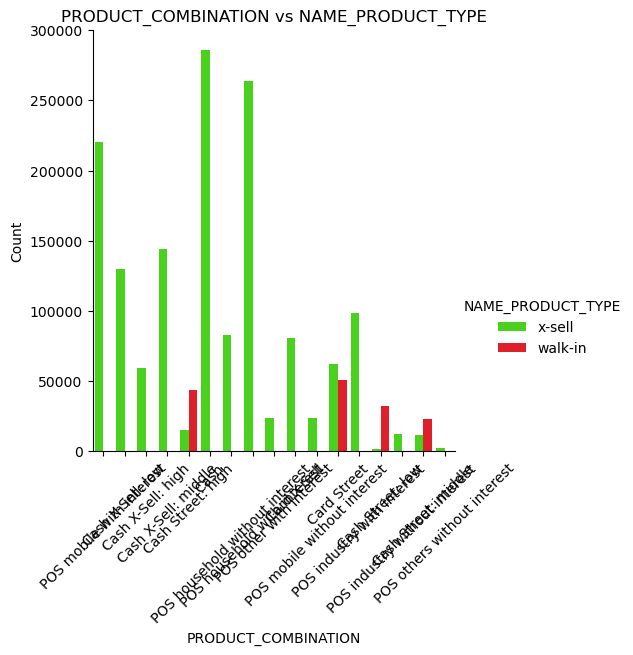

<Figure size 1200x400 with 0 Axes>

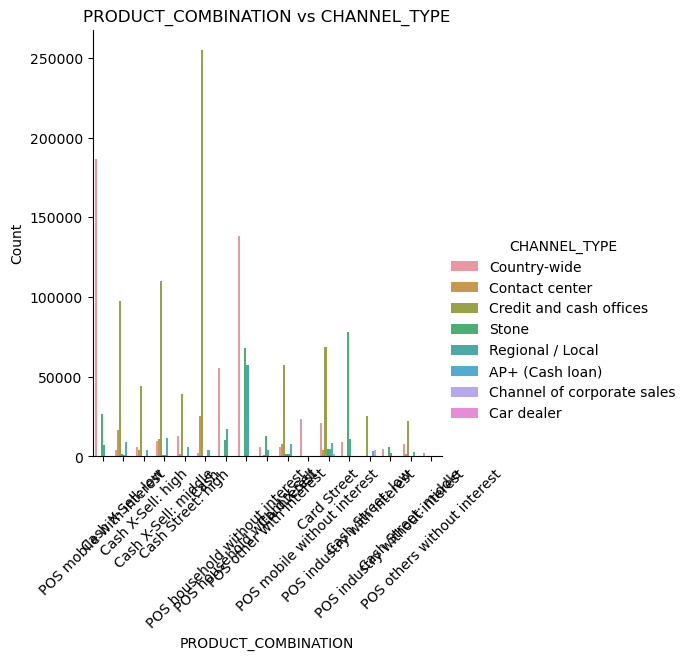

<Figure size 1200x400 with 0 Axes>

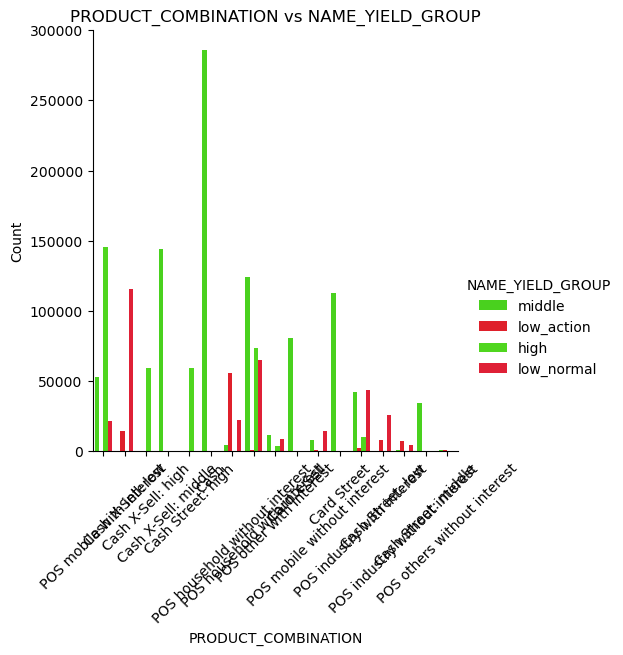

In [84]:
for obj_col1 in objects2:
    for obj_col2 in objects2:
        if obj_col1 != obj_col2:
            plt.figure(figsize=(12, 4))
            sns.catplot(x=obj_col1, hue=obj_col2, data=df2, kind='count')
            plt.title(f"{obj_col1} vs {obj_col2}")
            plt.xticks(rotation=45)
            plt.xlabel(obj_col1)
            plt.ylabel("Count")
            plt.show()

# Multivariate analysis

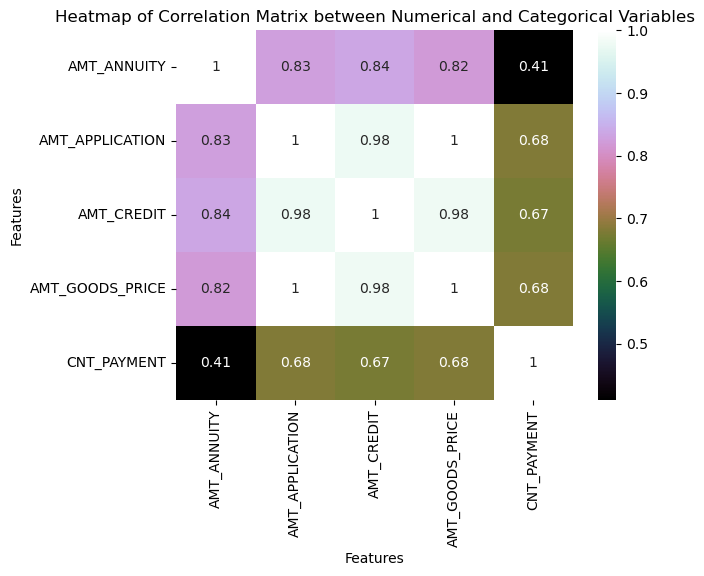

In [85]:
corr_matrix = df2[conts2 + objects2 + ranges2].corr()
sns.heatmap(corr_matrix, cmap="cubehelix", annot=True)
plt.title("Heatmap of Correlation Matrix between Numerical and Categorical Variables")
plt.xlabel("Features")
plt.ylabel("Features")
plt.show()

# Merging the data and plotting the nesessory graphs

In [86]:
merged = df1.merge(df2,on='SK_ID_CURR', how='inner')
merged.shape

(1404812, 88)

In [87]:
def fullplot(merge_data,column_name):
    colsd=['Refused', 'Approved', 'Canceled', 'Unused offer']
    fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(20,20))
    axs = axs.flatten()
    for i,j in enumerate(colsd):
        subset = merged[merged['NAME_CONTRACT_STATUS'] == j]
        sns.countplot(x=column_name, data=subset, ax=axs[i], palette=['#E69F00', '#56B4E9', '#009E73', '#F0E442', '#0072B2'])
        axs[i].set_title(j)
        axs[i].set_xlabel(column_name)
        axs[i].set_ylabel('Count')
        axs[i].tick_params(axis='x', labelrotation=90) 
    plt.suptitle(f'NAME_CONTRACT_STATUS vs {column_name}', fontsize=20, y=1.03)
    plt.tight_layout()
    plt.show()

In [88]:
analysis=['NAME_CONTRACT_TYPE_y', 'NAME_CLIENT_TYPE','CODE_GENDER', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'OCCUPATION_TYPE', 'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO', 'NAME_GOODS_CATEGORY', 'PRODUCT_COMBINATION','NAME_PAYMENT_TYPE','CHANNEL_TYPE','NAME_YIELD_GROUP','NAME_HOUSING_TYPE']

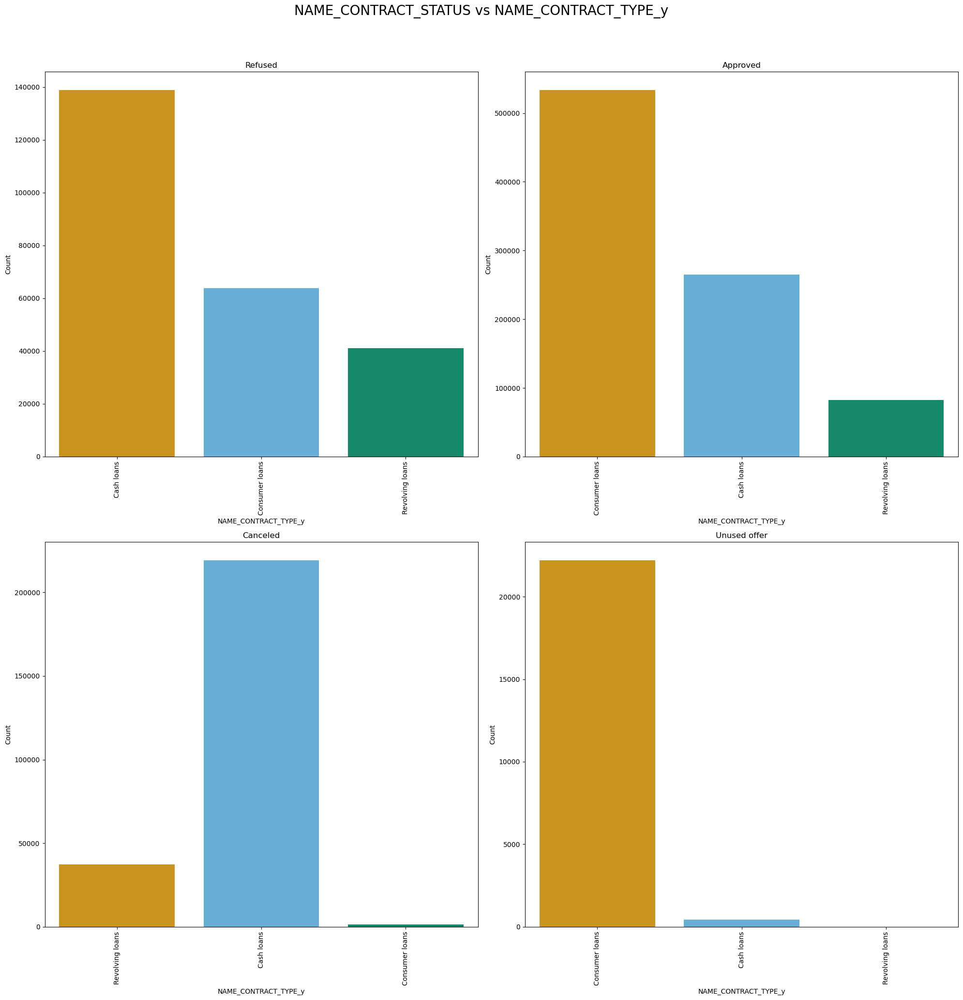

************************************************************************************************************************


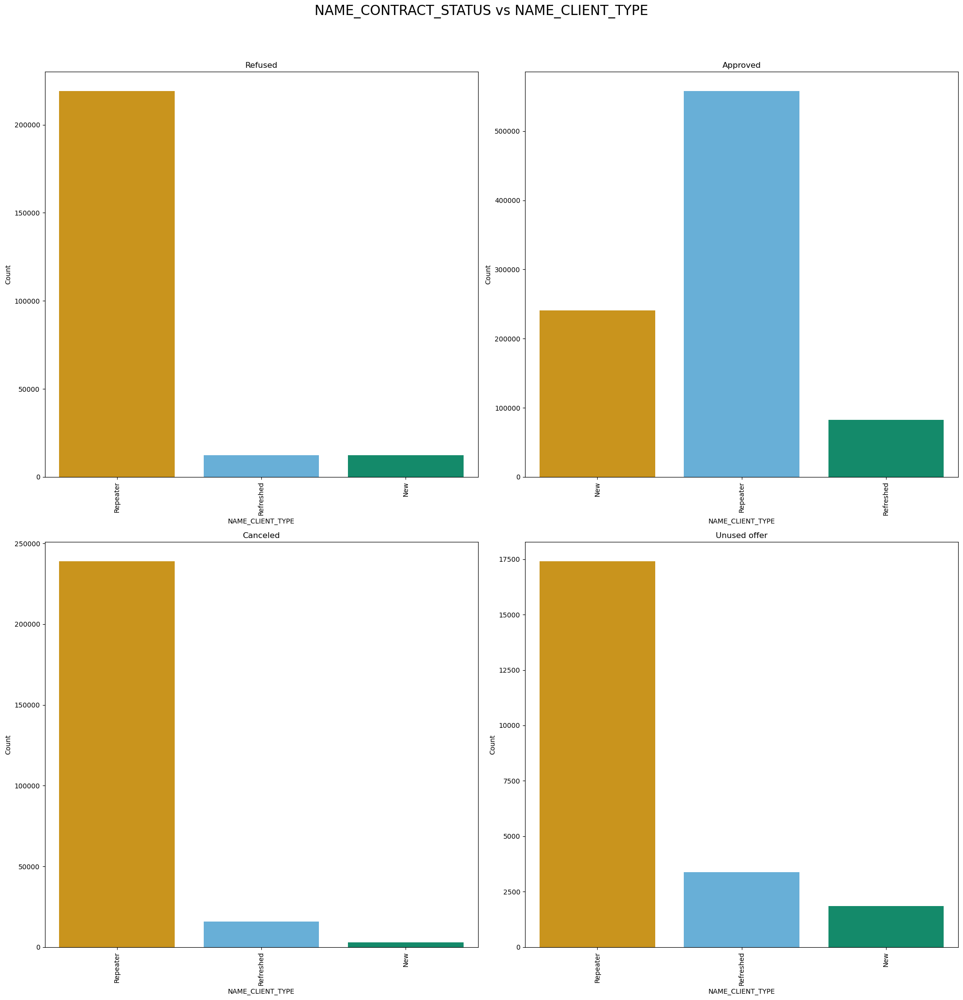

************************************************************************************************************************


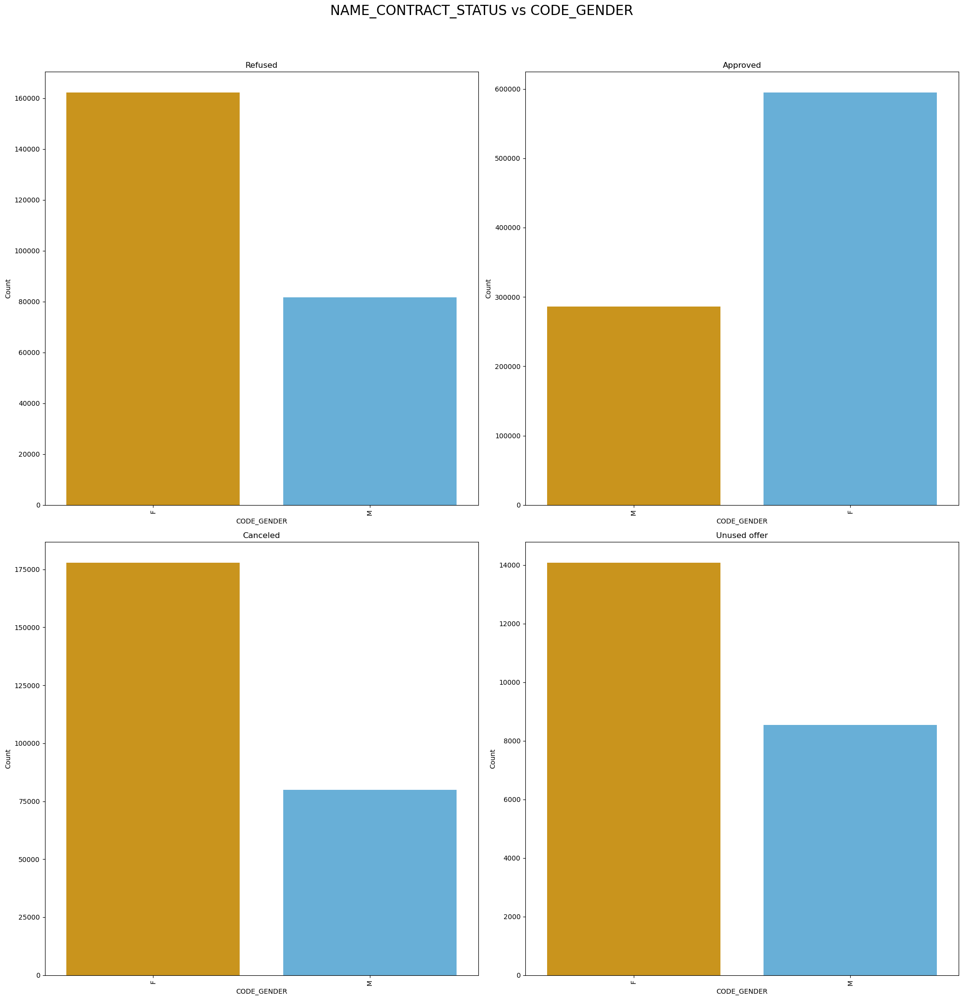

************************************************************************************************************************


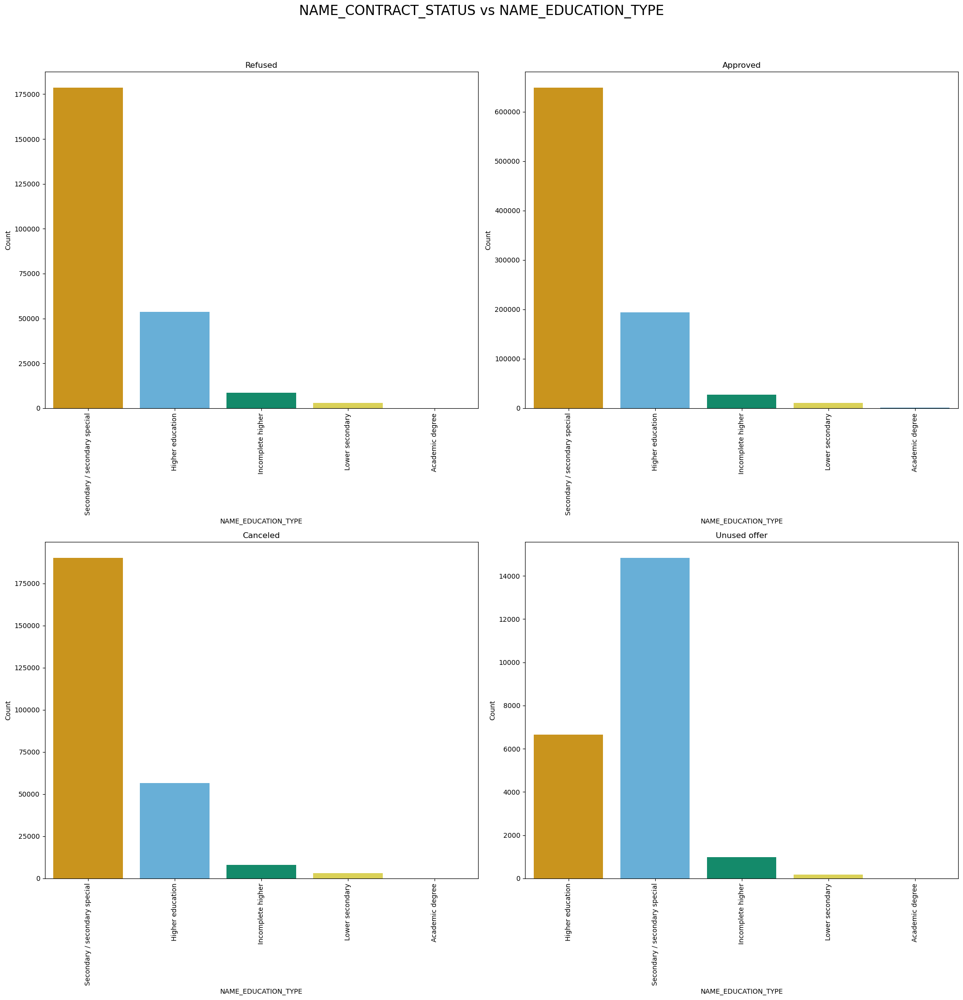

************************************************************************************************************************


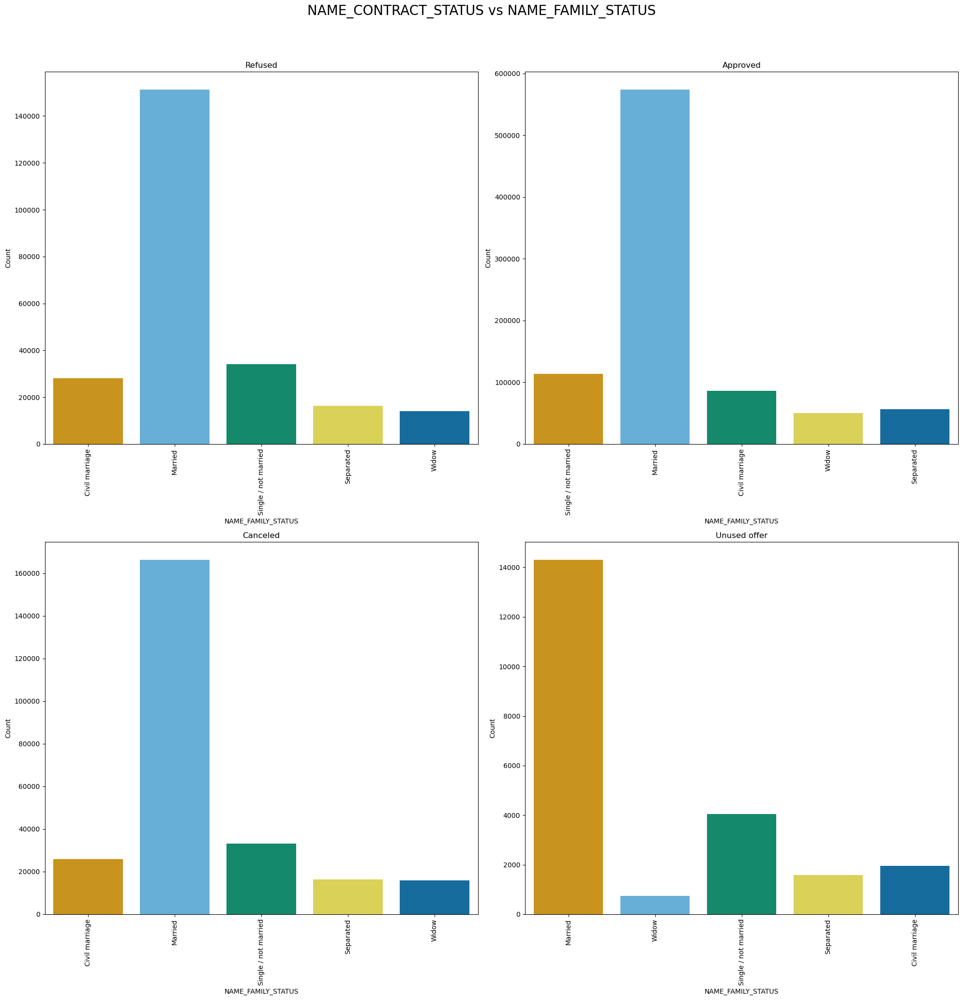

************************************************************************************************************************


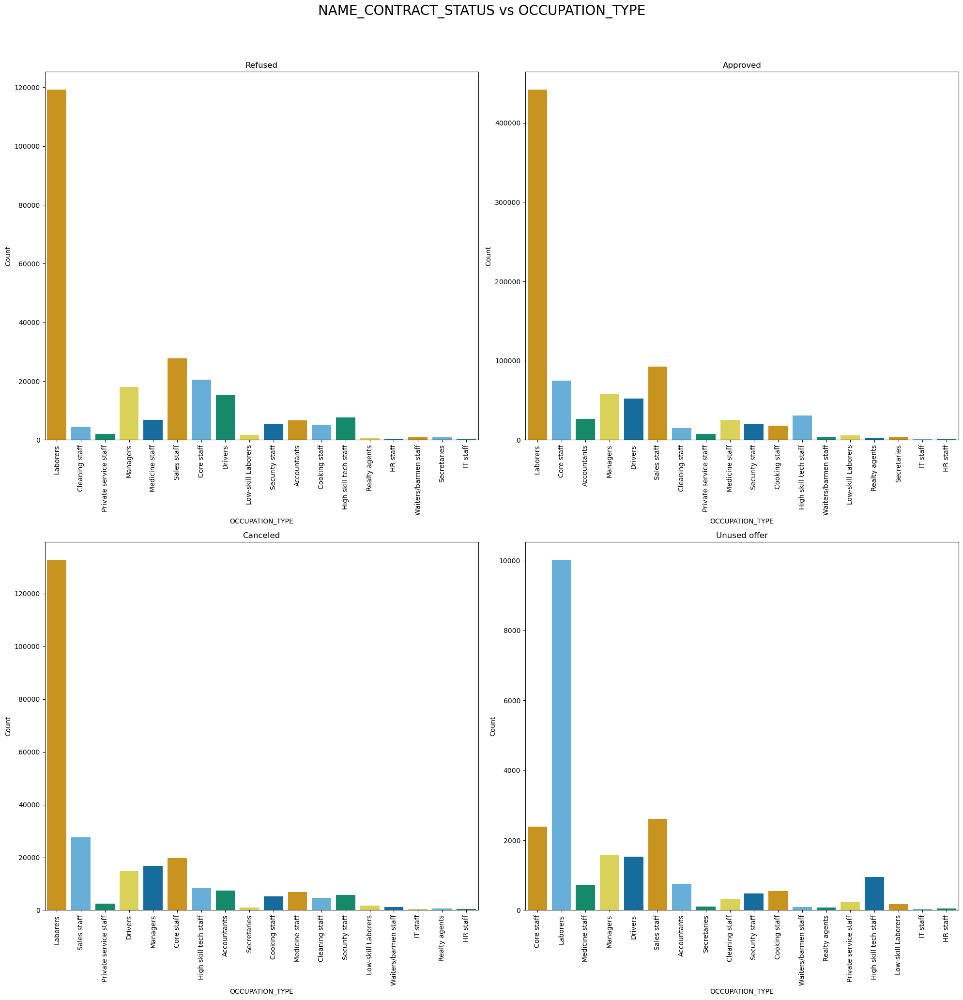

************************************************************************************************************************


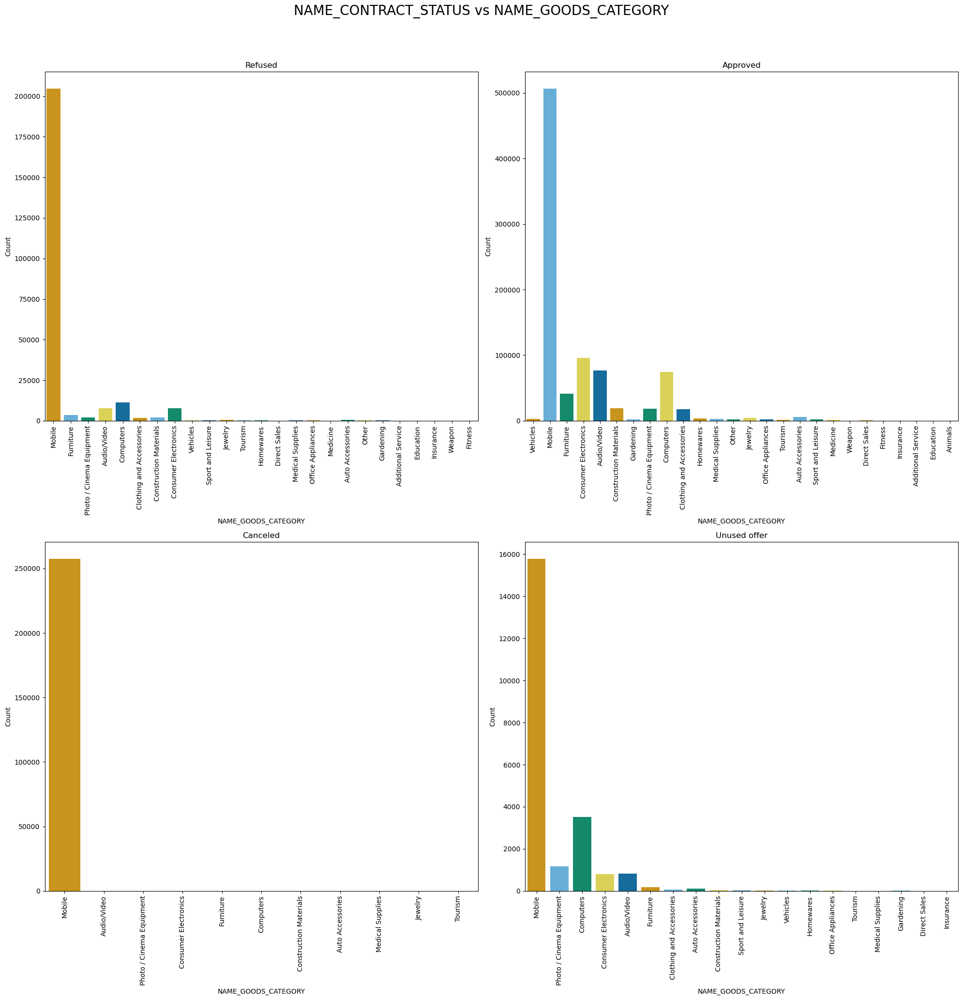

************************************************************************************************************************


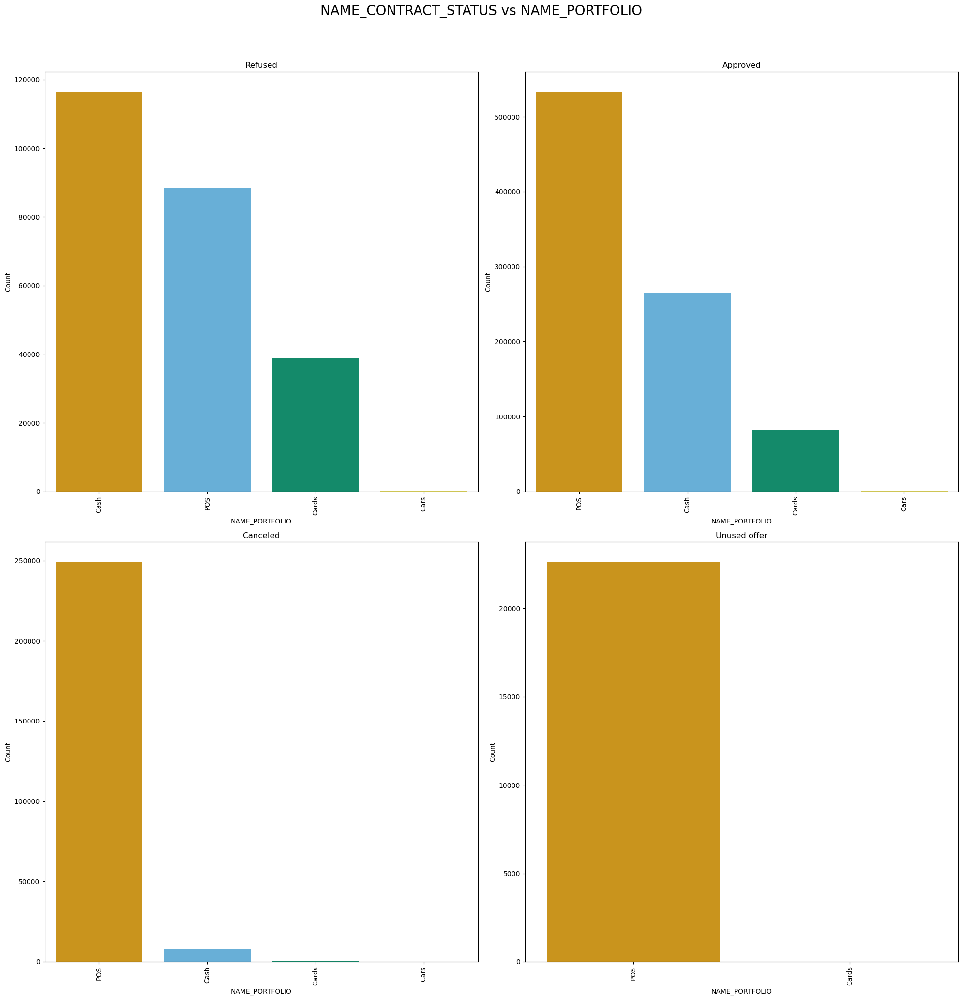

************************************************************************************************************************


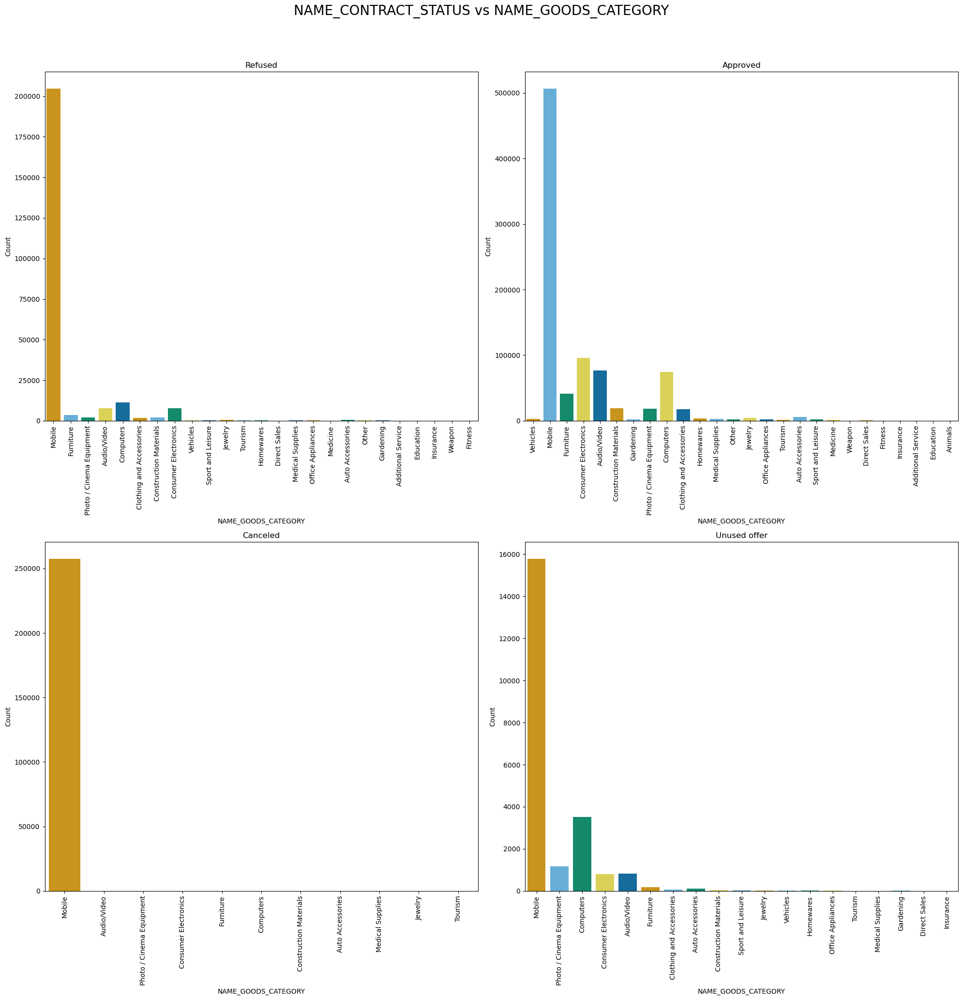

************************************************************************************************************************


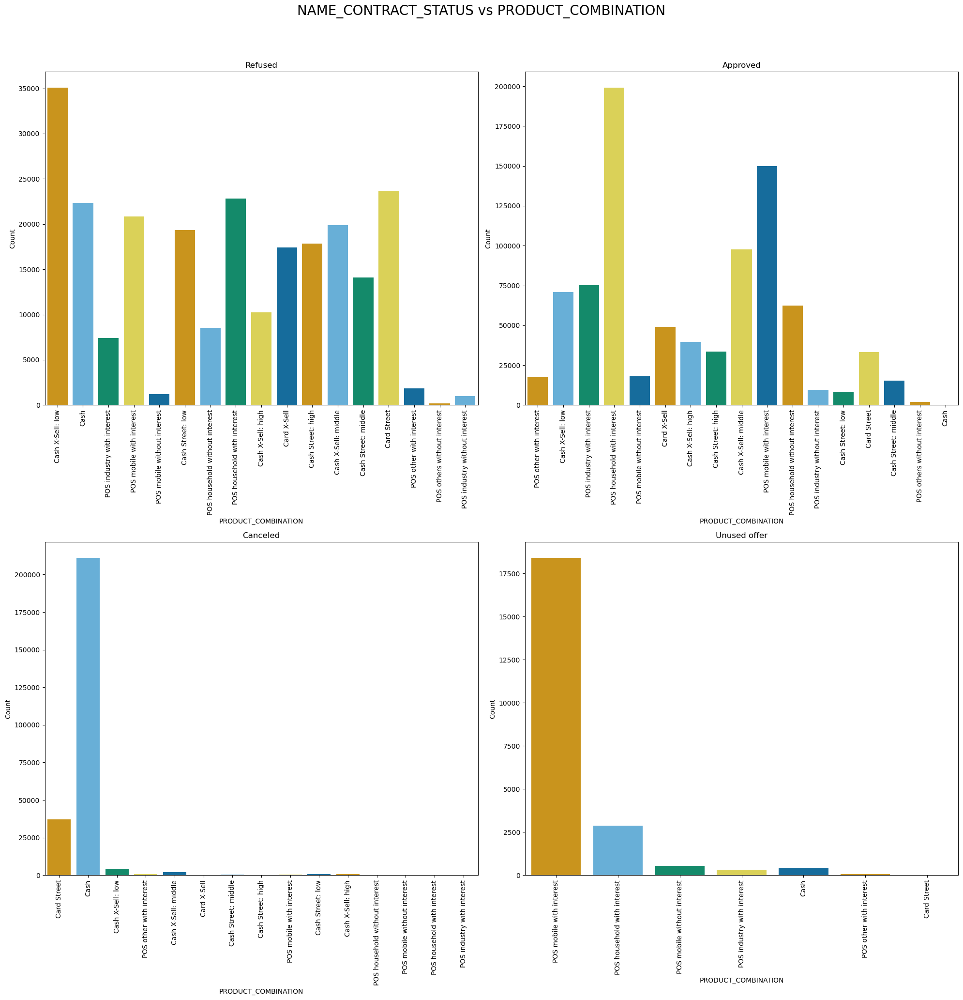

************************************************************************************************************************


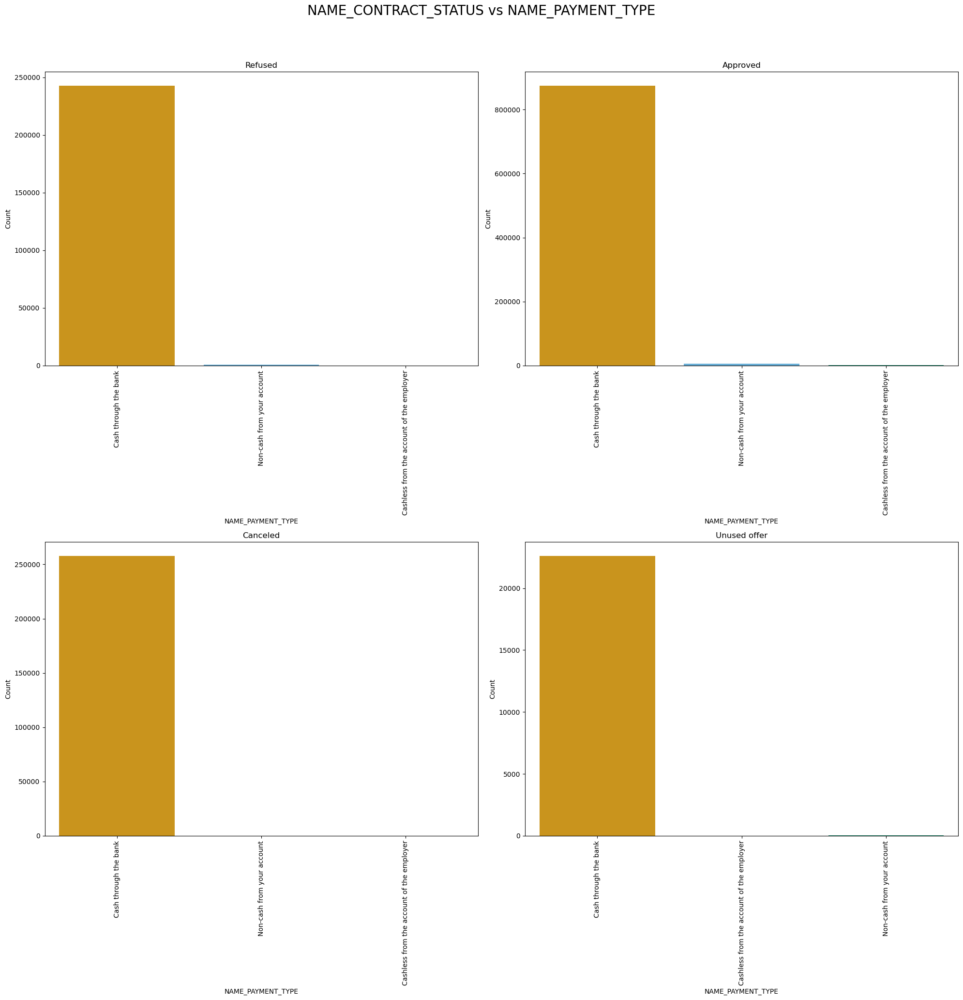

************************************************************************************************************************


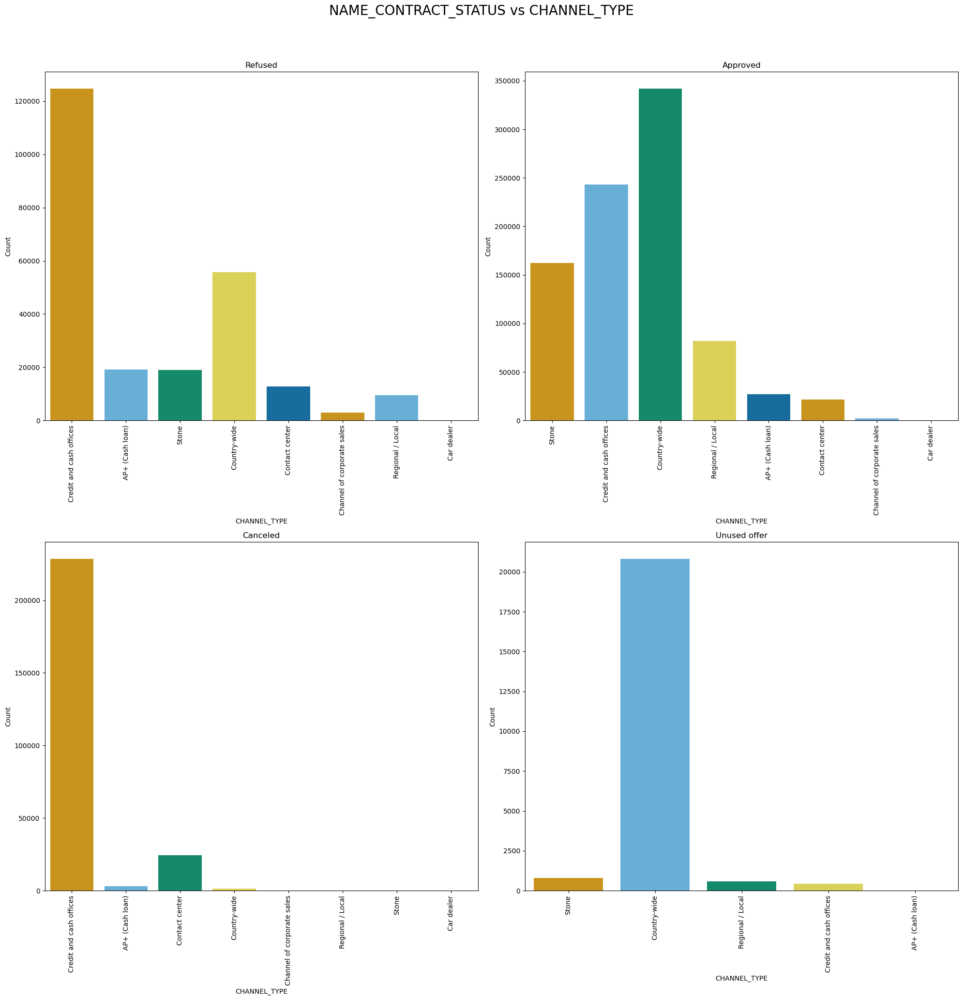

************************************************************************************************************************


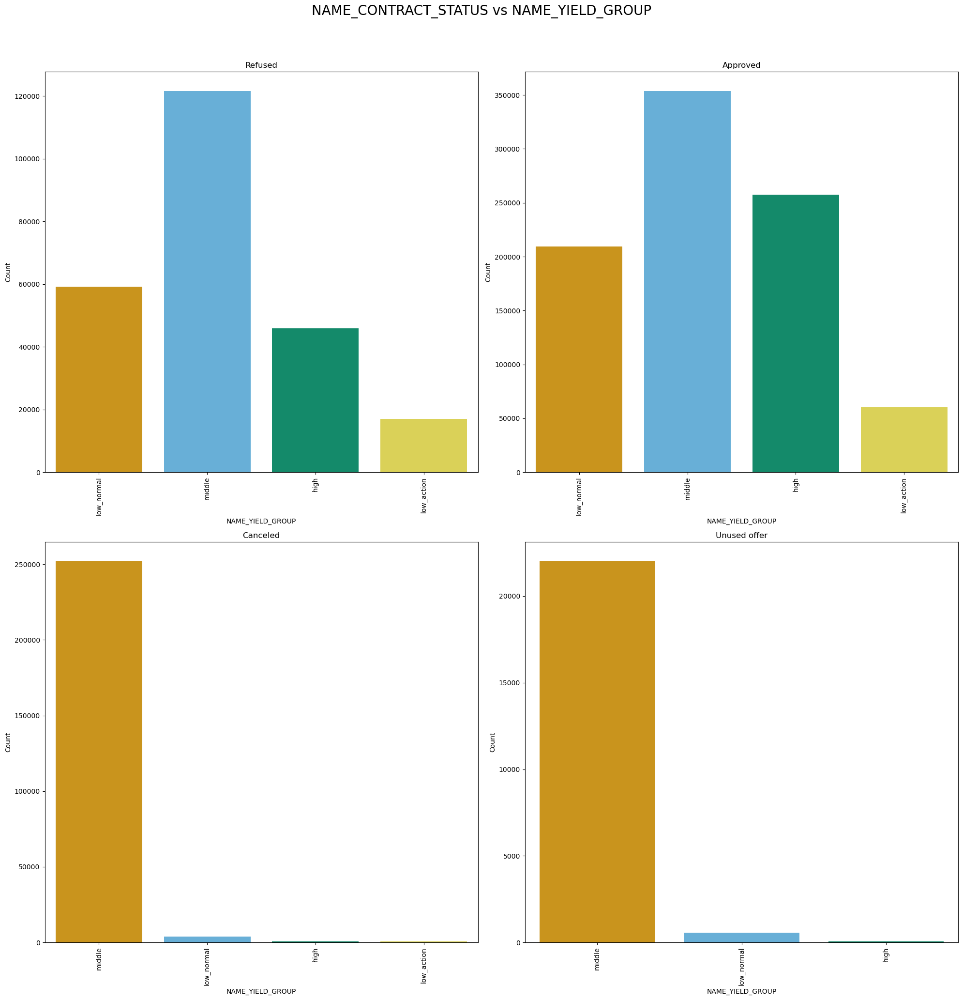

************************************************************************************************************************


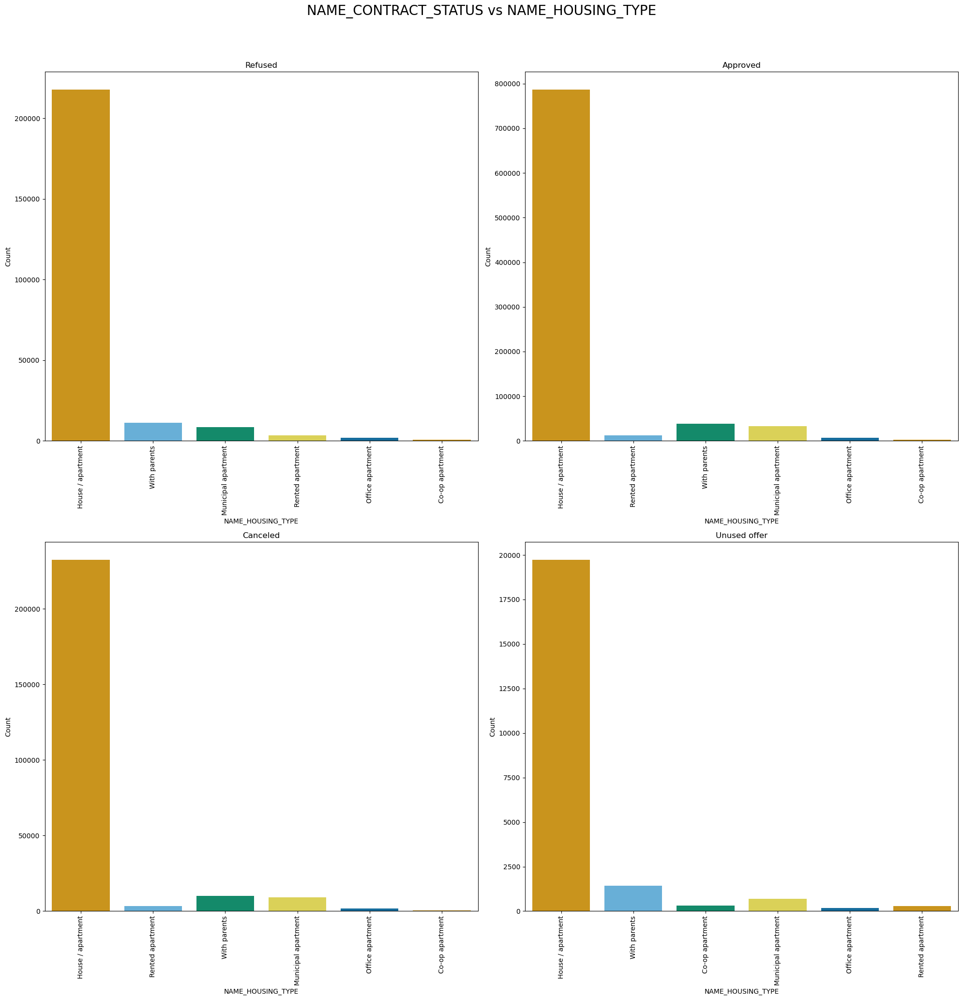

************************************************************************************************************************


In [89]:
for i in analysis:
    fullplot(merged,i)
    print('*'*120)

# Summary

Certainly! Based on the analysis, here are the main insights:

- Banks mostly approve Consumer Loans.
- Most of the Refused and Cancelled loans are cash loans.
- Most of the approved, refused, and canceled loans belong to old clients, with only 27.4% of loans provided to new customers.
- The percentage of loans approved for females is higher than the percentage refused.
- Most of the approved loans belong to applicants with Secondary/Secondary Special education type.
- The percentage of loans approved for married applicants is higher than for other contract status categories (refused, canceled, etc.).
- Most of the loans that were previously approved belong to the POS name portfolio.
- Credit and cash offices channel type has the highest number of refused and canceled loans.
- Most of the approved loans have a medium grouped interest rate.
- Most of the approved loans belong to Very Low and High Credit range.
- Most of the loans are approved for applicants with a low income range.
- Across all contract statuses (Approved, Refused, Canceled, Unused Offer), people with the Working income type are leading.

It is important to note that these insights are based on the data available and may not necessarily apply in all situations. It is also recommended to conduct further analysis and modeling to gain deeper insights and inform decision-making.